(12.0, -1, False)


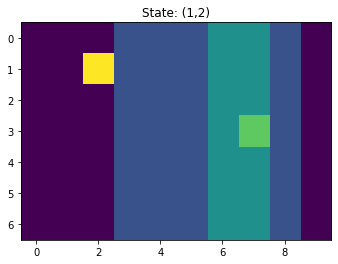

In [2]:
from windyenv import WindyGridWorld

from time import sleep
import numpy as np
from IPython.display import clear_output

%matplotlib inline
env = WindyGridWorld()

for i in range(50):
    a = np.random.choice([0,1,2,3])
    print(env.step(a))
    env.render()
    sleep(0.2)
    clear_output(wait=True)

<img src="images/n-step_SARSA.PNG" width=700>

In [1]:
from windyenv import WindyGridWorld
from time import sleep
import numpy as np
from IPython.display import clear_output
import gym

%matplotlib inline
env = gym.make("Taxi-v3") # WindyGridWorld()

In [ ]:
Q = np.zeros(shape=(env.observation_space.n, env.action_space.n))
π = lambda state, ε: np.random.choice(np.arange(env.action_space.n)) if np.random.rand() < ε else np.argmax(Q[int(state),:])
α, ε, n, γ = 0.1, 0.9, 4, 0.99
EPISODES = 150
S, A, R = [None] * n, [None] * n, [None] * n # S0, A0, R1, S1, A1, R2, ..., S_T
for episode in range(EPISODES):
    t = 0
    # env.reset()
    #S.append(None), A.append(None), R.append(None)
    S[t % n] = env.reset() # env.state
    A[t % n] = π(S[t], ε)
    T = np.infty
    while True:
        if t < T:
            new_state, reward, done, _ = env.step(A[t%n]) # Take Action A_t
            t += 1
            print("t =", t)
            #R.append(None), S.append(None)
            R[t % n] = reward
            S[t % n] = new_state
            if done:
                T = t + 1
            else:
                #A.append(None)
                A[t%n] = π(S[t%n], ε)
        τ = t - n + 1
        print(S, A, R)
        if τ >= 0:
            G = sum([(γ**(i-τ-1)) * R[i%n] for i in range(τ+1, min(τ+n, T))])
            print(G)
            print("τ + n =", τ + n)
            if τ + n < T:
                G = G + (γ**n) * Q[S[(τ + n)%n], A[(τ + n)%n]]
            Q[S[τ%n], A[τ%n
                       
                       
                       
                       
                       ]] += α * (G - Q[S[τ%n], A[τ%n]])
        if τ == T - 1:
            break

t = 1
[406, 406, None, None] [0, 0, None, None] [None, -1, None, None]
t = 2
[406, 406, 406, None] [0, 0, 2, None] [None, -1, -1, None]
t = 3
[406, 406, 406, 406] [0, 0, 2, 5] [None, -1, -1, -1]
-2.9701
τ + n = 4
t = 4
[406, 406, 406, 406] [4, 0, 2, 5] [-10, -1, -1, -1]
-11.791
τ + n = 5
t = 5
[406, 406, 406, 406] [4, 5, 2, 5] [-10, -10, -1, -1]
-20.701
τ + n = 6
t = 6
[406, 406, 406, 406] [4, 5, 1, 5] [-10, -10, -10, -1]
-29.701
τ + n = 7
t = 7
[406, 406, 406, 306] [4, 5, 1, 0] [-10, -10, -10, -1]
-20.8801
τ + n = 8
t = 8
[406, 406, 406, 306] [0, 5, 1, 0] [-1, -10, -10, -1]
-11.9701
τ + n = 9
t = 9
[406, 406, 406, 306] [0, 1, 1, 0] [-1, -1, -10, -1]
-2.9701
τ + n = 10
t = 10
[406, 406, 306, 306] [0, 1, 1, 0] [-1, -1, -1, -1]
-2.9701
τ + n = 11
t = 11
[406, 406, 306, 206] [0, 1, 1, 5] [-1, -1, -1, -1]
-2.9701
τ + n = 12
t = 12
[206, 406, 306, 206] [1, 1, 1, 5] [-10, -1, -1, -1]
-11.791
τ + n = 13
t = 13
[206, 106, 306, 206] [1, 3, 1, 5] [-10, -1, -1, -1]
-11.8801
τ + n = 14
t = 14
[206

τ + n = 215
t = 215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 216
t = 216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217
t = 217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218
t = 218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219
t = 219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220
t = 220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221
t = 221
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 222
t = 222
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223
t = 223
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 224
t = 224
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 225
t = 225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226
t = 226
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 227
t = 227
[498, 498, 498

-2.9701
τ + n = 503
t = 503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 504
t = 504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 505
t = 505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 506
t = 506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 507
t = 507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 508
t = 508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 509
t = 509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 510
t = 510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 511
t = 511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 512
t = 512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 513
t = 513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 514
t = 514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 515
t = 515
[498, 

t = 813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 814
t = 814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 815
t = 815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 816
t = 816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 817
t = 817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 818
t = 818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 819
t = 819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 820
t = 820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 821
t = 821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 822
t = 822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 823
t = 823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 824
t = 824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 825
t = 825
[498, 498, 498, 498] [2, 0

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 1211
t = 1211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 1212
t = 1212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 1213
t = 1213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 1214
t = 1214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 1215
t = 1215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 1216
t = 1216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 1217
t = 1217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 1218
t = 1218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 1219
t = 1219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 1220
t = 1220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 1221
t = 1221
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 1222
t = 1222
[498, 498,

t = 1511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 1512
t = 1512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 1513
t = 1513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 1514
t = 1514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 1515
t = 1515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 1516
t = 1516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 1517
t = 1517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 1518
t = 1518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 1519
t = 1519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 1520
t = 1520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 1521
t = 1521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 1522
t = 1522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 1523
t = 1523
[

-11.791
τ + n = 1868
t = 1868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 1869
t = 1869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 1870
t = 1870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 1871
t = 1871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 1872
t = 1872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 1873
t = 1873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 1874
t = 1874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 1875
t = 1875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 1876
t = 1876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 1877
t = 1877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 1878
t = 1878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 1879
t = 1879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ 

t = 2210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2211
t = 2211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2212
t = 2212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2213
t = 2213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2214
t = 2214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2215
t = 2215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2216
t = 2216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2217
t = 2217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2218
t = 2218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2219
t = 2219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2220
t = 2220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2221
t = 2221
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2222
t = 2222
[

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2443
t = 2443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2444
t = 2444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2445
t = 2445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2446
t = 2446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2447
t = 2447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2448
t = 2448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2449
t = 2449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2450
t = 2450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2451
t = 2451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2452
t = 2452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2453
t = 2453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2454
t = 2454
[498, 498,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2698
t = 2698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2699
t = 2699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2700
t = 2700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2701
t = 2701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2702
t = 2702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2703
t = 2703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2704
t = 2704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2705
t = 2705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2706
t = 2706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2707
t = 2707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2708
t = 2708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2709
t = 2709
[498, 498,

t = 2946
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2947
t = 2947
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2948
t = 2948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2949
t = 2949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2950
t = 2950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2951
t = 2951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2952
t = 2952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2953
t = 2953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2954
t = 2954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 2955
t = 2955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 2956
t = 2956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 2957
t = 2957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 2958
t = 2958
[

τ + n = 3230
t = 3230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3231
t = 3231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3232
t = 3232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3233
t = 3233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3234
t = 3234
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3235
t = 3235
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3236
t = 3236
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3237
t = 3237
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3238
t = 3238
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3239
t = 3239
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3240
t = 3240
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3241
t = 3241
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 32

τ + n = 3348
t = 3348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3349
t = 3349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3350
t = 3350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3351
t = 3351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3352
t = 3352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3353
t = 3353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3354
t = 3354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3355
t = 3355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3356
t = 3356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3357
t = 3357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3358
t = 3358
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3359
t = 3359
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33

t = 3616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3617
t = 3617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3618
t = 3618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3619
t = 3619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3620
t = 3620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3621
t = 3621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3622
t = 3622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3623
t = 3623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3624
t = 3624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3625
t = 3625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3626
t = 3626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3627
t = 3627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3628
t = 3628
[

t = 3977
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3978
t = 3978
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3979
t = 3979
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3980
t = 3980
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3981
t = 3981
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3982
t = 3982
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3983
t = 3983
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3984
t = 3984
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3985
t = 3985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 3986
t = 3986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 3987
t = 3987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 3988
t = 3988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 3989
t = 3989
[

-11.8801
τ + n = 4309
t = 4309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 4310
t = 4310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 4311
t = 4311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 4312
t = 4312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 4313
t = 4313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 4314
t = 4314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 4315
t = 4315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 4316
t = 4316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 4317
t = 4317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 4318
t = 4318
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 4319
t = 4319
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 4320
t = 4320
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ

t = 4762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 4763
t = 4763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 4764
t = 4764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 4765
t = 4765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 4766
t = 4766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 4767
t = 4767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 4768
t = 4768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 4769
t = 4769
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 4770
t = 4770
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 4771
t = 4771
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 4772
t = 4772
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 4773
t = 4773
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 4774
t = 4774
[

τ + n = 5063
t = 5063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 5064
t = 5064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 5065
t = 5065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 5066
t = 5066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 5067
t = 5067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 5068
t = 5068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 5069
t = 5069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 5070
t = 5070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 5071
t = 5071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 5072
t = 5072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 5073
t = 5073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 5074
t = 5074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 50

τ + n = 5381
t = 5381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 5382
t = 5382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 5383
t = 5383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 5384
t = 5384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 5385
t = 5385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 5386
t = 5386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 5387
t = 5387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 5388
t = 5388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 5389
t = 5389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 5390
t = 5390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 5391
t = 5391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 5392
t = 5392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 53

τ + n = 5710
t = 5710
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 5711
t = 5711
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 5712
t = 5712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 5713
t = 5713
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 5714
t = 5714
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 5715
t = 5715
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 5716
t = 5716
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 5717
t = 5717
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 5718
t = 5718
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 5719
t = 5719
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 5720
t = 5720
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 5721
t = 5721
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6085
t = 6085
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6086
t = 6086
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6087
t = 6087
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6088
t = 6088
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6089
t = 6089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6090
t = 6090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6091
t = 6091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6092
t = 6092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6093
t = 6093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6094
t = 6094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6095
t = 6095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6096
t = 6096
[498, 498,

τ + n = 6312
t = 6312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6313
t = 6313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6314
t = 6314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6315
t = 6315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6316
t = 6316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6317
t = 6317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6318
t = 6318
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6319
t = 6319
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6320
t = 6320
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6321
t = 6321
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6322
t = 6322
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6323
t = 6323
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63

t = 6534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6535
t = 6535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6536
t = 6536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6537
t = 6537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6538
t = 6538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6539
t = 6539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6540
t = 6540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6541
t = 6541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6542
t = 6542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6543
t = 6543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6544
t = 6544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6545
t = 6545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6546
t = 6546
[

t = 6859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6860
t = 6860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6861
t = 6861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6862
t = 6862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6863
t = 6863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6864
t = 6864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6865
t = 6865
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6866
t = 6866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6867
t = 6867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 6868
t = 6868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 6869
t = 6869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 6870
t = 6870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 6871
t = 6871
[

-2.9701
τ + n = 7175
t = 7175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 7176
t = 7176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 7177
t = 7177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 7178
t = 7178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 7179
t = 7179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 7180
t = 7180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 7181
t = 7181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 7182
t = 7182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 7183
t = 7183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 7184
t = 7184
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 7185
t = 7185
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 7186
t = 7186
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ 

-2.9701
τ + n = 7511
t = 7511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 7512
t = 7512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 7513
t = 7513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 7514
t = 7514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 7515
t = 7515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 7516
t = 7516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 7517
t = 7517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 7518
t = 7518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 7519
t = 7519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 7520
t = 7520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 7521
t = 7521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 7522
t = 7522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ 

τ + n = 7888
t = 7888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 7889
t = 7889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 7890
t = 7890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 7891
t = 7891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 7892
t = 7892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 7893
t = 7893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 7894
t = 7894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 7895
t = 7895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 7896
t = 7896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 7897
t = 7897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 7898
t = 7898
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 7899
t = 7899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 79

-11.8801
τ + n = 8233
t = 8233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 8234
t = 8234
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 8235
t = 8235
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 8236
t = 8236
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 8237
t = 8237
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 8238
t = 8238
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 8239
t = 8239
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 8240
t = 8240
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 8241
t = 8241
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 8242
t = 8242
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 8243
t = 8243
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 8244
t = 8244
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ

t = 8569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 8570
t = 8570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 8571
t = 8571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 8572
t = 8572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 8573
t = 8573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 8574
t = 8574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 8575
t = 8575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 8576
t = 8576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 8577
t = 8577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 8578
t = 8578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 8579
t = 8579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 8580
t = 8580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 8581
t = 8581
[

t = 8896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 8897
t = 8897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 8898
t = 8898
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 8899
t = 8899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 8900
t = 8900
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 8901
t = 8901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 8902
t = 8902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 8903
t = 8903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 8904
t = 8904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 8905
t = 8905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 8906
t = 8906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 8907
t = 8907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 8908
t = 8908
[

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 9222
t = 9222
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 9223
t = 9223
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 9224
t = 9224
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 9225
t = 9225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 9226
t = 9226
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 9227
t = 9227
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 9228
t = 9228
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 9229
t = 9229
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 9230
t = 9230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 9231
t = 9231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 9232
t = 9232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 9233
t = 9233
[498, 498,

t = 9608
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 9609
t = 9609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 9610
t = 9610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 9611
t = 9611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 9612
t = 9612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 9613
t = 9613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 9614
t = 9614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 9615
t = 9615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 9616
t = 9616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 9617
t = 9617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 9618
t = 9618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 9619
t = 9619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 9620
t = 9620
[

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 9849
t = 9849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 9850
t = 9850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 9851
t = 9851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 9852
t = 9852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 9853
t = 9853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 9854
t = 9854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 9855
t = 9855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 9856
t = 9856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 9857
t = 9857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 9858
t = 9858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 9859
t = 9859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 9860
t = 9860
[498, 498,

τ + n = 10074
t = 10074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10075
t = 10075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10076
t = 10076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10077
t = 10077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10078
t = 10078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10079
t = 10079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10080
t = 10080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10081
t = 10081
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10082
t = 10082
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10083
t = 10083
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10084
t = 10084
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10085
t = 10085
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10276
t = 10276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10277
t = 10277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10278
t = 10278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10279
t = 10279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10280
t = 10280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10281
t = 10281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10282
t = 10282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10283
t = 10283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10284
t = 10284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10285
t = 10285
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10286
t = 10286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10509
t = 10509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10510
t = 10510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10511
t = 10511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10512
t = 10512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10513
t = 10513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10514
t = 10514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10515
t = 10515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10516
t = 10516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10517
t = 10517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10518
t = 10518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10519
t = 10519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10850
t = 10850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10851
t = 10851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10852
t = 10852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10853
t = 10853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10854
t = 10854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10855
t = 10855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10856
t = 10856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10857
t = 10857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 10858
t = 10858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 10859
t = 10859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 10860
t = 10860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 10

t = 11159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 11160
t = 11160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 11161
t = 11161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 11162
t = 11162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 11163
t = 11163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 11164
t = 11164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 11165
t = 11165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 11166
t = 11166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 11167
t = 11167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 11168
t = 11168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 11169
t = 11169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 11170
t = 11170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 11461
t = 11461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 11462
t = 11462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 11463
t = 11463
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 11464
t = 11464
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 11465
t = 11465
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 11466
t = 11466
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 11467
t = 11467
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 11468
t = 11468
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 11469
t = 11469
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 11470
t = 11470
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 11471
t = 11471
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 11

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 11785
t = 11785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 11786
t = 11786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 11787
t = 11787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 11788
t = 11788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 11789
t = 11789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 11790
t = 11790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 11791
t = 11791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 11792
t = 11792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 11793
t = 11793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 11794
t = 11794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 11795
t = 11795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 11

τ + n = 12057
t = 12057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12058
t = 12058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12059
t = 12059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12060
t = 12060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12061
t = 12061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12062
t = 12062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12063
t = 12063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12064
t = 12064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12065
t = 12065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12066
t = 12066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12067
t = 12067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12068
t = 12068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

τ + n = 12334
t = 12334
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12335
t = 12335
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12336
t = 12336
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12337
t = 12337
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12338
t = 12338
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12339
t = 12339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12340
t = 12340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12341
t = 12341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12342
t = 12342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12343
t = 12343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12344
t = 12344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12345
t = 12345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

-11.791
τ + n = 12624
t = 12624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12625
t = 12625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12626
t = 12626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12627
t = 12627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12628
t = 12628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12629
t = 12629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12630
t = 12630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12631
t = 12631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12632
t = 12632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12633
t = 12633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12634
t = 12634
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12635
t = 12635
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 12974
t = 12974
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12975
t = 12975
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12976
t = 12976
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12977
t = 12977
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12978
t = 12978
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12979
t = 12979
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12980
t = 12980
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12981
t = 12981
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 12982
t = 12982
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 12983
t = 12983
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 12984
t = 12984
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 12985
t = 12985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

-11.9701
τ + n = 13278
t = 13278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 13279
t = 13279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 13280
t = 13280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 13281
t = 13281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 13282
t = 13282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 13283
t = 13283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 13284
t = 13284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 13285
t = 13285
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 13286
t = 13286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 13287
t = 13287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 13288
t = 13288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 13289
t = 13289
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 13635
t = 13635
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 13636
t = 13636
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 13637
t = 13637
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 13638
t = 13638
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 13639
t = 13639
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 13640
t = 13640
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 13641
t = 13641
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 13642
t = 13642
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 13643
t = 13643
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 13644
t = 13644
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 13645
t = 13645
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 13

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 13930
t = 13930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 13931
t = 13931
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 13932
t = 13932
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 13933
t = 13933
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 13934
t = 13934
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 13935
t = 13935
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 13936
t = 13936
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 13937
t = 13937
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 13938
t = 13938
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 13939
t = 13939
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 13940
t = 13940
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 13

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14096
t = 14096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14097
t = 14097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14098
t = 14098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14099
t = 14099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14100
t = 14100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14101
t = 14101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14102
t = 14102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14103
t = 14103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14104
t = 14104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14105
t = 14105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14106
t = 14106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14

t = 14280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14281
t = 14281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14282
t = 14282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14283
t = 14283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14284
t = 14284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14285
t = 14285
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14286
t = 14286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14287
t = 14287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14288
t = 14288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14289
t = 14289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14290
t = 14290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14291
t = 14291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


t = 14468
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14469
t = 14469
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14470
t = 14470
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14471
t = 14471
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14472
t = 14472
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14473
t = 14473
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14474
t = 14474
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14475
t = 14475
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14476
t = 14476
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14477
t = 14477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14478
t = 14478
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14479
t = 14479
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14788
t = 14788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14789
t = 14789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14790
t = 14790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14791
t = 14791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14792
t = 14792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14793
t = 14793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14794
t = 14794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14795
t = 14795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 14796
t = 14796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 14797
t = 14797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 14798
t = 14798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 14

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 15101
t = 15101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 15102
t = 15102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 15103
t = 15103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 15104
t = 15104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 15105
t = 15105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 15106
t = 15106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 15107
t = 15107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 15108
t = 15108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 15109
t = 15109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 15110
t = 15110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 15111
t = 15111
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 15

t = 15409
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 15410
t = 15410
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 15411
t = 15411
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 15412
t = 15412
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 15413
t = 15413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 15414
t = 15414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 15415
t = 15415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 15416
t = 15416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 15417
t = 15417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 15418
t = 15418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 15419
t = 15419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 15420
t = 15420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


t = 15728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 15729
t = 15729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 15730
t = 15730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 15731
t = 15731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 15732
t = 15732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 15733
t = 15733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 15734
t = 15734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 15735
t = 15735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 15736
t = 15736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 15737
t = 15737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 15738
t = 15738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 15739
t = 15739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


-2.9701
τ + n = 16039
t = 16039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16040
t = 16040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16041
t = 16041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16042
t = 16042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 16043
t = 16043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16044
t = 16044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16045
t = 16045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16046
t = 16046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 16047
t = 16047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16048
t = 16048
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16049
t = 16049
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16050
t = 16050
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 16339
t = 16339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16340
t = 16340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16341
t = 16341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16342
t = 16342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 16343
t = 16343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16344
t = 16344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16345
t = 16345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16346
t = 16346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 16347
t = 16347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16348
t = 16348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16349
t = 16349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16350
t = 16350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

τ + n = 16654
t = 16654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 16655
t = 16655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16656
t = 16656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16657
t = 16657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16658
t = 16658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 16659
t = 16659
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16660
t = 16660
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16661
t = 16661
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16662
t = 16662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 16663
t = 16663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16664
t = 16664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16665
t = 16665
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 16987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16988
t = 16988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16989
t = 16989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16990
t = 16990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 16991
t = 16991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16992
t = 16992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16993
t = 16993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16994
t = 16994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 16995
t = 16995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 16996
t = 16996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 16997
t = 16997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 16998
t = 16998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 17288
t = 17288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 17289
t = 17289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 17290
t = 17290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 17291
t = 17291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 17292
t = 17292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 17293
t = 17293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 17294
t = 17294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 17295
t = 17295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 17296
t = 17296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 17297
t = 17297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 17298
t = 17298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 17

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 17543
t = 17543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 17544
t = 17544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 17545
t = 17545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 17546
t = 17546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 17547
t = 17547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 17548
t = 17548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 17549
t = 17549
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 17550
t = 17550
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 17551
t = 17551
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 17552
t = 17552
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 17553
t = 17553
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 17

τ + n = 17957
t = 17957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 17958
t = 17958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 17959
t = 17959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 17960
t = 17960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 17961
t = 17961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 17962
t = 17962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 17963
t = 17963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 17964
t = 17964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 17965
t = 17965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 17966
t = 17966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 17967
t = 17967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 17968
t = 17968
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 18210
t = 18210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 18211
t = 18211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 18212
t = 18212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 18213
t = 18213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 18214
t = 18214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 18215
t = 18215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 18216
t = 18216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 18217
t = 18217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 18218
t = 18218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 18219
t = 18219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 18220
t = 18220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 18

τ + n = 18535
t = 18535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 18536
t = 18536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 18537
t = 18537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 18538
t = 18538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 18539
t = 18539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 18540
t = 18540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 18541
t = 18541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 18542
t = 18542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 18543
t = 18543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 18544
t = 18544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 18545
t = 18545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 18546
t = 18546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 18886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 18887
t = 18887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 18888
t = 18888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 18889
t = 18889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 18890
t = 18890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 18891
t = 18891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 18892
t = 18892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 18893
t = 18893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 18894
t = 18894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 18895
t = 18895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 18896
t = 18896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 18897
t = 18897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 19190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 19191
t = 19191
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 19192
t = 19192
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 19193
t = 19193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 19194
t = 19194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 19195
t = 19195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 19196
t = 19196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 19197
t = 19197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 19198
t = 19198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 19199
t = 19199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 19200
t = 19200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 19201
t = 19201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 19481
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 19482
t = 19482
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 19483
t = 19483
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 19484
t = 19484
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 19485
t = 19485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 19486
t = 19486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 19487
t = 19487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 19488
t = 19488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 19489
t = 19489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 19490
t = 19490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 19491
t = 19491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 19492
t = 19492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


-11.791
τ + n = 19796
t = 19796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 19797
t = 19797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 19798
t = 19798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 19799
t = 19799
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 19800
t = 19800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 19801
t = 19801
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 19802
t = 19802
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 19803
t = 19803
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 19804
t = 19804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 19805
t = 19805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 19806
t = 19806
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 19807
t = 19807
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 20100
t = 20100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 20101
t = 20101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 20102
t = 20102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 20103
t = 20103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 20104
t = 20104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 20105
t = 20105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 20106
t = 20106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 20107
t = 20107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 20108
t = 20108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 20109
t = 20109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 20110
t = 20110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 20

τ + n = 20442
t = 20442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 20443
t = 20443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 20444
t = 20444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 20445
t = 20445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 20446
t = 20446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 20447
t = 20447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 20448
t = 20448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 20449
t = 20449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 20450
t = 20450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 20451
t = 20451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 20452
t = 20452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 20453
t = 20453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 20702
t = 20702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 20703
t = 20703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 20704
t = 20704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 20705
t = 20705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 20706
t = 20706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 20707
t = 20707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 20708
t = 20708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 20709
t = 20709
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 20710
t = 20710
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 20711
t = 20711
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 20712
t = 20712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 20

t = 21011
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21012
t = 21012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21013
t = 21013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21014
t = 21014
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21015
t = 21015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21016
t = 21016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21017
t = 21017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21018
t = 21018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21019
t = 21019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21020
t = 21020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21021
t = 21021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21022
t = 21022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21339
t = 21339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21340
t = 21340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21341
t = 21341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21342
t = 21342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21343
t = 21343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21344
t = 21344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21345
t = 21345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21346
t = 21346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21347
t = 21347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21348
t = 21348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21349
t = 21349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21

τ + n = 21658
t = 21658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21659
t = 21659
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21660
t = 21660
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21661
t = 21661
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21662
t = 21662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21663
t = 21663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21664
t = 21664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21665
t = 21665
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21666
t = 21666
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21667
t = 21667
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21668
t = 21668
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21669
t = 21669
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21950
t = 21950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21951
t = 21951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21952
t = 21952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21953
t = 21953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21954
t = 21954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21955
t = 21955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21956
t = 21956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21957
t = 21957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 21958
t = 21958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 21959
t = 21959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 21960
t = 21960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 21

τ + n = 22205
t = 22205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 22206
t = 22206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 22207
t = 22207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 22208
t = 22208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 22209
t = 22209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 22210
t = 22210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 22211
t = 22211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 22212
t = 22212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 22213
t = 22213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 22214
t = 22214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 22215
t = 22215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 22216
t = 22216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 22486
t = 22486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 22487
t = 22487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 22488
t = 22488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 22489
t = 22489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 22490
t = 22490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 22491
t = 22491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 22492
t = 22492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 22493
t = 22493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 22494
t = 22494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 22495
t = 22495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 22496
t = 22496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 22

τ + n = 22813
t = 22813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 22814
t = 22814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 22815
t = 22815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 22816
t = 22816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 22817
t = 22817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 22818
t = 22818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 22819
t = 22819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 22820
t = 22820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 22821
t = 22821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 22822
t = 22822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 22823
t = 22823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 22824
t = 22824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

-11.9701
τ + n = 23122
t = 23122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 23123
t = 23123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 23124
t = 23124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 23125
t = 23125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 23126
t = 23126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 23127
t = 23127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 23128
t = 23128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 23129
t = 23129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 23130
t = 23130
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 23131
t = 23131
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 23132
t = 23132
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 23133
t = 23133
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 23413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 23414
t = 23414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 23415
t = 23415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 23416
t = 23416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 23417
t = 23417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 23418
t = 23418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 23419
t = 23419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 23420
t = 23420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 23421
t = 23421
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 23422
t = 23422
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 23423
t = 23423
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 23424
t = 23424
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


τ + n = 23725
t = 23725
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 23726
t = 23726
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 23727
t = 23727
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 23728
t = 23728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 23729
t = 23729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 23730
t = 23730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 23731
t = 23731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 23732
t = 23732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 23733
t = 23733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 23734
t = 23734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 23735
t = 23735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 23736
t = 23736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

τ + n = 24120
t = 24120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 24121
t = 24121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 24122
t = 24122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 24123
t = 24123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 24124
t = 24124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 24125
t = 24125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 24126
t = 24126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 24127
t = 24127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 24128
t = 24128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 24129
t = 24129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 24130
t = 24130
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 24131
t = 24131
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 24507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 24508
t = 24508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 24509
t = 24509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 24510
t = 24510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 24511
t = 24511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 24512
t = 24512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 24513
t = 24513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 24514
t = 24514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 24515
t = 24515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 24516
t = 24516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 24517
t = 24517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 24518
t = 24518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


τ + n = 24839
t = 24839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 24840
t = 24840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 24841
t = 24841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 24842
t = 24842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 24843
t = 24843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 24844
t = 24844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 24845
t = 24845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 24846
t = 24846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 24847
t = 24847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 24848
t = 24848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 24849
t = 24849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 24850
t = 24850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 25162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 25163
t = 25163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 25164
t = 25164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 25165
t = 25165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 25166
t = 25166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 25167
t = 25167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 25168
t = 25168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 25169
t = 25169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 25170
t = 25170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 25171
t = 25171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 25172
t = 25172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 25173
t = 25173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


τ + n = 25509
t = 25509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 25510
t = 25510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 25511
t = 25511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 25512
t = 25512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 25513
t = 25513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 25514
t = 25514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 25515
t = 25515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 25516
t = 25516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 25517
t = 25517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 25518
t = 25518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 25519
t = 25519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 25520
t = 25520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

τ + n = 25847
t = 25847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 25848
t = 25848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 25849
t = 25849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 25850
t = 25850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 25851
t = 25851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 25852
t = 25852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 25853
t = 25853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 25854
t = 25854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 25855
t = 25855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 25856
t = 25856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 25857
t = 25857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 25858
t = 25858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

-11.8801
τ + n = 26225
t = 26225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 26226
t = 26226
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 26227
t = 26227
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 26228
t = 26228
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 26229
t = 26229
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 26230
t = 26230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 26231
t = 26231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 26232
t = 26232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 26233
t = 26233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 26234
t = 26234
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 26235
t = 26235
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 26236
t = 26236
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 26561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 26562
t = 26562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 26563
t = 26563
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 26564
t = 26564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 26565
t = 26565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 26566
t = 26566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 26567
t = 26567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 26568
t = 26568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 26569
t = 26569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 26570
t = 26570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 26571
t = 26571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 26572
t = 26572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


τ + n = 26832
t = 26832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 26833
t = 26833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 26834
t = 26834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 26835
t = 26835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 26836
t = 26836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 26837
t = 26837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 26838
t = 26838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 26839
t = 26839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 26840
t = 26840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 26841
t = 26841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 26842
t = 26842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 26843
t = 26843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 27123
t = 27123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 27124
t = 27124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 27125
t = 27125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 27126
t = 27126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 27127
t = 27127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 27128
t = 27128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 27129
t = 27129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 27130
t = 27130
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 27131
t = 27131
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 27132
t = 27132
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 27133
t = 27133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 27

τ + n = 27442
t = 27442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 27443
t = 27443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 27444
t = 27444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 27445
t = 27445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 27446
t = 27446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 27447
t = 27447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 27448
t = 27448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 27449
t = 27449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 27450
t = 27450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 27451
t = 27451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 27452
t = 27452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 27453
t = 27453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 27747
t = 27747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 27748
t = 27748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 27749
t = 27749
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 27750
t = 27750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 27751
t = 27751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 27752
t = 27752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 27753
t = 27753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 27754
t = 27754
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 27755
t = 27755
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 27756
t = 27756
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 27757
t = 27757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 27

t = 28035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28036
t = 28036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28037
t = 28037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28038
t = 28038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28039
t = 28039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28040
t = 28040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28041
t = 28041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28042
t = 28042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28043
t = 28043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28044
t = 28044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28045
t = 28045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28046
t = 28046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28302
t = 28302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28303
t = 28303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28304
t = 28304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28305
t = 28305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28306
t = 28306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28307
t = 28307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28308
t = 28308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28309
t = 28309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28310
t = 28310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28311
t = 28311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28312
t = 28312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28

t = 28605
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28606
t = 28606
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28607
t = 28607
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28608
t = 28608
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28609
t = 28609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28610
t = 28610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28611
t = 28611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28612
t = 28612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28613
t = 28613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28614
t = 28614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28615
t = 28615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28616
t = 28616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


-2.9701
τ + n = 28955
t = 28955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28956
t = 28956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28957
t = 28957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28958
t = 28958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28959
t = 28959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28960
t = 28960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28961
t = 28961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28962
t = 28962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 28963
t = 28963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 28964
t = 28964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 28965
t = 28965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 28966
t = 28966
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 29261
t = 29261
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 29262
t = 29262
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 29263
t = 29263
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 29264
t = 29264
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 29265
t = 29265
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 29266
t = 29266
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 29267
t = 29267
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 29268
t = 29268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 29269
t = 29269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 29270
t = 29270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 29271
t = 29271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 29272
t = 29272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 29603
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 29604
t = 29604
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 29605
t = 29605
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 29606
t = 29606
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 29607
t = 29607
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 29608
t = 29608
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 29609
t = 29609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 29610
t = 29610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 29611
t = 29611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 29612
t = 29612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 29613
t = 29613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 29614
t = 29614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 29984
t = 29984
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 29985
t = 29985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 29986
t = 29986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 29987
t = 29987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 29988
t = 29988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 29989
t = 29989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 29990
t = 29990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 29991
t = 29991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 29992
t = 29992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 29993
t = 29993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 29994
t = 29994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 29

-2.9701
τ + n = 30383
t = 30383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 30384
t = 30384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 30385
t = 30385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 30386
t = 30386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 30387
t = 30387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 30388
t = 30388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 30389
t = 30389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 30390
t = 30390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 30391
t = 30391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 30392
t = 30392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 30393
t = 30393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 30394
t = 30394
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 30683
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 30684
t = 30684
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 30685
t = 30685
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 30686
t = 30686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 30687
t = 30687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 30688
t = 30688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 30689
t = 30689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 30690
t = 30690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 30691
t = 30691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 30692
t = 30692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 30693
t = 30693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 30694
t = 30694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


t = 30998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 30999
t = 30999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31000
t = 31000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31001
t = 31001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31002
t = 31002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31003
t = 31003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31004
t = 31004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31005
t = 31005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31006
t = 31006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31007
t = 31007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31008
t = 31008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31009
t = 31009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


τ + n = 31268
t = 31268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31269
t = 31269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31270
t = 31270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31271
t = 31271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31272
t = 31272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31273
t = 31273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31274
t = 31274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31275
t = 31275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31276
t = 31276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31277
t = 31277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31278
t = 31278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31279
t = 31279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 31534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31535
t = 31535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31536
t = 31536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31537
t = 31537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31538
t = 31538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31539
t = 31539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31540
t = 31540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31541
t = 31541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31542
t = 31542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31543
t = 31543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31544
t = 31544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31545
t = 31545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 31873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31874
t = 31874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31875
t = 31875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31876
t = 31876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31877
t = 31877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31878
t = 31878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31879
t = 31879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31880
t = 31880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 31881
t = 31881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 31882
t = 31882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 31883
t = 31883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 31884
t = 31884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 32198
t = 32198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 32199
t = 32199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 32200
t = 32200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 32201
t = 32201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 32202
t = 32202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 32203
t = 32203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 32204
t = 32204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 32205
t = 32205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 32206
t = 32206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 32207
t = 32207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 32208
t = 32208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 32

t = 32498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 32499
t = 32499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 32500
t = 32500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 32501
t = 32501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 32502
t = 32502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 32503
t = 32503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 32504
t = 32504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 32505
t = 32505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 32506
t = 32506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 32507
t = 32507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 32508
t = 32508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 32509
t = 32509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 32804
t = 32804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 32805
t = 32805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 32806
t = 32806
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 32807
t = 32807
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 32808
t = 32808
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 32809
t = 32809
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 32810
t = 32810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 32811
t = 32811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 32812
t = 32812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 32813
t = 32813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 32814
t = 32814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 32

t = 33073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33074
t = 33074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33075
t = 33075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33076
t = 33076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33077
t = 33077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33078
t = 33078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33079
t = 33079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33080
t = 33080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33081
t = 33081
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33082
t = 33082
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33083
t = 33083
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33084
t = 33084
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


τ + n = 33313
t = 33313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33314
t = 33314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33315
t = 33315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33316
t = 33316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33317
t = 33317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33318
t = 33318
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33319
t = 33319
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33320
t = 33320
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33321
t = 33321
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33322
t = 33322
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33323
t = 33323
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33324
t = 33324
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 33619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33620
t = 33620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33621
t = 33621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33622
t = 33622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33623
t = 33623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33624
t = 33624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33625
t = 33625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33626
t = 33626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33627
t = 33627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33628
t = 33628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33629
t = 33629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33630
t = 33630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33940
t = 33940
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33941
t = 33941
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33942
t = 33942
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33943
t = 33943
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33944
t = 33944
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33945
t = 33945
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33946
t = 33946
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33947
t = 33947
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 33948
t = 33948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 33949
t = 33949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 33950
t = 33950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 33

t = 34296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 34297
t = 34297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 34298
t = 34298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 34299
t = 34299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 34300
t = 34300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 34301
t = 34301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 34302
t = 34302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 34303
t = 34303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 34304
t = 34304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 34305
t = 34305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 34306
t = 34306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 34307
t = 34307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


t = 34629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 34630
t = 34630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 34631
t = 34631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 34632
t = 34632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 34633
t = 34633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 34634
t = 34634
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 34635
t = 34635
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 34636
t = 34636
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 34637
t = 34637
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 34638
t = 34638
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 34639
t = 34639
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 34640
t = 34640
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


-11.791
τ + n = 35000
t = 35000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35001
t = 35001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35002
t = 35002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35003
t = 35003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35004
t = 35004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35005
t = 35005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35006
t = 35006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35007
t = 35007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35008
t = 35008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35009
t = 35009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35010
t = 35010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35011
t = 35011
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.8801
τ + n = 35345
t = 35345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35346
t = 35346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35347
t = 35347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35348
t = 35348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35349
t = 35349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35350
t = 35350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35351
t = 35351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35352
t = 35352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35353
t = 35353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35354
t = 35354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35355
t = 35355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35356
t = 35356
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 35687
t = 35687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35688
t = 35688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35689
t = 35689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35690
t = 35690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35691
t = 35691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35692
t = 35692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35693
t = 35693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35694
t = 35694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35695
t = 35695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35696
t = 35696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35697
t = 35697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35698
t = 35698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

-11.9701
τ + n = 35950
t = 35950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35951
t = 35951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35952
t = 35952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35953
t = 35953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35954
t = 35954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35955
t = 35955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35956
t = 35956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35957
t = 35957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 35958
t = 35958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 35959
t = 35959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 35960
t = 35960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 35961
t = 35961
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 36247
t = 36247
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 36248
t = 36248
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 36249
t = 36249
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 36250
t = 36250
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 36251
t = 36251
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 36252
t = 36252
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 36253
t = 36253
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 36254
t = 36254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 36255
t = 36255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 36256
t = 36256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 36257
t = 36257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 36258
t = 36258
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

-11.8801
τ + n = 36585
t = 36585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 36586
t = 36586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 36587
t = 36587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 36588
t = 36588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 36589
t = 36589
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 36590
t = 36590
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 36591
t = 36591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 36592
t = 36592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 36593
t = 36593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 36594
t = 36594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 36595
t = 36595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 36596
t = 36596
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 36846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 36847
t = 36847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 36848
t = 36848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 36849
t = 36849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 36850
t = 36850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 36851
t = 36851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 36852
t = 36852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 36853
t = 36853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 36854
t = 36854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 36855
t = 36855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 36856
t = 36856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 36857
t = 36857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


-11.8801
τ + n = 37049
t = 37049
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37050
t = 37050
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37051
t = 37051
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37052
t = 37052
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 37053
t = 37053
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37054
t = 37054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37055
t = 37055
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37056
t = 37056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 37057
t = 37057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37058
t = 37058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37059
t = 37059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37060
t = 37060
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 37289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37290
t = 37290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37291
t = 37291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37292
t = 37292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 37293
t = 37293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37294
t = 37294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37295
t = 37295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37296
t = 37296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 37297
t = 37297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37298
t = 37298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37299
t = 37299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37300
t = 37300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


τ + n = 37505
t = 37505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37506
t = 37506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37507
t = 37507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37508
t = 37508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 37509
t = 37509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37510
t = 37510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37511
t = 37511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37512
t = 37512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 37513
t = 37513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37514
t = 37514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37515
t = 37515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37516
t = 37516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37780
t = 37780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 37781
t = 37781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37782
t = 37782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37783
t = 37783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37784
t = 37784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 37785
t = 37785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37786
t = 37786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37787
t = 37787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 37788
t = 37788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 37789
t = 37789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 37790
t = 37790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 37

τ + n = 38057
t = 38057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38058
t = 38058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38059
t = 38059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38060
t = 38060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38061
t = 38061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38062
t = 38062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38063
t = 38063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38064
t = 38064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38065
t = 38065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38066
t = 38066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38067
t = 38067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38068
t = 38068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 38324
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38325
t = 38325
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38326
t = 38326
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38327
t = 38327
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38328
t = 38328
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38329
t = 38329
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38330
t = 38330
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38331
t = 38331
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38332
t = 38332
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38333
t = 38333
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38334
t = 38334
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38335
t = 38335
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


-2.9701
τ + n = 38611
t = 38611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38612
t = 38612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38613
t = 38613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38614
t = 38614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38615
t = 38615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38616
t = 38616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38617
t = 38617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38618
t = 38618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38619
t = 38619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38620
t = 38620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38621
t = 38621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38622
t = 38622
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 38858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38859
t = 38859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38860
t = 38860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38861
t = 38861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38862
t = 38862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38863
t = 38863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38864
t = 38864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38865
t = 38865
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 38866
t = 38866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 38867
t = 38867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 38868
t = 38868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 38869
t = 38869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 39167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39168
t = 39168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39169
t = 39169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39170
t = 39170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39171
t = 39171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39172
t = 39172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39173
t = 39173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39174
t = 39174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39175
t = 39175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39176
t = 39176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39177
t = 39177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39178
t = 39178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


-11.791
τ + n = 39348
t = 39348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39349
t = 39349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39350
t = 39350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39351
t = 39351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39352
t = 39352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39353
t = 39353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39354
t = 39354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39355
t = 39355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39356
t = 39356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39357
t = 39357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39358
t = 39358
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39359
t = 39359
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39555
t = 39555
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39556
t = 39556
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39557
t = 39557
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39558
t = 39558
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39559
t = 39559
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39560
t = 39560
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39561
t = 39561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39562
t = 39562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39563
t = 39563
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39564
t = 39564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39565
t = 39565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39828
t = 39828
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39829
t = 39829
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39830
t = 39830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39831
t = 39831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39832
t = 39832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39833
t = 39833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39834
t = 39834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39835
t = 39835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 39836
t = 39836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 39837
t = 39837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 39838
t = 39838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 39

t = 40082
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40083
t = 40083
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40084
t = 40084
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40085
t = 40085
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40086
t = 40086
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40087
t = 40087
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40088
t = 40088
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40089
t = 40089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40090
t = 40090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40091
t = 40091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40092
t = 40092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40093
t = 40093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40313
t = 40313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40314
t = 40314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40315
t = 40315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40316
t = 40316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40317
t = 40317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40318
t = 40318
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40319
t = 40319
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40320
t = 40320
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40321
t = 40321
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40322
t = 40322
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40323
t = 40323
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40556
t = 40556
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40557
t = 40557
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40558
t = 40558
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40559
t = 40559
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40560
t = 40560
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40561
t = 40561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40562
t = 40562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40563
t = 40563
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40564
t = 40564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40565
t = 40565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40566
t = 40566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40

t = 40708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40709
t = 40709
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40710
t = 40710
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40711
t = 40711
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40712
t = 40712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40713
t = 40713
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40714
t = 40714
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40715
t = 40715
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 40716
t = 40716
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 40717
t = 40717
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 40718
t = 40718
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 40719
t = 40719
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


τ + n = 41036
t = 41036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41037
t = 41037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41038
t = 41038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41039
t = 41039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41040
t = 41040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41041
t = 41041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41042
t = 41042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41043
t = 41043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41044
t = 41044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41045
t = 41045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41046
t = 41046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41047
t = 41047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41292
t = 41292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41293
t = 41293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41294
t = 41294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41295
t = 41295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41296
t = 41296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41297
t = 41297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41298
t = 41298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41299
t = 41299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41300
t = 41300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41301
t = 41301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41302
t = 41302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41519
t = 41519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41520
t = 41520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41521
t = 41521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41522
t = 41522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41523
t = 41523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41524
t = 41524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41525
t = 41525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41526
t = 41526
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41527
t = 41527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41528
t = 41528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41529
t = 41529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41

τ + n = 41827
t = 41827
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41828
t = 41828
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41829
t = 41829
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41830
t = 41830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41831
t = 41831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41832
t = 41832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41833
t = 41833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41834
t = 41834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 41835
t = 41835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 41836
t = 41836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 41837
t = 41837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 41838
t = 41838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 42142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 42143
t = 42143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 42144
t = 42144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 42145
t = 42145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 42146
t = 42146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 42147
t = 42147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 42148
t = 42148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 42149
t = 42149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 42150
t = 42150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 42151
t = 42151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 42152
t = 42152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 42153
t = 42153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


-11.9701
τ + n = 42362
t = 42362
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 42363
t = 42363
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 42364
t = 42364
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 42365
t = 42365
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 42366
t = 42366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 42367
t = 42367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 42368
t = 42368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 42369
t = 42369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 42370
t = 42370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 42371
t = 42371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 42372
t = 42372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 42373
t = 42373
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 42697
t = 42697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 42698
t = 42698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 42699
t = 42699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 42700
t = 42700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 42701
t = 42701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 42702
t = 42702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 42703
t = 42703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 42704
t = 42704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 42705
t = 42705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 42706
t = 42706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 42707
t = 42707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 42708
t = 42708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 43066
t = 43066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 43067
t = 43067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 43068
t = 43068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 43069
t = 43069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 43070
t = 43070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 43071
t = 43071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 43072
t = 43072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 43073
t = 43073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 43074
t = 43074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 43075
t = 43075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 43076
t = 43076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 43

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 43365
t = 43365
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 43366
t = 43366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 43367
t = 43367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 43368
t = 43368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 43369
t = 43369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 43370
t = 43370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 43371
t = 43371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 43372
t = 43372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 43373
t = 43373
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 43374
t = 43374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 43375
t = 43375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 43

t = 43655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 43656
t = 43656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 43657
t = 43657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 43658
t = 43658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 43659
t = 43659
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 43660
t = 43660
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 43661
t = 43661
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 43662
t = 43662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 43663
t = 43663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 43664
t = 43664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 43665
t = 43665
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 43666
t = 43666
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44015
t = 44015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44016
t = 44016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44017
t = 44017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44018
t = 44018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44019
t = 44019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44020
t = 44020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44021
t = 44021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44022
t = 44022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44023
t = 44023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44024
t = 44024
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44025
t = 44025
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44

τ + n = 44193
t = 44193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44194
t = 44194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44195
t = 44195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44196
t = 44196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44197
t = 44197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44198
t = 44198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44199
t = 44199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44200
t = 44200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44201
t = 44201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44202
t = 44202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44203
t = 44203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44204
t = 44204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44500
t = 44500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44501
t = 44501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44502
t = 44502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44503
t = 44503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44504
t = 44504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44505
t = 44505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44506
t = 44506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44507
t = 44507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44508
t = 44508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44509
t = 44509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44510
t = 44510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44

t = 44812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44813
t = 44813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44814
t = 44814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44815
t = 44815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44816
t = 44816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44817
t = 44817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44818
t = 44818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44819
t = 44819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 44820
t = 44820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 44821
t = 44821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 44822
t = 44822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 44823
t = 44823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 45159
t = 45159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 45160
t = 45160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 45161
t = 45161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 45162
t = 45162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 45163
t = 45163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 45164
t = 45164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 45165
t = 45165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 45166
t = 45166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 45167
t = 45167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 45168
t = 45168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 45169
t = 45169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 45

t = 45527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 45528
t = 45528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 45529
t = 45529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 45530
t = 45530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 45531
t = 45531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 45532
t = 45532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 45533
t = 45533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 45534
t = 45534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 45535
t = 45535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 45536
t = 45536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 45537
t = 45537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 45538
t = 45538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


-11.9701
τ + n = 45846
t = 45846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 45847
t = 45847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 45848
t = 45848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 45849
t = 45849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 45850
t = 45850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 45851
t = 45851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 45852
t = 45852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 45853
t = 45853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 45854
t = 45854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 45855
t = 45855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 45856
t = 45856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 45857
t = 45857
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 46169
t = 46169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 46170
t = 46170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 46171
t = 46171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 46172
t = 46172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 46173
t = 46173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 46174
t = 46174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 46175
t = 46175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 46176
t = 46176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 46177
t = 46177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 46178
t = 46178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 46179
t = 46179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 46

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 46416
t = 46416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 46417
t = 46417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 46418
t = 46418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 46419
t = 46419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 46420
t = 46420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 46421
t = 46421
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 46422
t = 46422
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 46423
t = 46423
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 46424
t = 46424
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 46425
t = 46425
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 46426
t = 46426
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 46

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 46705
t = 46705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 46706
t = 46706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 46707
t = 46707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 46708
t = 46708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 46709
t = 46709
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 46710
t = 46710
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 46711
t = 46711
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 46712
t = 46712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 46713
t = 46713
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 46714
t = 46714
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 46715
t = 46715
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 46

t = 47008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47009
t = 47009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47010
t = 47010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47011
t = 47011
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 47012
t = 47012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47013
t = 47013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47014
t = 47014
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47015
t = 47015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 47016
t = 47016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47017
t = 47017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47018
t = 47018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47019
t = 47019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


t = 47296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47297
t = 47297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47298
t = 47298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47299
t = 47299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 47300
t = 47300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47301
t = 47301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47302
t = 47302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47303
t = 47303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 47304
t = 47304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47305
t = 47305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47306
t = 47306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47307
t = 47307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


τ + n = 47620
t = 47620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47621
t = 47621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47622
t = 47622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47623
t = 47623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 47624
t = 47624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47625
t = 47625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47626
t = 47626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47627
t = 47627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 47628
t = 47628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47629
t = 47629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47630
t = 47630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47631
t = 47631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 47901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47902
t = 47902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47903
t = 47903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 47904
t = 47904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47905
t = 47905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47906
t = 47906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47907
t = 47907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 47908
t = 47908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 47909
t = 47909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 47910
t = 47910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 47911
t = 47911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 47912
t = 47912
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


t = 48207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 48208
t = 48208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 48209
t = 48209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 48210
t = 48210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 48211
t = 48211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 48212
t = 48212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 48213
t = 48213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 48214
t = 48214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 48215
t = 48215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 48216
t = 48216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 48217
t = 48217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 48218
t = 48218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 48487
t = 48487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 48488
t = 48488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 48489
t = 48489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 48490
t = 48490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 48491
t = 48491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 48492
t = 48492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 48493
t = 48493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 48494
t = 48494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 48495
t = 48495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 48496
t = 48496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 48497
t = 48497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 48

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 48742
t = 48742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 48743
t = 48743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 48744
t = 48744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 48745
t = 48745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 48746
t = 48746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 48747
t = 48747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 48748
t = 48748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 48749
t = 48749
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 48750
t = 48750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 48751
t = 48751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 48752
t = 48752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 48

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49019
t = 49019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49020
t = 49020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49021
t = 49021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49022
t = 49022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49023
t = 49023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49024
t = 49024
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49025
t = 49025
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49026
t = 49026
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49027
t = 49027
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49028
t = 49028
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49029
t = 49029
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49

-11.8801
τ + n = 49293
t = 49293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49294
t = 49294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49295
t = 49295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49296
t = 49296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49297
t = 49297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49298
t = 49298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49299
t = 49299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49300
t = 49300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49301
t = 49301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49302
t = 49302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49303
t = 49303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49304
t = 49304
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49625
t = 49625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49626
t = 49626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49627
t = 49627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49628
t = 49628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49629
t = 49629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49630
t = 49630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49631
t = 49631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49632
t = 49632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49633
t = 49633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49634
t = 49634
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49635
t = 49635
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49

τ + n = 49924
t = 49924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49925
t = 49925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49926
t = 49926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49927
t = 49927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49928
t = 49928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49929
t = 49929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49930
t = 49930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49931
t = 49931
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 49932
t = 49932
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 49933
t = 49933
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 49934
t = 49934
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 49935
t = 49935
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 50223
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 50224
t = 50224
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 50225
t = 50225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 50226
t = 50226
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 50227
t = 50227
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 50228
t = 50228
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 50229
t = 50229
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 50230
t = 50230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 50231
t = 50231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 50232
t = 50232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 50233
t = 50233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 50234
t = 50234
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


t = 50475
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 50476
t = 50476
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 50477
t = 50477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 50478
t = 50478
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 50479
t = 50479
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 50480
t = 50480
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 50481
t = 50481
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 50482
t = 50482
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 50483
t = 50483
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 50484
t = 50484
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 50485
t = 50485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 50486
t = 50486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


-11.9701
τ + n = 50794
t = 50794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 50795
t = 50795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 50796
t = 50796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 50797
t = 50797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 50798
t = 50798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 50799
t = 50799
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 50800
t = 50800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 50801
t = 50801
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 50802
t = 50802
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 50803
t = 50803
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 50804
t = 50804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 50805
t = 50805
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 51080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 51081
t = 51081
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 51082
t = 51082
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 51083
t = 51083
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 51084
t = 51084
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 51085
t = 51085
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 51086
t = 51086
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 51087
t = 51087
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 51088
t = 51088
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 51089
t = 51089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 51090
t = 51090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 51091
t = 51091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 51426
t = 51426
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 51427
t = 51427
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 51428
t = 51428
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 51429
t = 51429
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 51430
t = 51430
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 51431
t = 51431
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 51432
t = 51432
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 51433
t = 51433
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 51434
t = 51434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 51435
t = 51435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 51436
t = 51436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 51

t = 51727
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 51728
t = 51728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 51729
t = 51729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 51730
t = 51730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 51731
t = 51731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 51732
t = 51732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 51733
t = 51733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 51734
t = 51734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 51735
t = 51735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 51736
t = 51736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 51737
t = 51737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 51738
t = 51738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


t = 52075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 52076
t = 52076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 52077
t = 52077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 52078
t = 52078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 52079
t = 52079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 52080
t = 52080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 52081
t = 52081
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 52082
t = 52082
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 52083
t = 52083
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 52084
t = 52084
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 52085
t = 52085
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 52086
t = 52086
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


-11.9701
τ + n = 52442
t = 52442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 52443
t = 52443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 52444
t = 52444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 52445
t = 52445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 52446
t = 52446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 52447
t = 52447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 52448
t = 52448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 52449
t = 52449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 52450
t = 52450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 52451
t = 52451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 52452
t = 52452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 52453
t = 52453
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.9701
τ + n = 52810
t = 52810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 52811
t = 52811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 52812
t = 52812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 52813
t = 52813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 52814
t = 52814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 52815
t = 52815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 52816
t = 52816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 52817
t = 52817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 52818
t = 52818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 52819
t = 52819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 52820
t = 52820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 52821
t = 52821
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 53137
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 53138
t = 53138
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 53139
t = 53139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 53140
t = 53140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 53141
t = 53141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 53142
t = 53142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 53143
t = 53143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 53144
t = 53144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 53145
t = 53145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 53146
t = 53146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 53147
t = 53147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 53148
t = 53148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


τ + n = 53503
t = 53503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 53504
t = 53504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 53505
t = 53505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 53506
t = 53506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 53507
t = 53507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 53508
t = 53508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 53509
t = 53509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 53510
t = 53510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 53511
t = 53511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 53512
t = 53512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 53513
t = 53513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 53514
t = 53514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

τ + n = 53780
t = 53780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 53781
t = 53781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 53782
t = 53782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 53783
t = 53783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 53784
t = 53784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 53785
t = 53785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 53786
t = 53786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 53787
t = 53787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 53788
t = 53788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 53789
t = 53789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 53790
t = 53790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 53791
t = 53791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 54099
t = 54099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 54100
t = 54100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 54101
t = 54101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 54102
t = 54102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 54103
t = 54103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 54104
t = 54104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 54105
t = 54105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 54106
t = 54106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 54107
t = 54107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 54108
t = 54108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 54109
t = 54109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 54

τ + n = 54380
t = 54380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 54381
t = 54381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 54382
t = 54382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 54383
t = 54383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 54384
t = 54384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 54385
t = 54385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 54386
t = 54386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 54387
t = 54387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 54388
t = 54388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 54389
t = 54389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 54390
t = 54390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 54391
t = 54391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 54719
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 54720
t = 54720
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 54721
t = 54721
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 54722
t = 54722
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 54723
t = 54723
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 54724
t = 54724
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 54725
t = 54725
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 54726
t = 54726
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 54727
t = 54727
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 54728
t = 54728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 54729
t = 54729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 54730
t = 54730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


t = 55036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55037
t = 55037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55038
t = 55038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55039
t = 55039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55040
t = 55040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55041
t = 55041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55042
t = 55042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55043
t = 55043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55044
t = 55044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55045
t = 55045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55046
t = 55046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55047
t = 55047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


-2.9701
τ + n = 55291
t = 55291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55292
t = 55292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55293
t = 55293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55294
t = 55294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55295
t = 55295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55296
t = 55296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55297
t = 55297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55298
t = 55298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55299
t = 55299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55300
t = 55300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55301
t = 55301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55302
t = 55302
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.791
τ + n = 55584
t = 55584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55585
t = 55585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55586
t = 55586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55587
t = 55587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55588
t = 55588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55589
t = 55589
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55590
t = 55590
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55591
t = 55591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55592
t = 55592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55593
t = 55593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55594
t = 55594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55595
t = 55595
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55904
t = 55904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55905
t = 55905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55906
t = 55906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55907
t = 55907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55908
t = 55908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55909
t = 55909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55910
t = 55910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55911
t = 55911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 55912
t = 55912
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 55913
t = 55913
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 55914
t = 55914
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 55

τ + n = 56210
t = 56210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 56211
t = 56211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 56212
t = 56212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 56213
t = 56213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 56214
t = 56214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 56215
t = 56215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 56216
t = 56216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 56217
t = 56217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 56218
t = 56218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 56219
t = 56219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 56220
t = 56220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 56221
t = 56221
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 56535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 56536
t = 56536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 56537
t = 56537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 56538
t = 56538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 56539
t = 56539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 56540
t = 56540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 56541
t = 56541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 56542
t = 56542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 56543
t = 56543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 56544
t = 56544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 56545
t = 56545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 56546
t = 56546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


t = 56830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 56831
t = 56831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 56832
t = 56832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 56833
t = 56833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 56834
t = 56834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 56835
t = 56835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 56836
t = 56836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 56837
t = 56837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 56838
t = 56838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 56839
t = 56839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 56840
t = 56840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 56841
t = 56841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


τ + n = 57169
t = 57169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57170
t = 57170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 57171
t = 57171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 57172
t = 57172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 57173
t = 57173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57174
t = 57174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 57175
t = 57175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 57176
t = 57176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 57177
t = 57177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57178
t = 57178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 57179
t = 57179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 57180
t = 57180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 57483
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 57484
t = 57484
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 57485
t = 57485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57486
t = 57486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 57487
t = 57487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 57488
t = 57488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 57489
t = 57489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57490
t = 57490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 57491
t = 57491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 57492
t = 57492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 57493
t = 57493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57494
t = 57494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


-2.9701
τ + n = 57839
t = 57839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 57840
t = 57840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 57841
t = 57841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57842
t = 57842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 57843
t = 57843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 57844
t = 57844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 57845
t = 57845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57846
t = 57846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 57847
t = 57847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 57848
t = 57848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 57849
t = 57849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 57850
t = 57850
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 58157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 58158
t = 58158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 58159
t = 58159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 58160
t = 58160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 58161
t = 58161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 58162
t = 58162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 58163
t = 58163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 58164
t = 58164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 58165
t = 58165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 58166
t = 58166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 58167
t = 58167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 58168
t = 58168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


τ + n = 58510
t = 58510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 58511
t = 58511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 58512
t = 58512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 58513
t = 58513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 58514
t = 58514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 58515
t = 58515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 58516
t = 58516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 58517
t = 58517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 58518
t = 58518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 58519
t = 58519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 58520
t = 58520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 58521
t = 58521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 58850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 58851
t = 58851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 58852
t = 58852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 58853
t = 58853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 58854
t = 58854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 58855
t = 58855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 58856
t = 58856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 58857
t = 58857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 58858
t = 58858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 58859
t = 58859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 58860
t = 58860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 58861
t = 58861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 59115
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59116
t = 59116
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59117
t = 59117
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 59118
t = 59118
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59119
t = 59119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59120
t = 59120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59121
t = 59121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 59122
t = 59122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59123
t = 59123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59124
t = 59124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59125
t = 59125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 59126
t = 59126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


-11.9701
τ + n = 59374
t = 59374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59375
t = 59375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59376
t = 59376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59377
t = 59377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 59378
t = 59378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59379
t = 59379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59380
t = 59380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59381
t = 59381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 59382
t = 59382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59383
t = 59383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59384
t = 59384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59385
t = 59385
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.9701
τ + n = 59690
t = 59690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59691
t = 59691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59692
t = 59692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59693
t = 59693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 59694
t = 59694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59695
t = 59695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59696
t = 59696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59697
t = 59697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 59698
t = 59698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59699
t = 59699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59700
t = 59700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59701
t = 59701
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 59991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59992
t = 59992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59993
t = 59993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 59994
t = 59994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59995
t = 59995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 59996
t = 59996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 59997
t = 59997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 59998
t = 59998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 59999
t = 59999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 60000
t = 60000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60001
t = 60001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60002
t = 60002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60301
t = 60301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60302
t = 60302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 60303
t = 60303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 60304
t = 60304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60305
t = 60305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60306
t = 60306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 60307
t = 60307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 60308
t = 60308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60309
t = 60309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60310
t = 60310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 60311
t = 60311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 60

t = 60596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60597
t = 60597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60598
t = 60598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 60599
t = 60599
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 60600
t = 60600
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60601
t = 60601
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60602
t = 60602
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 60603
t = 60603
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 60604
t = 60604
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60605
t = 60605
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60606
t = 60606
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 60607
t = 60607
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


-11.791
τ + n = 60904
t = 60904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60905
t = 60905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60906
t = 60906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 60907
t = 60907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 60908
t = 60908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60909
t = 60909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60910
t = 60910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 60911
t = 60911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 60912
t = 60912
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 60913
t = 60913
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 60914
t = 60914
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 60915
t = 60915
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 61174
t = 61174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 61175
t = 61175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 61176
t = 61176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 61177
t = 61177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 61178
t = 61178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 61179
t = 61179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 61180
t = 61180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 61181
t = 61181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 61182
t = 61182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 61183
t = 61183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 61184
t = 61184
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 61

-2.9701
τ + n = 61439
t = 61439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 61440
t = 61440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 61441
t = 61441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 61442
t = 61442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 61443
t = 61443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 61444
t = 61444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 61445
t = 61445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 61446
t = 61446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 61447
t = 61447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 61448
t = 61448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 61449
t = 61449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 61450
t = 61450
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 61709
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 61710
t = 61710
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 61711
t = 61711
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 61712
t = 61712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 61713
t = 61713
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 61714
t = 61714
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 61715
t = 61715
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 61716
t = 61716
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 61717
t = 61717
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 61718
t = 61718
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 61719
t = 61719
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 61720
t = 61720
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


t = 62022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62023
t = 62023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62024
t = 62024
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62025
t = 62025
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62026
t = 62026
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62027
t = 62027
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62028
t = 62028
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62029
t = 62029
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62030
t = 62030
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62031
t = 62031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62032
t = 62032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62033
t = 62033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62266
t = 62266
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62267
t = 62267
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62268
t = 62268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62269
t = 62269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62270
t = 62270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62271
t = 62271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62272
t = 62272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62273
t = 62273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62274
t = 62274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62275
t = 62275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62276
t = 62276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62

t = 62493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62494
t = 62494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62495
t = 62495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62496
t = 62496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62497
t = 62497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62498
t = 62498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62499
t = 62499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62500
t = 62500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62501
t = 62501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62502
t = 62502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62503
t = 62503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62504
t = 62504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62743
t = 62743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62744
t = 62744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62745
t = 62745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62746
t = 62746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62747
t = 62747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62748
t = 62748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62749
t = 62749
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62750
t = 62750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 62751
t = 62751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 62752
t = 62752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 62753
t = 62753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 62

t = 63007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63008
t = 63008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63009
t = 63009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63010
t = 63010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63011
t = 63011
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63012
t = 63012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63013
t = 63013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63014
t = 63014
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63015
t = 63015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63016
t = 63016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63017
t = 63017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63018
t = 63018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63299
t = 63299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63300
t = 63300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63301
t = 63301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63302
t = 63302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63303
t = 63303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63304
t = 63304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63305
t = 63305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63306
t = 63306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63307
t = 63307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63308
t = 63308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63309
t = 63309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63

t = 63630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63631
t = 63631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63632
t = 63632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63633
t = 63633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63634
t = 63634
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63635
t = 63635
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63636
t = 63636
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63637
t = 63637
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63638
t = 63638
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63639
t = 63639
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63640
t = 63640
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63641
t = 63641
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 63946
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63947
t = 63947
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63948
t = 63948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63949
t = 63949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63950
t = 63950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63951
t = 63951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63952
t = 63952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63953
t = 63953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 63954
t = 63954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 63955
t = 63955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 63956
t = 63956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 63957
t = 63957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 64227
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 64228
t = 64228
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 64229
t = 64229
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 64230
t = 64230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 64231
t = 64231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 64232
t = 64232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 64233
t = 64233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 64234
t = 64234
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 64235
t = 64235
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 64236
t = 64236
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 64237
t = 64237
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 64238
t = 64238
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 64490
t = 64490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 64491
t = 64491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 64492
t = 64492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 64493
t = 64493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 64494
t = 64494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 64495
t = 64495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 64496
t = 64496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 64497
t = 64497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 64498
t = 64498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 64499
t = 64499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 64500
t = 64500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 64

τ + n = 64784
t = 64784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 64785
t = 64785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 64786
t = 64786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 64787
t = 64787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 64788
t = 64788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 64789
t = 64789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 64790
t = 64790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 64791
t = 64791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 64792
t = 64792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 64793
t = 64793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 64794
t = 64794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 64795
t = 64795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

-11.9701
τ + n = 65118
t = 65118
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 65119
t = 65119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 65120
t = 65120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 65121
t = 65121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 65122
t = 65122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 65123
t = 65123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 65124
t = 65124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 65125
t = 65125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 65126
t = 65126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 65127
t = 65127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 65128
t = 65128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 65129
t = 65129
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 65413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 65414
t = 65414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 65415
t = 65415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 65416
t = 65416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 65417
t = 65417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 65418
t = 65418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 65419
t = 65419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 65420
t = 65420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 65421
t = 65421
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 65422
t = 65422
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 65423
t = 65423
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 65424
t = 65424
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 65775
t = 65775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 65776
t = 65776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 65777
t = 65777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 65778
t = 65778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 65779
t = 65779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 65780
t = 65780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 65781
t = 65781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 65782
t = 65782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 65783
t = 65783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 65784
t = 65784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 65785
t = 65785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 65

t = 66108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66109
t = 66109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66110
t = 66110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66111
t = 66111
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66112
t = 66112
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66113
t = 66113
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66114
t = 66114
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66115
t = 66115
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66116
t = 66116
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66117
t = 66117
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66118
t = 66118
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66119
t = 66119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66328
t = 66328
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66329
t = 66329
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66330
t = 66330
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66331
t = 66331
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66332
t = 66332
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66333
t = 66333
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66334
t = 66334
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66335
t = 66335
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66336
t = 66336
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66337
t = 66337
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66338
t = 66338
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66

t = 66545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66546
t = 66546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66547
t = 66547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66548
t = 66548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66549
t = 66549
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66550
t = 66550
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66551
t = 66551
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66552
t = 66552
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66553
t = 66553
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66554
t = 66554
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66555
t = 66555
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66556
t = 66556
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


-11.791
τ + n = 66760
t = 66760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66761
t = 66761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66762
t = 66762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66763
t = 66763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66764
t = 66764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66765
t = 66765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66766
t = 66766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66767
t = 66767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66768
t = 66768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66769
t = 66769
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66770
t = 66770
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66771
t = 66771
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 66986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66987
t = 66987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66988
t = 66988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66989
t = 66989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66990
t = 66990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66991
t = 66991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66992
t = 66992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66993
t = 66993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 66994
t = 66994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 66995
t = 66995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 66996
t = 66996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 66997
t = 66997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


τ + n = 67303
t = 67303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 67304
t = 67304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 67305
t = 67305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 67306
t = 67306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 67307
t = 67307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 67308
t = 67308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 67309
t = 67309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 67310
t = 67310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 67311
t = 67311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 67312
t = 67312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 67313
t = 67313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 67314
t = 67314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 67627
t = 67627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 67628
t = 67628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 67629
t = 67629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 67630
t = 67630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 67631
t = 67631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 67632
t = 67632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 67633
t = 67633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 67634
t = 67634
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 67635
t = 67635
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 67636
t = 67636
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 67637
t = 67637
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 67

τ + n = 67944
t = 67944
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 67945
t = 67945
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 67946
t = 67946
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 67947
t = 67947
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 67948
t = 67948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 67949
t = 67949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 67950
t = 67950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 67951
t = 67951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 67952
t = 67952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 67953
t = 67953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 67954
t = 67954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 67955
t = 67955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 68232
t = 68232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 68233
t = 68233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 68234
t = 68234
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 68235
t = 68235
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 68236
t = 68236
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 68237
t = 68237
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 68238
t = 68238
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 68239
t = 68239
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 68240
t = 68240
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 68241
t = 68241
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 68242
t = 68242
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 68

t = 68533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 68534
t = 68534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 68535
t = 68535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 68536
t = 68536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 68537
t = 68537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 68538
t = 68538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 68539
t = 68539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 68540
t = 68540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 68541
t = 68541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 68542
t = 68542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 68543
t = 68543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 68544
t = 68544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 68857
t = 68857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 68858
t = 68858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 68859
t = 68859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 68860
t = 68860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 68861
t = 68861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 68862
t = 68862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 68863
t = 68863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 68864
t = 68864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 68865
t = 68865
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 68866
t = 68866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 68867
t = 68867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 68

t = 69170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 69171
t = 69171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 69172
t = 69172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 69173
t = 69173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 69174
t = 69174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 69175
t = 69175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 69176
t = 69176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 69177
t = 69177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 69178
t = 69178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 69179
t = 69179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 69180
t = 69180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 69181
t = 69181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 69527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 69528
t = 69528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 69529
t = 69529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 69530
t = 69530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 69531
t = 69531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 69532
t = 69532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 69533
t = 69533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 69534
t = 69534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 69535
t = 69535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 69536
t = 69536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 69537
t = 69537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 69538
t = 69538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 69884
t = 69884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 69885
t = 69885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 69886
t = 69886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 69887
t = 69887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 69888
t = 69888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 69889
t = 69889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 69890
t = 69890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 69891
t = 69891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 69892
t = 69892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 69893
t = 69893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 69894
t = 69894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 69

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 70261
t = 70261
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 70262
t = 70262
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 70263
t = 70263
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 70264
t = 70264
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 70265
t = 70265
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 70266
t = 70266
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 70267
t = 70267
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 70268
t = 70268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 70269
t = 70269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 70270
t = 70270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 70271
t = 70271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 70

-2.9701
τ + n = 70619
t = 70619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 70620
t = 70620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 70621
t = 70621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 70622
t = 70622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 70623
t = 70623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 70624
t = 70624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 70625
t = 70625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 70626
t = 70626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 70627
t = 70627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 70628
t = 70628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 70629
t = 70629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 70630
t = 70630
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 70969
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 70970
t = 70970
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 70971
t = 70971
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 70972
t = 70972
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 70973
t = 70973
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 70974
t = 70974
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 70975
t = 70975
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 70976
t = 70976
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 70977
t = 70977
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 70978
t = 70978
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 70979
t = 70979
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 70980
t = 70980
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


t = 71326
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 71327
t = 71327
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 71328
t = 71328
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 71329
t = 71329
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 71330
t = 71330
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 71331
t = 71331
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 71332
t = 71332
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 71333
t = 71333
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 71334
t = 71334
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 71335
t = 71335
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 71336
t = 71336
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 71337
t = 71337
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 71634
t = 71634
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 71635
t = 71635
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 71636
t = 71636
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 71637
t = 71637
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 71638
t = 71638
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 71639
t = 71639
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 71640
t = 71640
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 71641
t = 71641
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 71642
t = 71642
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 71643
t = 71643
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 71644
t = 71644
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 71

t = 72005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 72006
t = 72006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 72007
t = 72007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 72008
t = 72008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 72009
t = 72009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 72010
t = 72010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 72011
t = 72011
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 72012
t = 72012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 72013
t = 72013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 72014
t = 72014
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 72015
t = 72015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 72016
t = 72016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


τ + n = 72384
t = 72384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 72385
t = 72385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 72386
t = 72386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 72387
t = 72387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 72388
t = 72388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 72389
t = 72389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 72390
t = 72390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 72391
t = 72391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 72392
t = 72392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 72393
t = 72393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 72394
t = 72394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 72395
t = 72395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 72741
t = 72741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 72742
t = 72742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 72743
t = 72743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 72744
t = 72744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 72745
t = 72745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 72746
t = 72746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 72747
t = 72747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 72748
t = 72748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 72749
t = 72749
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 72750
t = 72750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 72751
t = 72751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 72

τ + n = 73095
t = 73095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 73096
t = 73096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 73097
t = 73097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 73098
t = 73098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 73099
t = 73099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 73100
t = 73100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 73101
t = 73101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 73102
t = 73102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 73103
t = 73103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 73104
t = 73104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 73105
t = 73105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 73106
t = 73106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 73453
t = 73453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 73454
t = 73454
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 73455
t = 73455
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 73456
t = 73456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 73457
t = 73457
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 73458
t = 73458
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 73459
t = 73459
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 73460
t = 73460
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 73461
t = 73461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 73462
t = 73462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 73463
t = 73463
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 73

-2.9701
τ + n = 73771
t = 73771
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 73772
t = 73772
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 73773
t = 73773
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 73774
t = 73774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 73775
t = 73775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 73776
t = 73776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 73777
t = 73777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 73778
t = 73778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 73779
t = 73779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 73780
t = 73780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 73781
t = 73781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 73782
t = 73782
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 74091
t = 74091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 74092
t = 74092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 74093
t = 74093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 74094
t = 74094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 74095
t = 74095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 74096
t = 74096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 74097
t = 74097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 74098
t = 74098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 74099
t = 74099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 74100
t = 74100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 74101
t = 74101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 74102
t = 74102
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 74383
t = 74383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 74384
t = 74384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 74385
t = 74385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 74386
t = 74386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 74387
t = 74387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 74388
t = 74388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 74389
t = 74389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 74390
t = 74390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 74391
t = 74391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 74392
t = 74392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 74393
t = 74393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 74394
t = 74394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

τ + n = 74726
t = 74726
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 74727
t = 74727
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 74728
t = 74728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 74729
t = 74729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 74730
t = 74730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 74731
t = 74731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 74732
t = 74732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 74733
t = 74733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 74734
t = 74734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 74735
t = 74735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 74736
t = 74736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 74737
t = 74737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 75089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 75090
t = 75090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 75091
t = 75091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 75092
t = 75092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 75093
t = 75093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 75094
t = 75094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 75095
t = 75095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 75096
t = 75096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 75097
t = 75097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 75098
t = 75098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 75099
t = 75099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 75100
t = 75100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


t = 75435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 75436
t = 75436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 75437
t = 75437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 75438
t = 75438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 75439
t = 75439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 75440
t = 75440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 75441
t = 75441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 75442
t = 75442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 75443
t = 75443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 75444
t = 75444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 75445
t = 75445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 75446
t = 75446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


-11.791
τ + n = 75748
t = 75748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 75749
t = 75749
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 75750
t = 75750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 75751
t = 75751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 75752
t = 75752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 75753
t = 75753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 75754
t = 75754
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 75755
t = 75755
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 75756
t = 75756
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 75757
t = 75757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 75758
t = 75758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 75759
t = 75759
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 76075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 76076
t = 76076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 76077
t = 76077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 76078
t = 76078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 76079
t = 76079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 76080
t = 76080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 76081
t = 76081
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 76082
t = 76082
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 76083
t = 76083
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 76084
t = 76084
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 76085
t = 76085
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 76086
t = 76086
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 76410
t = 76410
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 76411
t = 76411
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 76412
t = 76412
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 76413
t = 76413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 76414
t = 76414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 76415
t = 76415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 76416
t = 76416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 76417
t = 76417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 76418
t = 76418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 76419
t = 76419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 76420
t = 76420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 76

t = 76775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 76776
t = 76776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 76777
t = 76777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 76778
t = 76778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 76779
t = 76779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 76780
t = 76780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 76781
t = 76781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 76782
t = 76782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 76783
t = 76783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 76784
t = 76784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 76785
t = 76785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 76786
t = 76786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 77078
t = 77078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77079
t = 77079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77080
t = 77080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77081
t = 77081
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 77082
t = 77082
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77083
t = 77083
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77084
t = 77084
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77085
t = 77085
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 77086
t = 77086
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77087
t = 77087
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77088
t = 77088
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77

t = 77306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77307
t = 77307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77308
t = 77308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77309
t = 77309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 77310
t = 77310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77311
t = 77311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77312
t = 77312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77313
t = 77313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 77314
t = 77314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77315
t = 77315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77316
t = 77316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77317
t = 77317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 77686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77687
t = 77687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77688
t = 77688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77689
t = 77689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 77690
t = 77690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77691
t = 77691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77692
t = 77692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77693
t = 77693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 77694
t = 77694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77695
t = 77695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77696
t = 77696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77697
t = 77697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 77992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77993
t = 77993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 77994
t = 77994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77995
t = 77995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 77996
t = 77996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 77997
t = 77997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 77998
t = 77998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 77999
t = 77999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78000
t = 78000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78001
t = 78001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 78002
t = 78002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 78003
t = 78003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


t = 78303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78304
t = 78304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78305
t = 78305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 78306
t = 78306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 78307
t = 78307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78308
t = 78308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78309
t = 78309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 78310
t = 78310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 78311
t = 78311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78312
t = 78312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78313
t = 78313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 78314
t = 78314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


τ + n = 78586
t = 78586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 78587
t = 78587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78588
t = 78588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78589
t = 78589
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 78590
t = 78590
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 78591
t = 78591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78592
t = 78592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78593
t = 78593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 78594
t = 78594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 78595
t = 78595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78596
t = 78596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78597
t = 78597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 78938
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 78939
t = 78939
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78940
t = 78940
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78941
t = 78941
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 78942
t = 78942
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 78943
t = 78943
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78944
t = 78944
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78945
t = 78945
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 78946
t = 78946
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 78947
t = 78947
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 78948
t = 78948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 78949
t = 78949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


-11.791
τ + n = 79276
t = 79276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 79277
t = 79277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 79278
t = 79278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 79279
t = 79279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 79280
t = 79280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 79281
t = 79281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 79282
t = 79282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 79283
t = 79283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 79284
t = 79284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 79285
t = 79285
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 79286
t = 79286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 79287
t = 79287
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.791
τ + n = 79584
t = 79584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 79585
t = 79585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 79586
t = 79586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 79587
t = 79587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 79588
t = 79588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 79589
t = 79589
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 79590
t = 79590
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 79591
t = 79591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 79592
t = 79592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 79593
t = 79593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 79594
t = 79594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 79595
t = 79595
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 79786
t = 79786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 79787
t = 79787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 79788
t = 79788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 79789
t = 79789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 79790
t = 79790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 79791
t = 79791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 79792
t = 79792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 79793
t = 79793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 79794
t = 79794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 79795
t = 79795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 79796
t = 79796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 79

τ + n = 80030
t = 80030
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 80031
t = 80031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 80032
t = 80032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 80033
t = 80033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 80034
t = 80034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 80035
t = 80035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 80036
t = 80036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 80037
t = 80037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 80038
t = 80038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 80039
t = 80039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 80040
t = 80040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 80041
t = 80041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 80340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 80341
t = 80341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 80342
t = 80342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 80343
t = 80343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 80344
t = 80344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 80345
t = 80345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 80346
t = 80346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 80347
t = 80347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 80348
t = 80348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 80349
t = 80349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 80350
t = 80350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 80351
t = 80351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


τ + n = 80688
t = 80688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 80689
t = 80689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 80690
t = 80690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 80691
t = 80691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 80692
t = 80692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 80693
t = 80693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 80694
t = 80694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 80695
t = 80695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 80696
t = 80696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 80697
t = 80697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 80698
t = 80698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 80699
t = 80699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 81066
t = 81066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 81067
t = 81067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 81068
t = 81068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 81069
t = 81069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 81070
t = 81070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 81071
t = 81071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 81072
t = 81072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 81073
t = 81073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 81074
t = 81074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 81075
t = 81075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 81076
t = 81076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 81

t = 81413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 81414
t = 81414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 81415
t = 81415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 81416
t = 81416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 81417
t = 81417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 81418
t = 81418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 81419
t = 81419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 81420
t = 81420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 81421
t = 81421
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 81422
t = 81422
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 81423
t = 81423
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 81424
t = 81424
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


-11.9701
τ + n = 81750
t = 81750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 81751
t = 81751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 81752
t = 81752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 81753
t = 81753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 81754
t = 81754
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 81755
t = 81755
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 81756
t = 81756
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 81757
t = 81757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 81758
t = 81758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 81759
t = 81759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 81760
t = 81760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 81761
t = 81761
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 82087
t = 82087
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 82088
t = 82088
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 82089
t = 82089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 82090
t = 82090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 82091
t = 82091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 82092
t = 82092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 82093
t = 82093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 82094
t = 82094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 82095
t = 82095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 82096
t = 82096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 82097
t = 82097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 82098
t = 82098
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 82458
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 82459
t = 82459
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 82460
t = 82460
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 82461
t = 82461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 82462
t = 82462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 82463
t = 82463
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 82464
t = 82464
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 82465
t = 82465
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 82466
t = 82466
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 82467
t = 82467
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 82468
t = 82468
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 82469
t = 82469
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 82776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 82777
t = 82777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 82778
t = 82778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 82779
t = 82779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 82780
t = 82780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 82781
t = 82781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 82782
t = 82782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 82783
t = 82783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 82784
t = 82784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 82785
t = 82785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 82786
t = 82786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 82787
t = 82787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


t = 83122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 83123
t = 83123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 83124
t = 83124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 83125
t = 83125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 83126
t = 83126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 83127
t = 83127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 83128
t = 83128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 83129
t = 83129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 83130
t = 83130
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 83131
t = 83131
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 83132
t = 83132
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 83133
t = 83133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


-2.9701
τ + n = 83503
t = 83503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 83504
t = 83504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 83505
t = 83505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 83506
t = 83506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 83507
t = 83507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 83508
t = 83508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 83509
t = 83509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 83510
t = 83510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 83511
t = 83511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 83512
t = 83512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 83513
t = 83513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 83514
t = 83514
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 83817
t = 83817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 83818
t = 83818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 83819
t = 83819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 83820
t = 83820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 83821
t = 83821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 83822
t = 83822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 83823
t = 83823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 83824
t = 83824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 83825
t = 83825
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 83826
t = 83826
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 83827
t = 83827
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 83828
t = 83828
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 84154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 84155
t = 84155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 84156
t = 84156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 84157
t = 84157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 84158
t = 84158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 84159
t = 84159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 84160
t = 84160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 84161
t = 84161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 84162
t = 84162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 84163
t = 84163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 84164
t = 84164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 84165
t = 84165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 84489
t = 84489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 84490
t = 84490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 84491
t = 84491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 84492
t = 84492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 84493
t = 84493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 84494
t = 84494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 84495
t = 84495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 84496
t = 84496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 84497
t = 84497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 84498
t = 84498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 84499
t = 84499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 84

t = 84896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 84897
t = 84897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 84898
t = 84898
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 84899
t = 84899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 84900
t = 84900
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 84901
t = 84901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 84902
t = 84902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 84903
t = 84903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 84904
t = 84904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 84905
t = 84905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 84906
t = 84906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 84907
t = 84907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


t = 85215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 85216
t = 85216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 85217
t = 85217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 85218
t = 85218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 85219
t = 85219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 85220
t = 85220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 85221
t = 85221
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 85222
t = 85222
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 85223
t = 85223
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 85224
t = 85224
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 85225
t = 85225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 85226
t = 85226
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


-2.9701
τ + n = 85631
t = 85631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 85632
t = 85632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 85633
t = 85633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 85634
t = 85634
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 85635
t = 85635
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 85636
t = 85636
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 85637
t = 85637
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 85638
t = 85638
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 85639
t = 85639
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 85640
t = 85640
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 85641
t = 85641
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 85642
t = 85642
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 85997
t = 85997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 85998
t = 85998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 85999
t = 85999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 86000
t = 86000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 86001
t = 86001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 86002
t = 86002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 86003
t = 86003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 86004
t = 86004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 86005
t = 86005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 86006
t = 86006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 86007
t = 86007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 86008
t = 86008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

t = 86340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 86341
t = 86341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 86342
t = 86342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 86343
t = 86343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 86344
t = 86344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 86345
t = 86345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 86346
t = 86346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 86347
t = 86347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 86348
t = 86348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 86349
t = 86349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 86350
t = 86350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 86351
t = 86351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 86690
t = 86690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 86691
t = 86691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 86692
t = 86692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 86693
t = 86693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 86694
t = 86694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 86695
t = 86695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 86696
t = 86696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 86697
t = 86697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 86698
t = 86698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 86699
t = 86699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 86700
t = 86700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 86

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 87027
t = 87027
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 87028
t = 87028
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 87029
t = 87029
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 87030
t = 87030
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 87031
t = 87031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 87032
t = 87032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 87033
t = 87033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 87034
t = 87034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 87035
t = 87035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 87036
t = 87036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 87037
t = 87037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 87

t = 87381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 87382
t = 87382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 87383
t = 87383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 87384
t = 87384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 87385
t = 87385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 87386
t = 87386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 87387
t = 87387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 87388
t = 87388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 87389
t = 87389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 87390
t = 87390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 87391
t = 87391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 87392
t = 87392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


t = 87670
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 87671
t = 87671
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 87672
t = 87672
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 87673
t = 87673
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 87674
t = 87674
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 87675
t = 87675
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 87676
t = 87676
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 87677
t = 87677
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 87678
t = 87678
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 87679
t = 87679
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 87680
t = 87680
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 87681
t = 87681
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


-11.791
τ + n = 88068
t = 88068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 88069
t = 88069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 88070
t = 88070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 88071
t = 88071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 88072
t = 88072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 88073
t = 88073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 88074
t = 88074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 88075
t = 88075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 88076
t = 88076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 88077
t = 88077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 88078
t = 88078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 88079
t = 88079
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 88422
t = 88422
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 88423
t = 88423
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 88424
t = 88424
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 88425
t = 88425
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 88426
t = 88426
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 88427
t = 88427
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 88428
t = 88428
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 88429
t = 88429
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 88430
t = 88430
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 88431
t = 88431
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 88432
t = 88432
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 88

t = 88790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 88791
t = 88791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 88792
t = 88792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 88793
t = 88793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 88794
t = 88794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 88795
t = 88795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 88796
t = 88796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 88797
t = 88797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 88798
t = 88798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 88799
t = 88799
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 88800
t = 88800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 88801
t = 88801
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 89092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89093
t = 89093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89094
t = 89094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89095
t = 89095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89096
t = 89096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89097
t = 89097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89098
t = 89098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89099
t = 89099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89100
t = 89100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89101
t = 89101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89102
t = 89102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89103
t = 89103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89345
t = 89345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89346
t = 89346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89347
t = 89347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89348
t = 89348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89349
t = 89349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89350
t = 89350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89351
t = 89351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89352
t = 89352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89353
t = 89353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89354
t = 89354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89355
t = 89355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89

τ + n = 89577
t = 89577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89578
t = 89578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89579
t = 89579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89580
t = 89580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89581
t = 89581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89582
t = 89582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89583
t = 89583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89584
t = 89584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89585
t = 89585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89586
t = 89586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89587
t = 89587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89588
t = 89588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

τ + n = 89736
t = 89736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89737
t = 89737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89738
t = 89738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89739
t = 89739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89740
t = 89740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89741
t = 89741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89742
t = 89742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89743
t = 89743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89744
t = 89744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89745
t = 89745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89746
t = 89746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89747
t = 89747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89915
t = 89915
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89916
t = 89916
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89917
t = 89917
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89918
t = 89918
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89919
t = 89919
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89920
t = 89920
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89921
t = 89921
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89922
t = 89922
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 89923
t = 89923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 89924
t = 89924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 89925
t = 89925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 89

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90153
t = 90153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90154
t = 90154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90155
t = 90155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90156
t = 90156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90157
t = 90157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90158
t = 90158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90159
t = 90159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90160
t = 90160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90161
t = 90161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90162
t = 90162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90163
t = 90163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90

-11.9701
τ + n = 90390
t = 90390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90391
t = 90391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90392
t = 90392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90393
t = 90393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90394
t = 90394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90395
t = 90395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90396
t = 90396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90397
t = 90397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90398
t = 90398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90399
t = 90399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90400
t = 90400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90401
t = 90401
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90612
t = 90612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90613
t = 90613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90614
t = 90614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90615
t = 90615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90616
t = 90616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90617
t = 90617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90618
t = 90618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90619
t = 90619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90620
t = 90620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90621
t = 90621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90622
t = 90622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90

t = 90757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90758
t = 90758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90759
t = 90759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90760
t = 90760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90761
t = 90761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90762
t = 90762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90763
t = 90763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90764
t = 90764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 90765
t = 90765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 90766
t = 90766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 90767
t = 90767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 90768
t = 90768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


τ + n = 91067
t = 91067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 91068
t = 91068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 91069
t = 91069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 91070
t = 91070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 91071
t = 91071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 91072
t = 91072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 91073
t = 91073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 91074
t = 91074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 91075
t = 91075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 91076
t = 91076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 91077
t = 91077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 91078
t = 91078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

τ + n = 91420
t = 91420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 91421
t = 91421
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 91422
t = 91422
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 91423
t = 91423
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 91424
t = 91424
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 91425
t = 91425
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 91426
t = 91426
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 91427
t = 91427
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 91428
t = 91428
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 91429
t = 91429
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 91430
t = 91430
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 91431
t = 91431
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 91730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 91731
t = 91731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 91732
t = 91732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 91733
t = 91733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 91734
t = 91734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 91735
t = 91735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 91736
t = 91736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 91737
t = 91737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 91738
t = 91738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 91739
t = 91739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 91740
t = 91740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 91741
t = 91741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


τ + n = 92012
t = 92012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92013
t = 92013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92014
t = 92014
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92015
t = 92015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92016
t = 92016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92017
t = 92017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92018
t = 92018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92019
t = 92019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92020
t = 92020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92021
t = 92021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92022
t = 92022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92023
t = 92023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92299
t = 92299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92300
t = 92300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92301
t = 92301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92302
t = 92302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92303
t = 92303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92304
t = 92304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92305
t = 92305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92306
t = 92306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92307
t = 92307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92308
t = 92308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92309
t = 92309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92

t = 92594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92595
t = 92595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92596
t = 92596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92597
t = 92597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92598
t = 92598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92599
t = 92599
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92600
t = 92600
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92601
t = 92601
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92602
t = 92602
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92603
t = 92603
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92604
t = 92604
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92605
t = 92605
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701


t = 92848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92849
t = 92849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92850
t = 92850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92851
t = 92851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92852
t = 92852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92853
t = 92853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92854
t = 92854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92855
t = 92855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 92856
t = 92856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 92857
t = 92857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 92858
t = 92858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 92859
t = 92859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


-11.791
τ + n = 93052
t = 93052
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93053
t = 93053
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93054
t = 93054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93055
t = 93055
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93056
t = 93056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93057
t = 93057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93058
t = 93058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93059
t = 93059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93060
t = 93060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93061
t = 93061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93062
t = 93062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93063
t = 93063
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.9701
τ + n = 93286
t = 93286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93287
t = 93287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93288
t = 93288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93289
t = 93289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93290
t = 93290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93291
t = 93291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93292
t = 93292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93293
t = 93293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93294
t = 93294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93295
t = 93295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93296
t = 93296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93297
t = 93297
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 93607
t = 93607
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93608
t = 93608
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93609
t = 93609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93610
t = 93610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93611
t = 93611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93612
t = 93612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93613
t = 93613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93614
t = 93614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93615
t = 93615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93616
t = 93616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93617
t = 93617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93618
t = 93618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

t = 93919
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93920
t = 93920
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93921
t = 93921
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93922
t = 93922
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93923
t = 93923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93924
t = 93924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93925
t = 93925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93926
t = 93926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 93927
t = 93927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 93928
t = 93928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 93929
t = 93929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 93930
t = 93930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


t = 94172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 94173
t = 94173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 94174
t = 94174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 94175
t = 94175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 94176
t = 94176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 94177
t = 94177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 94178
t = 94178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 94179
t = 94179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 94180
t = 94180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 94181
t = 94181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 94182
t = 94182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 94183
t = 94183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


t = 94441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 94442
t = 94442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 94443
t = 94443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 94444
t = 94444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 94445
t = 94445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 94446
t = 94446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 94447
t = 94447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 94448
t = 94448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 94449
t = 94449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 94450
t = 94450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 94451
t = 94451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 94452
t = 94452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 94759
t = 94759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 94760
t = 94760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 94761
t = 94761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 94762
t = 94762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 94763
t = 94763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 94764
t = 94764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 94765
t = 94765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 94766
t = 94766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 94767
t = 94767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 94768
t = 94768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 94769
t = 94769
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 94

t = 95099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 95100
t = 95100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 95101
t = 95101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 95102
t = 95102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 95103
t = 95103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 95104
t = 95104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 95105
t = 95105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 95106
t = 95106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 95107
t = 95107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 95108
t = 95108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 95109
t = 95109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 95110
t = 95110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


-11.8801
τ + n = 95429
t = 95429
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 95430
t = 95430
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 95431
t = 95431
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 95432
t = 95432
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 95433
t = 95433
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 95434
t = 95434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 95435
t = 95435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 95436
t = 95436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 95437
t = 95437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 95438
t = 95438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 95439
t = 95439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 95440
t = 95440
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.9701
τ + n = 95774
t = 95774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 95775
t = 95775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 95776
t = 95776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 95777
t = 95777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 95778
t = 95778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 95779
t = 95779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 95780
t = 95780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 95781
t = 95781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 95782
t = 95782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 95783
t = 95783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 95784
t = 95784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 95785
t = 95785
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 96036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96037
t = 96037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96038
t = 96038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96039
t = 96039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96040
t = 96040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96041
t = 96041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96042
t = 96042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96043
t = 96043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96044
t = 96044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96045
t = 96045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96046
t = 96046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96047
t = 96047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


t = 96299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96300
t = 96300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96301
t = 96301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96302
t = 96302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96303
t = 96303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96304
t = 96304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96305
t = 96305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96306
t = 96306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96307
t = 96307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96308
t = 96308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96309
t = 96309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96310
t = 96310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701


τ + n = 96561
t = 96561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96562
t = 96562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96563
t = 96563
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96564
t = 96564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96565
t = 96565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96566
t = 96566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96567
t = 96567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96568
t = 96568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96569
t = 96569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96570
t = 96570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96571
t = 96571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96572
t = 96572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

-11.9701
τ + n = 96922
t = 96922
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96923
t = 96923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96924
t = 96924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96925
t = 96925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96926
t = 96926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96927
t = 96927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96928
t = 96928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96929
t = 96929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 96930
t = 96930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 96931
t = 96931
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 96932
t = 96932
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 96933
t = 96933
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 97189
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 97190
t = 97190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 97191
t = 97191
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 97192
t = 97192
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 97193
t = 97193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 97194
t = 97194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 97195
t = 97195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 97196
t = 97196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 97197
t = 97197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 97198
t = 97198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 97199
t = 97199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 97200
t = 97200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 97566
t = 97566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 97567
t = 97567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 97568
t = 97568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 97569
t = 97569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 97570
t = 97570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 97571
t = 97571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 97572
t = 97572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 97573
t = 97573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 97574
t = 97574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 97575
t = 97575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 97576
t = 97576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 97

τ + n = 97877
t = 97877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 97878
t = 97878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 97879
t = 97879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 97880
t = 97880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 97881
t = 97881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 97882
t = 97882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 97883
t = 97883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 97884
t = 97884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 97885
t = 97885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 97886
t = 97886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 97887
t = 97887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 97888
t = 97888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, 

-11.791
τ + n = 98216
t = 98216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 98217
t = 98217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 98218
t = 98218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 98219
t = 98219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 98220
t = 98220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 98221
t = 98221
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 98222
t = 98222
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 98223
t = 98223
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 98224
t = 98224
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 98225
t = 98225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 98226
t = 98226
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 98227
t = 98227
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 98572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 98573
t = 98573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 98574
t = 98574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 98575
t = 98575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 98576
t = 98576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 98577
t = 98577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 98578
t = 98578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 98579
t = 98579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 98580
t = 98580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 98581
t = 98581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 98582
t = 98582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 98583
t = 98583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791


[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 98876
t = 98876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 98877
t = 98877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 98878
t = 98878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 98879
t = 98879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 98880
t = 98880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 98881
t = 98881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 98882
t = 98882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 98883
t = 98883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 98884
t = 98884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 98885
t = 98885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 98886
t = 98886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 98

-2.9701
τ + n = 99215
t = 99215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 99216
t = 99216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 99217
t = 99217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 99218
t = 99218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 99219
t = 99219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 99220
t = 99220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 99221
t = 99221
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 99222
t = 99222
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 99223
t = 99223
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 99224
t = 99224
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 99225
t = 99225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 99226
t = 99226
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 99565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 99566
t = 99566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 99567
t = 99567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 99568
t = 99568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 99569
t = 99569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 99570
t = 99570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 99571
t = 99571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 99572
t = 99572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 99573
t = 99573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 99574
t = 99574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 99575
t = 99575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 99576
t = 99576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801


τ + n = 99884
t = 99884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 99885
t = 99885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 99886
t = 99886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 99887
t = 99887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 99888
t = 99888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 99889
t = 99889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 99890
t = 99890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 99891
t = 99891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 99892
t = 99892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 99893
t = 99893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 99894
t = 99894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 99895
t = 99895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1,

-2.9701
τ + n = 100199
t = 100199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 100200
t = 100200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 100201
t = 100201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 100202
t = 100202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 100203
t = 100203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 100204
t = 100204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 100205
t = 100205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 100206
t = 100206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 100207
t = 100207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 100208
t = 100208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 100209
t = 100209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 100210
t = 100210
[498, 498, 498

-11.791
τ + n = 100516
t = 100516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 100517
t = 100517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 100518
t = 100518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 100519
t = 100519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 100520
t = 100520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 100521
t = 100521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 100522
t = 100522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 100523
t = 100523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 100524
t = 100524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 100525
t = 100525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 100526
t = 100526
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 100527
t = 100527
[498, 498, 498

-11.9701
τ + n = 100854
t = 100854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 100855
t = 100855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 100856
t = 100856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 100857
t = 100857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 100858
t = 100858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 100859
t = 100859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 100860
t = 100860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 100861
t = 100861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 100862
t = 100862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 100863
t = 100863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 100864
t = 100864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 100865
t = 100865
[498, 498, 498

t = 101204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 101205
t = 101205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 101206
t = 101206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 101207
t = 101207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 101208
t = 101208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 101209
t = 101209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 101210
t = 101210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 101211
t = 101211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 101212
t = 101212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 101213
t = 101213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 101214
t = 101214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 101215
t = 101215
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 101525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 101526
t = 101526
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 101527
t = 101527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 101528
t = 101528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 101529
t = 101529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 101530
t = 101530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 101531
t = 101531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 101532
t = 101532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 101533
t = 101533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 101534
t = 101534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 101535
t = 101535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 101536
t = 101536
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 101891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 101892
t = 101892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 101893
t = 101893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 101894
t = 101894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 101895
t = 101895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 101896
t = 101896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 101897
t = 101897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 101898
t = 101898
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 101899
t = 101899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 101900
t = 101900
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 101901
t = 101901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 101902
t = 101902
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.9701
τ + n = 102190
t = 102190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 102191
t = 102191
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 102192
t = 102192
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 102193
t = 102193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 102194
t = 102194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 102195
t = 102195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 102196
t = 102196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 102197
t = 102197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 102198
t = 102198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 102199
t = 102199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 102200
t = 102200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 102201
t = 102201
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 102539
t = 102539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 102540
t = 102540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 102541
t = 102541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 102542
t = 102542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 102543
t = 102543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 102544
t = 102544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 102545
t = 102545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 102546
t = 102546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 102547
t = 102547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 102548
t = 102548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 102549
t = 102549
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 102901
t = 102901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 102902
t = 102902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 102903
t = 102903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 102904
t = 102904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 102905
t = 102905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 102906
t = 102906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 102907
t = 102907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 102908
t = 102908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 102909
t = 102909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 102910
t = 102910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 102911
t = 102911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 102912
t = 102912
[498, 498, 498, 498] [2

τ + n = 103101
t = 103101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 103102
t = 103102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 103103
t = 103103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 103104
t = 103104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 103105
t = 103105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 103106
t = 103106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 103107
t = 103107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 103108
t = 103108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 103109
t = 103109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 103110
t = 103110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 103111
t = 103111
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 103112
t = 103112
[498, 498, 498, 498] [2

-11.9701
τ + n = 103442
t = 103442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 103443
t = 103443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 103444
t = 103444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 103445
t = 103445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 103446
t = 103446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 103447
t = 103447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 103448
t = 103448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 103449
t = 103449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 103450
t = 103450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 103451
t = 103451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 103452
t = 103452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 103453
t = 103453
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 103795
t = 103795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 103796
t = 103796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 103797
t = 103797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 103798
t = 103798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 103799
t = 103799
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 103800
t = 103800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 103801
t = 103801
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 103802
t = 103802
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 103803
t = 103803
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 103804
t = 103804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 103805
t = 103805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.8801
τ + n = 104149
t = 104149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 104150
t = 104150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 104151
t = 104151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 104152
t = 104152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 104153
t = 104153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 104154
t = 104154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 104155
t = 104155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 104156
t = 104156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 104157
t = 104157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 104158
t = 104158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 104159
t = 104159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 104160
t = 104160
[498, 498, 498

t = 104485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 104486
t = 104486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 104487
t = 104487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 104488
t = 104488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 104489
t = 104489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 104490
t = 104490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 104491
t = 104491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 104492
t = 104492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 104493
t = 104493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 104494
t = 104494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 104495
t = 104495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 104496
t = 104496
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 104811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 104812
t = 104812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 104813
t = 104813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 104814
t = 104814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 104815
t = 104815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 104816
t = 104816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 104817
t = 104817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 104818
t = 104818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 104819
t = 104819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 104820
t = 104820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 104821
t = 104821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 104822
t = 104822
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 105160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 105161
t = 105161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 105162
t = 105162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 105163
t = 105163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 105164
t = 105164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 105165
t = 105165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 105166
t = 105166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 105167
t = 105167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 105168
t = 105168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 105169
t = 105169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 105170
t = 105170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 105171
t = 105171
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 105528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 105529
t = 105529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 105530
t = 105530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 105531
t = 105531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 105532
t = 105532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 105533
t = 105533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 105534
t = 105534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 105535
t = 105535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 105536
t = 105536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 105537
t = 105537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 105538
t = 105538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 105539
t = 105539
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 105856
t = 105856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 105857
t = 105857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 105858
t = 105858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 105859
t = 105859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 105860
t = 105860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 105861
t = 105861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 105862
t = 105862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 105863
t = 105863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 105864
t = 105864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 105865
t = 105865
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 105866
t = 105866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 105867
t = 105867
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 106175
t = 106175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 106176
t = 106176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 106177
t = 106177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 106178
t = 106178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 106179
t = 106179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 106180
t = 106180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 106181
t = 106181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 106182
t = 106182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 106183
t = 106183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 106184
t = 106184
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 106185
t = 106185
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 106493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 106494
t = 106494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 106495
t = 106495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 106496
t = 106496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 106497
t = 106497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 106498
t = 106498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 106499
t = 106499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 106500
t = 106500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 106501
t = 106501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 106502
t = 106502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 106503
t = 106503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 106504
t = 106504
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 106847
t = 106847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 106848
t = 106848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 106849
t = 106849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 106850
t = 106850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 106851
t = 106851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 106852
t = 106852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 106853
t = 106853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 106854
t = 106854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 106855
t = 106855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 106856
t = 106856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 106857
t = 106857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 106858
t = 106858
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 107148
t = 107148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 107149
t = 107149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 107150
t = 107150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 107151
t = 107151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 107152
t = 107152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 107153
t = 107153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 107154
t = 107154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 107155
t = 107155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 107156
t = 107156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 107157
t = 107157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 107158
t = 107158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.8801
τ + n = 107461
t = 107461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 107462
t = 107462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 107463
t = 107463
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 107464
t = 107464
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 107465
t = 107465
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 107466
t = 107466
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 107467
t = 107467
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 107468
t = 107468
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 107469
t = 107469
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 107470
t = 107470
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 107471
t = 107471
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 107472
t = 107472
[498, 498, 498

-11.791
τ + n = 107868
t = 107868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 107869
t = 107869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 107870
t = 107870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 107871
t = 107871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 107872
t = 107872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 107873
t = 107873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 107874
t = 107874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 107875
t = 107875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 107876
t = 107876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 107877
t = 107877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 107878
t = 107878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 107879
t = 107879
[498, 498, 498

-11.8801
τ + n = 108129
t = 108129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 108130
t = 108130
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 108131
t = 108131
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 108132
t = 108132
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 108133
t = 108133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 108134
t = 108134
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 108135
t = 108135
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 108136
t = 108136
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 108137
t = 108137
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 108138
t = 108138
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 108139
t = 108139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 108140
t = 108140
[498, 498, 498

-11.9701
τ + n = 108434
t = 108434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 108435
t = 108435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 108436
t = 108436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 108437
t = 108437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 108438
t = 108438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 108439
t = 108439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 108440
t = 108440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 108441
t = 108441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 108442
t = 108442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 108443
t = 108443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 108444
t = 108444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 108445
t = 108445
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 108802
t = 108802
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 108803
t = 108803
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 108804
t = 108804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 108805
t = 108805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 108806
t = 108806
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 108807
t = 108807
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 108808
t = 108808
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 108809
t = 108809
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 108810
t = 108810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 108811
t = 108811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 108812
t = 108812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 109142
t = 109142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 109143
t = 109143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 109144
t = 109144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 109145
t = 109145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 109146
t = 109146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 109147
t = 109147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 109148
t = 109148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 109149
t = 109149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 109150
t = 109150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 109151
t = 109151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 109152
t = 109152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 109153
t = 109153
[498, 498, 498, 498] [2

t = 109470
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 109471
t = 109471
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 109472
t = 109472
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 109473
t = 109473
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 109474
t = 109474
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 109475
t = 109475
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 109476
t = 109476
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 109477
t = 109477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 109478
t = 109478
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 109479
t = 109479
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 109480
t = 109480
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 109481
t = 109481
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 109848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 109849
t = 109849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 109850
t = 109850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 109851
t = 109851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 109852
t = 109852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 109853
t = 109853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 109854
t = 109854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 109855
t = 109855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 109856
t = 109856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 109857
t = 109857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 109858
t = 109858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 109859
t = 109859
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 110206
t = 110206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 110207
t = 110207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 110208
t = 110208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 110209
t = 110209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 110210
t = 110210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 110211
t = 110211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 110212
t = 110212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 110213
t = 110213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 110214
t = 110214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 110215
t = 110215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 110216
t = 110216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 110217
t = 110217
[498, 498, 498, 498] [2

-11.8801
τ + n = 110501
t = 110501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 110502
t = 110502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 110503
t = 110503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 110504
t = 110504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 110505
t = 110505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 110506
t = 110506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 110507
t = 110507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 110508
t = 110508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 110509
t = 110509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 110510
t = 110510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 110511
t = 110511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 110512
t = 110512
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 110876
t = 110876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 110877
t = 110877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 110878
t = 110878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 110879
t = 110879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 110880
t = 110880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 110881
t = 110881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 110882
t = 110882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 110883
t = 110883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 110884
t = 110884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 110885
t = 110885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 110886
t = 110886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.9701
τ + n = 111206
t = 111206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 111207
t = 111207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 111208
t = 111208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 111209
t = 111209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 111210
t = 111210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 111211
t = 111211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 111212
t = 111212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 111213
t = 111213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 111214
t = 111214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 111215
t = 111215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 111216
t = 111216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 111217
t = 111217
[498, 498, 498

t = 111575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 111576
t = 111576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 111577
t = 111577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 111578
t = 111578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 111579
t = 111579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 111580
t = 111580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 111581
t = 111581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 111582
t = 111582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 111583
t = 111583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 111584
t = 111584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 111585
t = 111585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 111586
t = 111586
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.9701
τ + n = 111934
t = 111934
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 111935
t = 111935
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 111936
t = 111936
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 111937
t = 111937
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 111938
t = 111938
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 111939
t = 111939
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 111940
t = 111940
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 111941
t = 111941
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 111942
t = 111942
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 111943
t = 111943
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 111944
t = 111944
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 111945
t = 111945
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 112251
t = 112251
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 112252
t = 112252
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 112253
t = 112253
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 112254
t = 112254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 112255
t = 112255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 112256
t = 112256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 112257
t = 112257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 112258
t = 112258
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 112259
t = 112259
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 112260
t = 112260
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 112261
t = 112261
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 112583
t = 112583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 112584
t = 112584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 112585
t = 112585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 112586
t = 112586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 112587
t = 112587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 112588
t = 112588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 112589
t = 112589
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 112590
t = 112590
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 112591
t = 112591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 112592
t = 112592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 112593
t = 112593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 112594
t = 112594
[498, 498, 498, 498] [

t = 112926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 112927
t = 112927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 112928
t = 112928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 112929
t = 112929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 112930
t = 112930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 112931
t = 112931
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 112932
t = 112932
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 112933
t = 112933
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 112934
t = 112934
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 112935
t = 112935
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 112936
t = 112936
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 112937
t = 112937
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 113287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 113288
t = 113288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 113289
t = 113289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 113290
t = 113290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 113291
t = 113291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 113292
t = 113292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 113293
t = 113293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 113294
t = 113294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 113295
t = 113295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 113296
t = 113296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 113297
t = 113297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 113298
t = 113298
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 113674
t = 113674
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 113675
t = 113675
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 113676
t = 113676
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 113677
t = 113677
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 113678
t = 113678
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 113679
t = 113679
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 113680
t = 113680
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 113681
t = 113681
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 113682
t = 113682
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 113683
t = 113683
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 113684
t = 113684
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 114020
t = 114020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 114021
t = 114021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 114022
t = 114022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 114023
t = 114023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 114024
t = 114024
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 114025
t = 114025
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 114026
t = 114026
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 114027
t = 114027
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 114028
t = 114028
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 114029
t = 114029
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 114030
t = 114030
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 114355
t = 114355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 114356
t = 114356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 114357
t = 114357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 114358
t = 114358
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 114359
t = 114359
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 114360
t = 114360
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 114361
t = 114361
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 114362
t = 114362
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 114363
t = 114363
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 114364
t = 114364
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 114365
t = 114365
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 114366
t = 114366
[498, 498, 498, 498] [

τ + n = 114723
t = 114723
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 114724
t = 114724
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 114725
t = 114725
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 114726
t = 114726
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 114727
t = 114727
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 114728
t = 114728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 114729
t = 114729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 114730
t = 114730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 114731
t = 114731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 114732
t = 114732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 114733
t = 114733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 114734
t = 114734
[498, 498, 498, 498] [

-11.9701
τ + n = 115054
t = 115054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 115055
t = 115055
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 115056
t = 115056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 115057
t = 115057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 115058
t = 115058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 115059
t = 115059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 115060
t = 115060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 115061
t = 115061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 115062
t = 115062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 115063
t = 115063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 115064
t = 115064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 115065
t = 115065
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 115425
t = 115425
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 115426
t = 115426
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 115427
t = 115427
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 115428
t = 115428
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 115429
t = 115429
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 115430
t = 115430
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 115431
t = 115431
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 115432
t = 115432
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 115433
t = 115433
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 115434
t = 115434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 115435
t = 115435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 115758
t = 115758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 115759
t = 115759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 115760
t = 115760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 115761
t = 115761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 115762
t = 115762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 115763
t = 115763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 115764
t = 115764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 115765
t = 115765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 115766
t = 115766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 115767
t = 115767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 115768
t = 115768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 116032
t = 116032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 116033
t = 116033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 116034
t = 116034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 116035
t = 116035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 116036
t = 116036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 116037
t = 116037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 116038
t = 116038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 116039
t = 116039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 116040
t = 116040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 116041
t = 116041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 116042
t = 116042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 116043
t = 116043
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 116342
t = 116342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 116343
t = 116343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 116344
t = 116344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 116345
t = 116345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 116346
t = 116346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 116347
t = 116347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 116348
t = 116348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 116349
t = 116349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 116350
t = 116350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 116351
t = 116351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 116352
t = 116352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 116695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 116696
t = 116696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 116697
t = 116697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 116698
t = 116698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 116699
t = 116699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 116700
t = 116700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 116701
t = 116701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 116702
t = 116702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 116703
t = 116703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 116704
t = 116704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 116705
t = 116705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 116706
t = 116706
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 117125
t = 117125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 117126
t = 117126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 117127
t = 117127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 117128
t = 117128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 117129
t = 117129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 117130
t = 117130
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 117131
t = 117131
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 117132
t = 117132
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 117133
t = 117133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 117134
t = 117134
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 117135
t = 117135
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 117500
t = 117500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 117501
t = 117501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 117502
t = 117502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 117503
t = 117503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 117504
t = 117504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 117505
t = 117505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 117506
t = 117506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 117507
t = 117507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 117508
t = 117508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 117509
t = 117509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 117510
t = 117510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 117772
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 117773
t = 117773
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 117774
t = 117774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 117775
t = 117775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 117776
t = 117776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 117777
t = 117777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 117778
t = 117778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 117779
t = 117779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 117780
t = 117780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 117781
t = 117781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 117782
t = 117782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 117783
t = 117783
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.8801
τ + n = 118141
t = 118141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 118142
t = 118142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 118143
t = 118143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 118144
t = 118144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 118145
t = 118145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 118146
t = 118146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 118147
t = 118147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 118148
t = 118148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 118149
t = 118149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 118150
t = 118150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 118151
t = 118151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 118152
t = 118152
[498, 498, 498

-2.9701
τ + n = 118515
t = 118515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 118516
t = 118516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 118517
t = 118517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 118518
t = 118518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 118519
t = 118519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 118520
t = 118520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 118521
t = 118521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 118522
t = 118522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 118523
t = 118523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 118524
t = 118524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 118525
t = 118525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 118526
t = 118526
[498, 498, 498

-11.791
τ + n = 118820
t = 118820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 118821
t = 118821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 118822
t = 118822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 118823
t = 118823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 118824
t = 118824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 118825
t = 118825
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 118826
t = 118826
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 118827
t = 118827
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 118828
t = 118828
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 118829
t = 118829
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 118830
t = 118830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 118831
t = 118831
[498, 498, 498

t = 119145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 119146
t = 119146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 119147
t = 119147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 119148
t = 119148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 119149
t = 119149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 119150
t = 119150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 119151
t = 119151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 119152
t = 119152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 119153
t = 119153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 119154
t = 119154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 119155
t = 119155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 119156
t = 119156
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.791
τ + n = 119508
t = 119508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 119509
t = 119509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 119510
t = 119510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 119511
t = 119511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 119512
t = 119512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 119513
t = 119513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 119514
t = 119514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 119515
t = 119515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 119516
t = 119516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 119517
t = 119517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 119518
t = 119518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 119519
t = 119519
[498, 498, 498

τ + n = 119874
t = 119874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 119875
t = 119875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 119876
t = 119876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 119877
t = 119877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 119878
t = 119878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 119879
t = 119879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 119880
t = 119880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 119881
t = 119881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 119882
t = 119882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 119883
t = 119883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 119884
t = 119884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 119885
t = 119885
[498, 498, 498, 498] [2

-11.9701
τ + n = 120254
t = 120254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 120255
t = 120255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 120256
t = 120256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 120257
t = 120257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 120258
t = 120258
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 120259
t = 120259
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 120260
t = 120260
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 120261
t = 120261
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 120262
t = 120262
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 120263
t = 120263
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 120264
t = 120264
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 120265
t = 120265
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 120572
t = 120572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 120573
t = 120573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 120574
t = 120574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 120575
t = 120575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 120576
t = 120576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 120577
t = 120577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 120578
t = 120578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 120579
t = 120579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 120580
t = 120580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 120581
t = 120581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 120582
t = 120582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 120893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 120894
t = 120894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 120895
t = 120895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 120896
t = 120896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 120897
t = 120897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 120898
t = 120898
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 120899
t = 120899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 120900
t = 120900
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 120901
t = 120901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 120902
t = 120902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 120903
t = 120903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 120904
t = 120904
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 121250
t = 121250
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 121251
t = 121251
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 121252
t = 121252
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 121253
t = 121253
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 121254
t = 121254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 121255
t = 121255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 121256
t = 121256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 121257
t = 121257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 121258
t = 121258
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 121259
t = 121259
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 121260
t = 121260
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 121568
t = 121568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 121569
t = 121569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 121570
t = 121570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 121571
t = 121571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 121572
t = 121572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 121573
t = 121573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 121574
t = 121574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 121575
t = 121575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 121576
t = 121576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 121577
t = 121577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 121578
t = 121578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 121579
t = 121579
[498, 498, 498, 498] [

-11.791
τ + n = 121920
t = 121920
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 121921
t = 121921
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 121922
t = 121922
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 121923
t = 121923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 121924
t = 121924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 121925
t = 121925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 121926
t = 121926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 121927
t = 121927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 121928
t = 121928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 121929
t = 121929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 121930
t = 121930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 121931
t = 121931
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 122249
t = 122249
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 122250
t = 122250
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 122251
t = 122251
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 122252
t = 122252
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 122253
t = 122253
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 122254
t = 122254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 122255
t = 122255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 122256
t = 122256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 122257
t = 122257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 122258
t = 122258
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 122259
t = 122259
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.791
τ + n = 122536
t = 122536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 122537
t = 122537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 122538
t = 122538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 122539
t = 122539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 122540
t = 122540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 122541
t = 122541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 122542
t = 122542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 122543
t = 122543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 122544
t = 122544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 122545
t = 122545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 122546
t = 122546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 122547
t = 122547
[498, 498, 498

t = 122833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 122834
t = 122834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 122835
t = 122835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 122836
t = 122836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 122837
t = 122837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 122838
t = 122838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 122839
t = 122839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 122840
t = 122840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 122841
t = 122841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 122842
t = 122842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 122843
t = 122843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 122844
t = 122844
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 123180
t = 123180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 123181
t = 123181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 123182
t = 123182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 123183
t = 123183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 123184
t = 123184
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 123185
t = 123185
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 123186
t = 123186
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 123187
t = 123187
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 123188
t = 123188
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 123189
t = 123189
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 123190
t = 123190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 123191
t = 123191
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 123538
t = 123538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 123539
t = 123539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 123540
t = 123540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 123541
t = 123541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 123542
t = 123542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 123543
t = 123543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 123544
t = 123544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 123545
t = 123545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 123546
t = 123546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 123547
t = 123547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 123548
t = 123548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 123874
t = 123874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 123875
t = 123875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 123876
t = 123876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 123877
t = 123877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 123878
t = 123878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 123879
t = 123879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 123880
t = 123880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 123881
t = 123881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 123882
t = 123882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 123883
t = 123883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 123884
t = 123884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 124204
t = 124204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 124205
t = 124205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 124206
t = 124206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 124207
t = 124207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 124208
t = 124208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 124209
t = 124209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 124210
t = 124210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 124211
t = 124211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 124212
t = 124212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 124213
t = 124213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 124214
t = 124214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 124215
t = 124215
[498, 498, 498

τ + n = 124529
t = 124529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 124530
t = 124530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 124531
t = 124531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 124532
t = 124532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 124533
t = 124533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 124534
t = 124534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 124535
t = 124535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 124536
t = 124536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 124537
t = 124537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 124538
t = 124538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 124539
t = 124539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 124540
t = 124540
[498, 498, 498, 498] [2

t = 124859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 124860
t = 124860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 124861
t = 124861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 124862
t = 124862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 124863
t = 124863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 124864
t = 124864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 124865
t = 124865
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 124866
t = 124866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 124867
t = 124867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 124868
t = 124868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 124869
t = 124869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 124870
t = 124870
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 125140
t = 125140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125141
t = 125141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125142
t = 125142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125143
t = 125143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125144
t = 125144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125145
t = 125145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125146
t = 125146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125147
t = 125147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125148
t = 125148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125149
t = 125149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125150
t = 125150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125151
t = 125151
[498, 498, 498, 498] [

t = 125391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125392
t = 125392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125393
t = 125393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125394
t = 125394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125395
t = 125395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125396
t = 125396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125397
t = 125397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125398
t = 125398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125399
t = 125399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125400
t = 125400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125401
t = 125401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125402
t = 125402
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 125662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125663
t = 125663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125664
t = 125664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125665
t = 125665
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125666
t = 125666
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125667
t = 125667
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125668
t = 125668
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125669
t = 125669
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125670
t = 125670
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125671
t = 125671
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125672
t = 125672
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125673
t = 125673
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 125882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125883
t = 125883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125884
t = 125884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125885
t = 125885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125886
t = 125886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125887
t = 125887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125888
t = 125888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125889
t = 125889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 125890
t = 125890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 125891
t = 125891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 125892
t = 125892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 125893
t = 125893
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 126200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 126201
t = 126201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 126202
t = 126202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 126203
t = 126203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 126204
t = 126204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 126205
t = 126205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 126206
t = 126206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 126207
t = 126207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 126208
t = 126208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 126209
t = 126209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 126210
t = 126210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 126211
t = 126211
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 126539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 126540
t = 126540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 126541
t = 126541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 126542
t = 126542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 126543
t = 126543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 126544
t = 126544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 126545
t = 126545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 126546
t = 126546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 126547
t = 126547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 126548
t = 126548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 126549
t = 126549
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 126550
t = 126550
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 126867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 126868
t = 126868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 126869
t = 126869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 126870
t = 126870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 126871
t = 126871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 126872
t = 126872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 126873
t = 126873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 126874
t = 126874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 126875
t = 126875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 126876
t = 126876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 126877
t = 126877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 126878
t = 126878
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.791
τ + n = 127200
t = 127200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 127201
t = 127201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 127202
t = 127202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 127203
t = 127203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 127204
t = 127204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 127205
t = 127205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 127206
t = 127206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 127207
t = 127207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 127208
t = 127208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 127209
t = 127209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 127210
t = 127210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 127211
t = 127211
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 127472
t = 127472
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 127473
t = 127473
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 127474
t = 127474
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 127475
t = 127475
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 127476
t = 127476
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 127477
t = 127477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 127478
t = 127478
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 127479
t = 127479
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 127480
t = 127480
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 127481
t = 127481
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 127482
t = 127482
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.9701
τ + n = 127862
t = 127862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 127863
t = 127863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 127864
t = 127864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 127865
t = 127865
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 127866
t = 127866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 127867
t = 127867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 127868
t = 127868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 127869
t = 127869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 127870
t = 127870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 127871
t = 127871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 127872
t = 127872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 127873
t = 127873
[498, 498, 498

t = 128167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 128168
t = 128168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 128169
t = 128169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 128170
t = 128170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 128171
t = 128171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 128172
t = 128172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 128173
t = 128173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 128174
t = 128174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 128175
t = 128175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 128176
t = 128176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 128177
t = 128177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 128178
t = 128178
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.791
τ + n = 128488
t = 128488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 128489
t = 128489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 128490
t = 128490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 128491
t = 128491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 128492
t = 128492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 128493
t = 128493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 128494
t = 128494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 128495
t = 128495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 128496
t = 128496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 128497
t = 128497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 128498
t = 128498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 128499
t = 128499
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 128803
t = 128803
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 128804
t = 128804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 128805
t = 128805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 128806
t = 128806
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 128807
t = 128807
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 128808
t = 128808
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 128809
t = 128809
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 128810
t = 128810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 128811
t = 128811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 128812
t = 128812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 128813
t = 128813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 129153
t = 129153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 129154
t = 129154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 129155
t = 129155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 129156
t = 129156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 129157
t = 129157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 129158
t = 129158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 129159
t = 129159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 129160
t = 129160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 129161
t = 129161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 129162
t = 129162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 129163
t = 129163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 129452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 129453
t = 129453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 129454
t = 129454
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 129455
t = 129455
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 129456
t = 129456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 129457
t = 129457
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 129458
t = 129458
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 129459
t = 129459
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 129460
t = 129460
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 129461
t = 129461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 129462
t = 129462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 129463
t = 129463
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.9701
τ + n = 129786
t = 129786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 129787
t = 129787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 129788
t = 129788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 129789
t = 129789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 129790
t = 129790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 129791
t = 129791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 129792
t = 129792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 129793
t = 129793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 129794
t = 129794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 129795
t = 129795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 129796
t = 129796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 129797
t = 129797
[498, 498, 498

τ + n = 130119
t = 130119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 130120
t = 130120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 130121
t = 130121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 130122
t = 130122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 130123
t = 130123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 130124
t = 130124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 130125
t = 130125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 130126
t = 130126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 130127
t = 130127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 130128
t = 130128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 130129
t = 130129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 130130
t = 130130
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 130435
t = 130435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 130436
t = 130436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 130437
t = 130437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 130438
t = 130438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 130439
t = 130439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 130440
t = 130440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 130441
t = 130441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 130442
t = 130442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 130443
t = 130443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 130444
t = 130444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 130445
t = 130445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 130791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 130792
t = 130792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 130793
t = 130793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 130794
t = 130794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 130795
t = 130795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 130796
t = 130796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 130797
t = 130797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 130798
t = 130798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 130799
t = 130799
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 130800
t = 130800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 130801
t = 130801
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 130802
t = 130802
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 131056
t = 131056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 131057
t = 131057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 131058
t = 131058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 131059
t = 131059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 131060
t = 131060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 131061
t = 131061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 131062
t = 131062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 131063
t = 131063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 131064
t = 131064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 131065
t = 131065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 131066
t = 131066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 131412
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 131413
t = 131413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 131414
t = 131414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 131415
t = 131415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 131416
t = 131416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 131417
t = 131417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 131418
t = 131418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 131419
t = 131419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 131420
t = 131420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 131421
t = 131421
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 131422
t = 131422
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 131423
t = 131423
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 131734
t = 131734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 131735
t = 131735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 131736
t = 131736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 131737
t = 131737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 131738
t = 131738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 131739
t = 131739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 131740
t = 131740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 131741
t = 131741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 131742
t = 131742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 131743
t = 131743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 131744
t = 131744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-2.9701
τ + n = 132087
t = 132087
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 132088
t = 132088
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 132089
t = 132089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 132090
t = 132090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 132091
t = 132091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 132092
t = 132092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 132093
t = 132093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 132094
t = 132094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 132095
t = 132095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 132096
t = 132096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 132097
t = 132097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 132098
t = 132098
[498, 498, 498

t = 132436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 132437
t = 132437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 132438
t = 132438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 132439
t = 132439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 132440
t = 132440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 132441
t = 132441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 132442
t = 132442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 132443
t = 132443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 132444
t = 132444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 132445
t = 132445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 132446
t = 132446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 132447
t = 132447
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 132772
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 132773
t = 132773
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 132774
t = 132774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 132775
t = 132775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 132776
t = 132776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 132777
t = 132777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 132778
t = 132778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 132779
t = 132779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 132780
t = 132780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 132781
t = 132781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 132782
t = 132782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 132783
t = 132783
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 133132
t = 133132
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 133133
t = 133133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 133134
t = 133134
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 133135
t = 133135
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 133136
t = 133136
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 133137
t = 133137
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 133138
t = 133138
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 133139
t = 133139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 133140
t = 133140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 133141
t = 133141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 133142
t = 133142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 133143
t = 133143
[498, 498, 498, 498] [

t = 133496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 133497
t = 133497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 133498
t = 133498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 133499
t = 133499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 133500
t = 133500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 133501
t = 133501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 133502
t = 133502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 133503
t = 133503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 133504
t = 133504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 133505
t = 133505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 133506
t = 133506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 133507
t = 133507
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 133732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 133733
t = 133733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 133734
t = 133734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 133735
t = 133735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 133736
t = 133736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 133737
t = 133737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 133738
t = 133738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 133739
t = 133739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 133740
t = 133740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 133741
t = 133741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 133742
t = 133742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 133743
t = 133743
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 134015
t = 134015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 134016
t = 134016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134017
t = 134017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134018
t = 134018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134019
t = 134019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 134020
t = 134020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134021
t = 134021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134022
t = 134022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134023
t = 134023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 134024
t = 134024
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134025
t = 134025
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134026
t = 134026
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134361
t = 134361
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134362
t = 134362
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134363
t = 134363
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 134364
t = 134364
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134365
t = 134365
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134366
t = 134366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134367
t = 134367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 134368
t = 134368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134369
t = 134369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134370
t = 134370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134371
t = 134371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 134640
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134641
t = 134641
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134642
t = 134642
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134643
t = 134643
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 134644
t = 134644
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134645
t = 134645
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134646
t = 134646
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134647
t = 134647
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 134648
t = 134648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134649
t = 134649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134650
t = 134650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134651
t = 134651
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 134972
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134973
t = 134973
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134974
t = 134974
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134975
t = 134975
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 134976
t = 134976
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134977
t = 134977
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134978
t = 134978
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134979
t = 134979
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 134980
t = 134980
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 134981
t = 134981
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 134982
t = 134982
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 134983
t = 134983
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-2.9701
τ + n = 135295
t = 135295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 135296
t = 135296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 135297
t = 135297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 135298
t = 135298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 135299
t = 135299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 135300
t = 135300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 135301
t = 135301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 135302
t = 135302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 135303
t = 135303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 135304
t = 135304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 135305
t = 135305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 135306
t = 135306
[498, 498, 498

t = 135664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 135665
t = 135665
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 135666
t = 135666
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 135667
t = 135667
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 135668
t = 135668
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 135669
t = 135669
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 135670
t = 135670
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 135671
t = 135671
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 135672
t = 135672
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 135673
t = 135673
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 135674
t = 135674
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 135675
t = 135675
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.8801
τ + n = 135997
t = 135997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 135998
t = 135998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 135999
t = 135999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 136000
t = 136000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 136001
t = 136001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 136002
t = 136002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 136003
t = 136003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 136004
t = 136004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 136005
t = 136005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 136006
t = 136006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 136007
t = 136007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 136008
t = 136008
[498, 498, 498

-11.791
τ + n = 136300
t = 136300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 136301
t = 136301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 136302
t = 136302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 136303
t = 136303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 136304
t = 136304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 136305
t = 136305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 136306
t = 136306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 136307
t = 136307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 136308
t = 136308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 136309
t = 136309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 136310
t = 136310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 136311
t = 136311
[498, 498, 498

-11.9701
τ + n = 136590
t = 136590
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 136591
t = 136591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 136592
t = 136592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 136593
t = 136593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 136594
t = 136594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 136595
t = 136595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 136596
t = 136596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 136597
t = 136597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 136598
t = 136598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 136599
t = 136599
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 136600
t = 136600
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 136601
t = 136601
[498, 498, 498

-11.791
τ + n = 136996
t = 136996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 136997
t = 136997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 136998
t = 136998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 136999
t = 136999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 137000
t = 137000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 137001
t = 137001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 137002
t = 137002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 137003
t = 137003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 137004
t = 137004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 137005
t = 137005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 137006
t = 137006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 137007
t = 137007
[498, 498, 498

t = 137318
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 137319
t = 137319
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 137320
t = 137320
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 137321
t = 137321
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 137322
t = 137322
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 137323
t = 137323
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 137324
t = 137324
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 137325
t = 137325
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 137326
t = 137326
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 137327
t = 137327
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 137328
t = 137328
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 137329
t = 137329
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.8801
τ + n = 137681
t = 137681
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 137682
t = 137682
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 137683
t = 137683
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 137684
t = 137684
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 137685
t = 137685
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 137686
t = 137686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 137687
t = 137687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 137688
t = 137688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 137689
t = 137689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 137690
t = 137690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 137691
t = 137691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 137692
t = 137692
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 137999
t = 137999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138000
t = 138000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138001
t = 138001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 138002
t = 138002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138003
t = 138003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138004
t = 138004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138005
t = 138005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 138006
t = 138006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138007
t = 138007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138008
t = 138008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138009
t = 138009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138351
t = 138351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138352
t = 138352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138353
t = 138353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 138354
t = 138354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138355
t = 138355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138356
t = 138356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138357
t = 138357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 138358
t = 138358
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138359
t = 138359
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138360
t = 138360
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138361
t = 138361
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 138682
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138683
t = 138683
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138684
t = 138684
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138685
t = 138685
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 138686
t = 138686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138687
t = 138687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138688
t = 138688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138689
t = 138689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 138690
t = 138690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138691
t = 138691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138692
t = 138692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138693
t = 138693
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138956
t = 138956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138957
t = 138957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 138958
t = 138958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138959
t = 138959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138960
t = 138960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138961
t = 138961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 138962
t = 138962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 138963
t = 138963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 138964
t = 138964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 138965
t = 138965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 138966
t = 138966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.9701
τ + n = 139286
t = 139286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 139287
t = 139287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 139288
t = 139288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 139289
t = 139289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 139290
t = 139290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 139291
t = 139291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 139292
t = 139292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 139293
t = 139293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 139294
t = 139294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 139295
t = 139295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 139296
t = 139296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 139297
t = 139297
[498, 498, 498

τ + n = 139576
t = 139576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 139577
t = 139577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 139578
t = 139578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 139579
t = 139579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 139580
t = 139580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 139581
t = 139581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 139582
t = 139582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 139583
t = 139583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 139584
t = 139584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 139585
t = 139585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 139586
t = 139586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 139587
t = 139587
[498, 498, 498, 498] [

-11.791
τ + n = 139860
t = 139860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 139861
t = 139861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 139862
t = 139862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 139863
t = 139863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 139864
t = 139864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 139865
t = 139865
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 139866
t = 139866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 139867
t = 139867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 139868
t = 139868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 139869
t = 139869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 139870
t = 139870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 139871
t = 139871
[498, 498, 498

t = 140173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 140174
t = 140174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 140175
t = 140175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 140176
t = 140176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 140177
t = 140177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 140178
t = 140178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 140179
t = 140179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 140180
t = 140180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 140181
t = 140181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 140182
t = 140182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 140183
t = 140183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 140184
t = 140184
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 140521
t = 140521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 140522
t = 140522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 140523
t = 140523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 140524
t = 140524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 140525
t = 140525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 140526
t = 140526
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 140527
t = 140527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 140528
t = 140528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 140529
t = 140529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 140530
t = 140530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 140531
t = 140531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 140532
t = 140532
[498, 498, 498, 498] [2

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 140836
t = 140836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 140837
t = 140837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 140838
t = 140838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 140839
t = 140839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 140840
t = 140840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 140841
t = 140841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 140842
t = 140842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 140843
t = 140843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 140844
t = 140844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 140845
t = 140845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 140846
t = 140846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 141185
t = 141185
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 141186
t = 141186
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 141187
t = 141187
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 141188
t = 141188
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 141189
t = 141189
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 141190
t = 141190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 141191
t = 141191
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 141192
t = 141192
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 141193
t = 141193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 141194
t = 141194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 141195
t = 141195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 141196
t = 141196
[498, 498, 498, 498] [2

-11.9701
τ + n = 141518
t = 141518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 141519
t = 141519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 141520
t = 141520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 141521
t = 141521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 141522
t = 141522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 141523
t = 141523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 141524
t = 141524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 141525
t = 141525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 141526
t = 141526
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 141527
t = 141527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 141528
t = 141528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 141529
t = 141529
[498, 498, 498

τ + n = 141837
t = 141837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 141838
t = 141838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 141839
t = 141839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 141840
t = 141840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 141841
t = 141841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 141842
t = 141842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 141843
t = 141843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 141844
t = 141844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 141845
t = 141845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 141846
t = 141846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 141847
t = 141847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 141848
t = 141848
[498, 498, 498, 498] [2

-11.9701
τ + n = 142194
t = 142194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 142195
t = 142195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 142196
t = 142196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 142197
t = 142197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 142198
t = 142198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 142199
t = 142199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 142200
t = 142200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 142201
t = 142201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 142202
t = 142202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 142203
t = 142203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 142204
t = 142204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 142205
t = 142205
[498, 498, 498

t = 142530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 142531
t = 142531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 142532
t = 142532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 142533
t = 142533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 142534
t = 142534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 142535
t = 142535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 142536
t = 142536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 142537
t = 142537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 142538
t = 142538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 142539
t = 142539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 142540
t = 142540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 142541
t = 142541
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 142837
t = 142837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 142838
t = 142838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 142839
t = 142839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 142840
t = 142840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 142841
t = 142841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 142842
t = 142842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 142843
t = 142843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 142844
t = 142844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 142845
t = 142845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 142846
t = 142846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 142847
t = 142847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 143199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 143200
t = 143200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 143201
t = 143201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 143202
t = 143202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 143203
t = 143203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 143204
t = 143204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 143205
t = 143205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 143206
t = 143206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 143207
t = 143207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 143208
t = 143208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 143209
t = 143209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 143210
t = 143210
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 143534
t = 143534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 143535
t = 143535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 143536
t = 143536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 143537
t = 143537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 143538
t = 143538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 143539
t = 143539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 143540
t = 143540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 143541
t = 143541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 143542
t = 143542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 143543
t = 143543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 143544
t = 143544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 143870
t = 143870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 143871
t = 143871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 143872
t = 143872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 143873
t = 143873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 143874
t = 143874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 143875
t = 143875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 143876
t = 143876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 143877
t = 143877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 143878
t = 143878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 143879
t = 143879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 143880
t = 143880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 144182
t = 144182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144183
t = 144183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144184
t = 144184
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144185
t = 144185
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144186
t = 144186
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144187
t = 144187
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144188
t = 144188
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144189
t = 144189
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144190
t = 144190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144191
t = 144191
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144192
t = 144192
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144193
t = 144193
[498, 498, 498, 498] [2

t = 144527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144528
t = 144528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144529
t = 144529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144530
t = 144530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144531
t = 144531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144532
t = 144532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144533
t = 144533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144534
t = 144534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144535
t = 144535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144536
t = 144536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144537
t = 144537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144538
t = 144538
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144765
t = 144765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144766
t = 144766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144767
t = 144767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144768
t = 144768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144769
t = 144769
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144770
t = 144770
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144771
t = 144771
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144772
t = 144772
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144773
t = 144773
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144774
t = 144774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144775
t = 144775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.9701
τ + n = 144978
t = 144978
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144979
t = 144979
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144980
t = 144980
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144981
t = 144981
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144982
t = 144982
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144983
t = 144983
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144984
t = 144984
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144985
t = 144985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 144986
t = 144986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 144987
t = 144987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 144988
t = 144988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 144989
t = 144989
[498, 498, 498

τ + n = 145341
t = 145341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 145342
t = 145342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 145343
t = 145343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 145344
t = 145344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 145345
t = 145345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 145346
t = 145346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 145347
t = 145347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 145348
t = 145348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 145349
t = 145349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 145350
t = 145350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 145351
t = 145351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 145352
t = 145352
[498, 498, 498, 498] [2

t = 145641
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 145642
t = 145642
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 145643
t = 145643
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 145644
t = 145644
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 145645
t = 145645
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 145646
t = 145646
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 145647
t = 145647
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 145648
t = 145648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 145649
t = 145649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 145650
t = 145650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 145651
t = 145651
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 145652
t = 145652
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 145901
t = 145901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 145902
t = 145902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 145903
t = 145903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 145904
t = 145904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 145905
t = 145905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 145906
t = 145906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 145907
t = 145907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 145908
t = 145908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 145909
t = 145909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 145910
t = 145910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 145911
t = 145911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 145912
t = 145912
[498, 498, 498, 498] [2

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 146183
t = 146183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 146184
t = 146184
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 146185
t = 146185
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 146186
t = 146186
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 146187
t = 146187
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 146188
t = 146188
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 146189
t = 146189
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 146190
t = 146190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 146191
t = 146191
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 146192
t = 146192
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 146193
t = 146193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 146488
t = 146488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 146489
t = 146489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 146490
t = 146490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 146491
t = 146491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 146492
t = 146492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 146493
t = 146493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 146494
t = 146494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 146495
t = 146495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 146496
t = 146496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 146497
t = 146497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 146498
t = 146498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 146499
t = 146499
[498, 498, 498

-2.9701
τ + n = 146751
t = 146751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 146752
t = 146752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 146753
t = 146753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 146754
t = 146754
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 146755
t = 146755
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 146756
t = 146756
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 146757
t = 146757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 146758
t = 146758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 146759
t = 146759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 146760
t = 146760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 146761
t = 146761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 146762
t = 146762
[498, 498, 498

t = 147038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147039
t = 147039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147040
t = 147040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147041
t = 147041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147042
t = 147042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147043
t = 147043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147044
t = 147044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147045
t = 147045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147046
t = 147046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147047
t = 147047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147048
t = 147048
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147049
t = 147049
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 147365
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147366
t = 147366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147367
t = 147367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147368
t = 147368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147369
t = 147369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147370
t = 147370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147371
t = 147371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147372
t = 147372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147373
t = 147373
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147374
t = 147374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147375
t = 147375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147376
t = 147376
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147648
t = 147648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147649
t = 147649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147650
t = 147650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147651
t = 147651
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147652
t = 147652
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147653
t = 147653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147654
t = 147654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147655
t = 147655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147656
t = 147656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147657
t = 147657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147658
t = 147658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.791
τ + n = 147984
t = 147984
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147985
t = 147985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147986
t = 147986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147987
t = 147987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147988
t = 147988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147989
t = 147989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147990
t = 147990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147991
t = 147991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 147992
t = 147992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 147993
t = 147993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 147994
t = 147994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 147995
t = 147995
[498, 498, 498

t = 148290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 148291
t = 148291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 148292
t = 148292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 148293
t = 148293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 148294
t = 148294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 148295
t = 148295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 148296
t = 148296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 148297
t = 148297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 148298
t = 148298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 148299
t = 148299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 148300
t = 148300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 148301
t = 148301
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 148551
t = 148551
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 148552
t = 148552
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 148553
t = 148553
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 148554
t = 148554
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 148555
t = 148555
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 148556
t = 148556
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 148557
t = 148557
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 148558
t = 148558
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 148559
t = 148559
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 148560
t = 148560
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 148561
t = 148561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 148562
t = 148562
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 148834
t = 148834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 148835
t = 148835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 148836
t = 148836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 148837
t = 148837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 148838
t = 148838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 148839
t = 148839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 148840
t = 148840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 148841
t = 148841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 148842
t = 148842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 148843
t = 148843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 148844
t = 148844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.9701
τ + n = 149110
t = 149110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149111
t = 149111
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149112
t = 149112
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149113
t = 149113
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149114
t = 149114
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149115
t = 149115
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149116
t = 149116
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149117
t = 149117
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149118
t = 149118
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149119
t = 149119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149120
t = 149120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149121
t = 149121
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149376
t = 149376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149377
t = 149377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149378
t = 149378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149379
t = 149379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149380
t = 149380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149381
t = 149381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149382
t = 149382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149383
t = 149383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149384
t = 149384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149385
t = 149385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149386
t = 149386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.8801
τ + n = 149645
t = 149645
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149646
t = 149646
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149647
t = 149647
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149648
t = 149648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149649
t = 149649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149650
t = 149650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149651
t = 149651
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149652
t = 149652
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149653
t = 149653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149654
t = 149654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149655
t = 149655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149656
t = 149656
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149895
t = 149895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149896
t = 149896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149897
t = 149897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149898
t = 149898
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149899
t = 149899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149900
t = 149900
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149901
t = 149901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 149902
t = 149902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 149903
t = 149903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 149904
t = 149904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 149905
t = 149905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 150243
t = 150243
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 150244
t = 150244
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 150245
t = 150245
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 150246
t = 150246
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 150247
t = 150247
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 150248
t = 150248
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 150249
t = 150249
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 150250
t = 150250
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 150251
t = 150251
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 150252
t = 150252
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 150253
t = 150253
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 150254
t = 150254
[498, 498, 498, 498] [

τ + n = 150588
t = 150588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 150589
t = 150589
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 150590
t = 150590
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 150591
t = 150591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 150592
t = 150592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 150593
t = 150593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 150594
t = 150594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 150595
t = 150595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 150596
t = 150596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 150597
t = 150597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 150598
t = 150598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 150599
t = 150599
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 150906
t = 150906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 150907
t = 150907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 150908
t = 150908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 150909
t = 150909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 150910
t = 150910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 150911
t = 150911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 150912
t = 150912
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 150913
t = 150913
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 150914
t = 150914
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 150915
t = 150915
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 150916
t = 150916
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 151228
t = 151228
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 151229
t = 151229
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 151230
t = 151230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 151231
t = 151231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 151232
t = 151232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 151233
t = 151233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 151234
t = 151234
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 151235
t = 151235
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 151236
t = 151236
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 151237
t = 151237
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 151238
t = 151238
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 151239
t = 151239
[498, 498, 498

τ + n = 151608
t = 151608
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 151609
t = 151609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 151610
t = 151610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 151611
t = 151611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 151612
t = 151612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 151613
t = 151613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 151614
t = 151614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 151615
t = 151615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 151616
t = 151616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 151617
t = 151617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 151618
t = 151618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 151619
t = 151619
[498, 498, 498, 498] [

-11.791
τ + n = 151876
t = 151876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 151877
t = 151877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 151878
t = 151878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 151879
t = 151879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 151880
t = 151880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 151881
t = 151881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 151882
t = 151882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 151883
t = 151883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 151884
t = 151884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 151885
t = 151885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 151886
t = 151886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 151887
t = 151887
[498, 498, 498

t = 152212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 152213
t = 152213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 152214
t = 152214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 152215
t = 152215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 152216
t = 152216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 152217
t = 152217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 152218
t = 152218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 152219
t = 152219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 152220
t = 152220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 152221
t = 152221
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 152222
t = 152222
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 152223
t = 152223
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.791
τ + n = 152552
t = 152552
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 152553
t = 152553
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 152554
t = 152554
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 152555
t = 152555
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 152556
t = 152556
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 152557
t = 152557
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 152558
t = 152558
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 152559
t = 152559
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 152560
t = 152560
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 152561
t = 152561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 152562
t = 152562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 152563
t = 152563
[498, 498, 498

t = 152883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 152884
t = 152884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 152885
t = 152885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 152886
t = 152886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 152887
t = 152887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 152888
t = 152888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 152889
t = 152889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 152890
t = 152890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 152891
t = 152891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 152892
t = 152892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 152893
t = 152893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 152894
t = 152894
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 153190
t = 153190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 153191
t = 153191
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 153192
t = 153192
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 153193
t = 153193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 153194
t = 153194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 153195
t = 153195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 153196
t = 153196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 153197
t = 153197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 153198
t = 153198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 153199
t = 153199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 153200
t = 153200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 153508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 153509
t = 153509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 153510
t = 153510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 153511
t = 153511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 153512
t = 153512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 153513
t = 153513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 153514
t = 153514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 153515
t = 153515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 153516
t = 153516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 153517
t = 153517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 153518
t = 153518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 153519
t = 153519
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 153881
t = 153881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 153882
t = 153882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 153883
t = 153883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 153884
t = 153884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 153885
t = 153885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 153886
t = 153886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 153887
t = 153887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 153888
t = 153888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 153889
t = 153889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 153890
t = 153890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 153891
t = 153891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 154187
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 154188
t = 154188
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 154189
t = 154189
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 154190
t = 154190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 154191
t = 154191
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 154192
t = 154192
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 154193
t = 154193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 154194
t = 154194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 154195
t = 154195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 154196
t = 154196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 154197
t = 154197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 154198
t = 154198
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 154536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 154537
t = 154537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 154538
t = 154538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 154539
t = 154539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 154540
t = 154540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 154541
t = 154541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 154542
t = 154542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 154543
t = 154543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 154544
t = 154544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 154545
t = 154545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 154546
t = 154546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 154547
t = 154547
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 154814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 154815
t = 154815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 154816
t = 154816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 154817
t = 154817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 154818
t = 154818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 154819
t = 154819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 154820
t = 154820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 154821
t = 154821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 154822
t = 154822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 154823
t = 154823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 154824
t = 154824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 154825
t = 154825
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 155131
t = 155131
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 155132
t = 155132
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 155133
t = 155133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 155134
t = 155134
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 155135
t = 155135
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 155136
t = 155136
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 155137
t = 155137
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 155138
t = 155138
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 155139
t = 155139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 155140
t = 155140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 155141
t = 155141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 155142
t = 155142
[498, 498, 498, 498] [

t = 155446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 155447
t = 155447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 155448
t = 155448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 155449
t = 155449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 155450
t = 155450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 155451
t = 155451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 155452
t = 155452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 155453
t = 155453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 155454
t = 155454
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 155455
t = 155455
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 155456
t = 155456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 155457
t = 155457
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 155790
t = 155790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 155791
t = 155791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 155792
t = 155792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 155793
t = 155793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 155794
t = 155794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 155795
t = 155795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 155796
t = 155796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 155797
t = 155797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 155798
t = 155798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 155799
t = 155799
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 155800
t = 155800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 155801
t = 155801
[498, 498, 498, 498] [2

-2.9701
τ + n = 156091
t = 156091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 156092
t = 156092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 156093
t = 156093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 156094
t = 156094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 156095
t = 156095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 156096
t = 156096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 156097
t = 156097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 156098
t = 156098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 156099
t = 156099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 156100
t = 156100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 156101
t = 156101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 156102
t = 156102
[498, 498, 498

t = 156419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 156420
t = 156420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 156421
t = 156421
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 156422
t = 156422
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 156423
t = 156423
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 156424
t = 156424
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 156425
t = 156425
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 156426
t = 156426
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 156427
t = 156427
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 156428
t = 156428
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 156429
t = 156429
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 156430
t = 156430
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 156738
t = 156738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 156739
t = 156739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 156740
t = 156740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 156741
t = 156741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 156742
t = 156742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 156743
t = 156743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 156744
t = 156744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 156745
t = 156745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 156746
t = 156746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 156747
t = 156747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 156748
t = 156748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 156749
t = 156749
[498, 498, 498, 498] [2

t = 157073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 157074
t = 157074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 157075
t = 157075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 157076
t = 157076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 157077
t = 157077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 157078
t = 157078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 157079
t = 157079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 157080
t = 157080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 157081
t = 157081
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 157082
t = 157082
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 157083
t = 157083
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 157084
t = 157084
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 157429
t = 157429
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 157430
t = 157430
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 157431
t = 157431
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 157432
t = 157432
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 157433
t = 157433
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 157434
t = 157434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 157435
t = 157435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 157436
t = 157436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 157437
t = 157437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 157438
t = 157438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 157439
t = 157439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 157742
t = 157742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 157743
t = 157743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 157744
t = 157744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 157745
t = 157745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 157746
t = 157746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 157747
t = 157747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 157748
t = 157748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 157749
t = 157749
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 157750
t = 157750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 157751
t = 157751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 157752
t = 157752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 158116
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 158117
t = 158117
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 158118
t = 158118
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 158119
t = 158119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 158120
t = 158120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 158121
t = 158121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 158122
t = 158122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 158123
t = 158123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 158124
t = 158124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 158125
t = 158125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 158126
t = 158126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 158127
t = 158127
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 158443
t = 158443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 158444
t = 158444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 158445
t = 158445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 158446
t = 158446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 158447
t = 158447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 158448
t = 158448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 158449
t = 158449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 158450
t = 158450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 158451
t = 158451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 158452
t = 158452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 158453
t = 158453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 158743
t = 158743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 158744
t = 158744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 158745
t = 158745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 158746
t = 158746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 158747
t = 158747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 158748
t = 158748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 158749
t = 158749
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 158750
t = 158750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 158751
t = 158751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 158752
t = 158752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 158753
t = 158753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159051
t = 159051
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159052
t = 159052
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159053
t = 159053
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159054
t = 159054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159055
t = 159055
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159056
t = 159056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159057
t = 159057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159058
t = 159058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159059
t = 159059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159060
t = 159060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159061
t = 159061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.8801
τ + n = 159429
t = 159429
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159430
t = 159430
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159431
t = 159431
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159432
t = 159432
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159433
t = 159433
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159434
t = 159434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159435
t = 159435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159436
t = 159436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159437
t = 159437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159438
t = 159438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159439
t = 159439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159440
t = 159440
[498, 498, 498

t = 159658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159659
t = 159659
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159660
t = 159660
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159661
t = 159661
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159662
t = 159662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159663
t = 159663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159664
t = 159664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159665
t = 159665
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159666
t = 159666
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159667
t = 159667
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159668
t = 159668
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159669
t = 159669
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.8801
τ + n = 159957
t = 159957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159958
t = 159958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159959
t = 159959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159960
t = 159960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159961
t = 159961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159962
t = 159962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159963
t = 159963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159964
t = 159964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 159965
t = 159965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 159966
t = 159966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 159967
t = 159967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 159968
t = 159968
[498, 498, 498

-2.9701
τ + n = 160223
t = 160223
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 160224
t = 160224
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 160225
t = 160225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 160226
t = 160226
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 160227
t = 160227
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 160228
t = 160228
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 160229
t = 160229
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 160230
t = 160230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 160231
t = 160231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 160232
t = 160232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 160233
t = 160233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 160234
t = 160234
[498, 498, 498

-11.791
τ + n = 160572
t = 160572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 160573
t = 160573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 160574
t = 160574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 160575
t = 160575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 160576
t = 160576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 160577
t = 160577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 160578
t = 160578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 160579
t = 160579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 160580
t = 160580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 160581
t = 160581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 160582
t = 160582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 160583
t = 160583
[498, 498, 498

τ + n = 160778
t = 160778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 160779
t = 160779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 160780
t = 160780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 160781
t = 160781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 160782
t = 160782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 160783
t = 160783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 160784
t = 160784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 160785
t = 160785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 160786
t = 160786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 160787
t = 160787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 160788
t = 160788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 160789
t = 160789
[498, 498, 498, 498] [2

-11.8801
τ + n = 161049
t = 161049
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 161050
t = 161050
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161051
t = 161051
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161052
t = 161052
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161053
t = 161053
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 161054
t = 161054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161055
t = 161055
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161056
t = 161056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161057
t = 161057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 161058
t = 161058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161059
t = 161059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161060
t = 161060
[498, 498, 498

-11.9701
τ + n = 161374
t = 161374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161375
t = 161375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161376
t = 161376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161377
t = 161377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 161378
t = 161378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161379
t = 161379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161380
t = 161380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161381
t = 161381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 161382
t = 161382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161383
t = 161383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161384
t = 161384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161385
t = 161385
[498, 498, 498

t = 161678
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161679
t = 161679
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161680
t = 161680
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161681
t = 161681
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 161682
t = 161682
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161683
t = 161683
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161684
t = 161684
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161685
t = 161685
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 161686
t = 161686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161687
t = 161687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161688
t = 161688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161689
t = 161689
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161983
t = 161983
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161984
t = 161984
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161985
t = 161985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 161986
t = 161986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161987
t = 161987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161988
t = 161988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161989
t = 161989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 161990
t = 161990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 161991
t = 161991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 161992
t = 161992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 161993
t = 161993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.8801
τ + n = 162337
t = 162337
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 162338
t = 162338
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 162339
t = 162339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 162340
t = 162340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 162341
t = 162341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 162342
t = 162342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 162343
t = 162343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 162344
t = 162344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 162345
t = 162345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 162346
t = 162346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 162347
t = 162347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 162348
t = 162348
[498, 498, 498

t = 162653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 162654
t = 162654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 162655
t = 162655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 162656
t = 162656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 162657
t = 162657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 162658
t = 162658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 162659
t = 162659
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 162660
t = 162660
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 162661
t = 162661
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 162662
t = 162662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 162663
t = 162663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 162664
t = 162664
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.8801
τ + n = 163001
t = 163001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163002
t = 163002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163003
t = 163003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163004
t = 163004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163005
t = 163005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163006
t = 163006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163007
t = 163007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163008
t = 163008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163009
t = 163009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163010
t = 163010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163011
t = 163011
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163012
t = 163012
[498, 498, 498

t = 163271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163272
t = 163272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163273
t = 163273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163274
t = 163274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163275
t = 163275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163276
t = 163276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163277
t = 163277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163278
t = 163278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163279
t = 163279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163280
t = 163280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163281
t = 163281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163282
t = 163282
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 163623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163624
t = 163624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163625
t = 163625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163626
t = 163626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163627
t = 163627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163628
t = 163628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163629
t = 163629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163630
t = 163630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163631
t = 163631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163632
t = 163632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163633
t = 163633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163634
t = 163634
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163903
t = 163903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163904
t = 163904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163905
t = 163905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163906
t = 163906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163907
t = 163907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163908
t = 163908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163909
t = 163909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 163910
t = 163910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 163911
t = 163911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 163912
t = 163912
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 163913
t = 163913
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 164169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 164170
t = 164170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 164171
t = 164171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 164172
t = 164172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 164173
t = 164173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 164174
t = 164174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 164175
t = 164175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 164176
t = 164176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 164177
t = 164177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 164178
t = 164178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 164179
t = 164179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 164180
t = 164180
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 164515
t = 164515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 164516
t = 164516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 164517
t = 164517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 164518
t = 164518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 164519
t = 164519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 164520
t = 164520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 164521
t = 164521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 164522
t = 164522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 164523
t = 164523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 164524
t = 164524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 164525
t = 164525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 164880
t = 164880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 164881
t = 164881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 164882
t = 164882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 164883
t = 164883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 164884
t = 164884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 164885
t = 164885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 164886
t = 164886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 164887
t = 164887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 164888
t = 164888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 164889
t = 164889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 164890
t = 164890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 164891
t = 164891
[498, 498, 498, 498] [

t = 165168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 165169
t = 165169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 165170
t = 165170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 165171
t = 165171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 165172
t = 165172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 165173
t = 165173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 165174
t = 165174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 165175
t = 165175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 165176
t = 165176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 165177
t = 165177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 165178
t = 165178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 165179
t = 165179
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.8801
τ + n = 165489
t = 165489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 165490
t = 165490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 165491
t = 165491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 165492
t = 165492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 165493
t = 165493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 165494
t = 165494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 165495
t = 165495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 165496
t = 165496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 165497
t = 165497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 165498
t = 165498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 165499
t = 165499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 165500
t = 165500
[498, 498, 498

-2.9701
τ + n = 165795
t = 165795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 165796
t = 165796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 165797
t = 165797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 165798
t = 165798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 165799
t = 165799
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 165800
t = 165800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 165801
t = 165801
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 165802
t = 165802
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 165803
t = 165803
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 165804
t = 165804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 165805
t = 165805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 165806
t = 165806
[498, 498, 498

-11.8801
τ + n = 166089
t = 166089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166090
t = 166090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166091
t = 166091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166092
t = 166092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166093
t = 166093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166094
t = 166094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166095
t = 166095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166096
t = 166096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166097
t = 166097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166098
t = 166098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166099
t = 166099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166100
t = 166100
[498, 498, 498

t = 166370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166371
t = 166371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166372
t = 166372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166373
t = 166373
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166374
t = 166374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166375
t = 166375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166376
t = 166376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166377
t = 166377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166378
t = 166378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166379
t = 166379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166380
t = 166380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166381
t = 166381
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.8801
τ + n = 166685
t = 166685
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166686
t = 166686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166687
t = 166687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166688
t = 166688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166689
t = 166689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166690
t = 166690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166691
t = 166691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166692
t = 166692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166693
t = 166693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166694
t = 166694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166695
t = 166695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166696
t = 166696
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166985
t = 166985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166986
t = 166986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166987
t = 166987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166988
t = 166988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166989
t = 166989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166990
t = 166990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166991
t = 166991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 166992
t = 166992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 166993
t = 166993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 166994
t = 166994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 166995
t = 166995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 167288
t = 167288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 167289
t = 167289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 167290
t = 167290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 167291
t = 167291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 167292
t = 167292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 167293
t = 167293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 167294
t = 167294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 167295
t = 167295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 167296
t = 167296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 167297
t = 167297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 167298
t = 167298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 167545
t = 167545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 167546
t = 167546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 167547
t = 167547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 167548
t = 167548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 167549
t = 167549
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 167550
t = 167550
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 167551
t = 167551
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 167552
t = 167552
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 167553
t = 167553
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 167554
t = 167554
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 167555
t = 167555
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 167820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 167821
t = 167821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 167822
t = 167822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 167823
t = 167823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 167824
t = 167824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 167825
t = 167825
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 167826
t = 167826
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 167827
t = 167827
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 167828
t = 167828
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 167829
t = 167829
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 167830
t = 167830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 167831
t = 167831
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168066
t = 168066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168067
t = 168067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168068
t = 168068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168069
t = 168069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168070
t = 168070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168071
t = 168071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168072
t = 168072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168073
t = 168073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168074
t = 168074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168075
t = 168075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168076
t = 168076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168337
t = 168337
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168338
t = 168338
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168339
t = 168339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168340
t = 168340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168341
t = 168341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168342
t = 168342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168343
t = 168343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168344
t = 168344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168345
t = 168345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168346
t = 168346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168347
t = 168347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168615
t = 168615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168616
t = 168616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168617
t = 168617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168618
t = 168618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168619
t = 168619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168620
t = 168620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168621
t = 168621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168622
t = 168622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168623
t = 168623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168624
t = 168624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168625
t = 168625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.8801
τ + n = 168905
t = 168905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168906
t = 168906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168907
t = 168907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168908
t = 168908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168909
t = 168909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168910
t = 168910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168911
t = 168911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168912
t = 168912
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 168913
t = 168913
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 168914
t = 168914
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 168915
t = 168915
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 168916
t = 168916
[498, 498, 498

-11.8801
τ + n = 169149
t = 169149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 169150
t = 169150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 169151
t = 169151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 169152
t = 169152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 169153
t = 169153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 169154
t = 169154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 169155
t = 169155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 169156
t = 169156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 169157
t = 169157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 169158
t = 169158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 169159
t = 169159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 169160
t = 169160
[498, 498, 498

t = 169377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 169378
t = 169378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 169379
t = 169379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 169380
t = 169380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 169381
t = 169381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 169382
t = 169382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 169383
t = 169383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 169384
t = 169384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 169385
t = 169385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 169386
t = 169386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 169387
t = 169387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 169388
t = 169388
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 169666
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 169667
t = 169667
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 169668
t = 169668
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 169669
t = 169669
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 169670
t = 169670
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 169671
t = 169671
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 169672
t = 169672
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 169673
t = 169673
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 169674
t = 169674
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 169675
t = 169675
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 169676
t = 169676
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 169677
t = 169677
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 170007
t = 170007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 170008
t = 170008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 170009
t = 170009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 170010
t = 170010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 170011
t = 170011
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 170012
t = 170012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 170013
t = 170013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 170014
t = 170014
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 170015
t = 170015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 170016
t = 170016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 170017
t = 170017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 170018
t = 170018
[498, 498, 498, 498] [

t = 170347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 170348
t = 170348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 170349
t = 170349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 170350
t = 170350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 170351
t = 170351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 170352
t = 170352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 170353
t = 170353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 170354
t = 170354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 170355
t = 170355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 170356
t = 170356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 170357
t = 170357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 170358
t = 170358
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.791
τ + n = 170696
t = 170696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 170697
t = 170697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 170698
t = 170698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 170699
t = 170699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 170700
t = 170700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 170701
t = 170701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 170702
t = 170702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 170703
t = 170703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 170704
t = 170704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 170705
t = 170705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 170706
t = 170706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 170707
t = 170707
[498, 498, 498

-11.791
τ + n = 171000
t = 171000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171001
t = 171001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171002
t = 171002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171003
t = 171003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171004
t = 171004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171005
t = 171005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171006
t = 171006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171007
t = 171007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171008
t = 171008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171009
t = 171009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171010
t = 171010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171011
t = 171011
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171298
t = 171298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171299
t = 171299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171300
t = 171300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171301
t = 171301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171302
t = 171302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171303
t = 171303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171304
t = 171304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171305
t = 171305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171306
t = 171306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171307
t = 171307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171308
t = 171308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 171621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171622
t = 171622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171623
t = 171623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171624
t = 171624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171625
t = 171625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171626
t = 171626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171627
t = 171627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171628
t = 171628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171629
t = 171629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171630
t = 171630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171631
t = 171631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171632
t = 171632
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.9701
τ + n = 171918
t = 171918
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171919
t = 171919
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171920
t = 171920
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171921
t = 171921
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171922
t = 171922
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171923
t = 171923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171924
t = 171924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171925
t = 171925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 171926
t = 171926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 171927
t = 171927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 171928
t = 171928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 171929
t = 171929
[498, 498, 498

t = 172301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 172302
t = 172302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 172303
t = 172303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 172304
t = 172304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 172305
t = 172305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 172306
t = 172306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 172307
t = 172307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 172308
t = 172308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 172309
t = 172309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 172310
t = 172310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 172311
t = 172311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 172312
t = 172312
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 172643
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 172644
t = 172644
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 172645
t = 172645
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 172646
t = 172646
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 172647
t = 172647
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 172648
t = 172648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 172649
t = 172649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 172650
t = 172650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 172651
t = 172651
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 172652
t = 172652
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 172653
t = 172653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 172654
t = 172654
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-2.9701
τ + n = 172999
t = 172999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173000
t = 173000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173001
t = 173001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173002
t = 173002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173003
t = 173003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173004
t = 173004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173005
t = 173005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173006
t = 173006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173007
t = 173007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173008
t = 173008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173009
t = 173009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173010
t = 173010
[498, 498, 498

t = 173285
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173286
t = 173286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173287
t = 173287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173288
t = 173288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173289
t = 173289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173290
t = 173290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173291
t = 173291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173292
t = 173292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173293
t = 173293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173294
t = 173294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173295
t = 173295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173296
t = 173296
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 173611
t = 173611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173612
t = 173612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173613
t = 173613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173614
t = 173614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173615
t = 173615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173616
t = 173616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173617
t = 173617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173618
t = 173618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173619
t = 173619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173620
t = 173620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173621
t = 173621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173622
t = 173622
[498, 498, 498

t = 173952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173953
t = 173953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173954
t = 173954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173955
t = 173955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173956
t = 173956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173957
t = 173957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173958
t = 173958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173959
t = 173959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 173960
t = 173960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 173961
t = 173961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 173962
t = 173962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 173963
t = 173963
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 174289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 174290
t = 174290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 174291
t = 174291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 174292
t = 174292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 174293
t = 174293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 174294
t = 174294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 174295
t = 174295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 174296
t = 174296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 174297
t = 174297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 174298
t = 174298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 174299
t = 174299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 174300
t = 174300
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 174638
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 174639
t = 174639
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 174640
t = 174640
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 174641
t = 174641
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 174642
t = 174642
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 174643
t = 174643
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 174644
t = 174644
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 174645
t = 174645
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 174646
t = 174646
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 174647
t = 174647
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 174648
t = 174648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 174649
t = 174649
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 174939
t = 174939
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 174940
t = 174940
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 174941
t = 174941
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 174942
t = 174942
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 174943
t = 174943
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 174944
t = 174944
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 174945
t = 174945
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 174946
t = 174946
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 174947
t = 174947
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 174948
t = 174948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 174949
t = 174949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 174950
t = 174950
[498, 498, 498

-11.8801
τ + n = 175281
t = 175281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 175282
t = 175282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 175283
t = 175283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 175284
t = 175284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 175285
t = 175285
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 175286
t = 175286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 175287
t = 175287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 175288
t = 175288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 175289
t = 175289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 175290
t = 175290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 175291
t = 175291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 175292
t = 175292
[498, 498, 498

t = 175591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 175592
t = 175592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 175593
t = 175593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 175594
t = 175594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 175595
t = 175595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 175596
t = 175596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 175597
t = 175597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 175598
t = 175598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 175599
t = 175599
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 175600
t = 175600
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 175601
t = 175601
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 175602
t = 175602
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.791
τ + n = 175868
t = 175868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 175869
t = 175869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 175870
t = 175870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 175871
t = 175871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 175872
t = 175872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 175873
t = 175873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 175874
t = 175874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 175875
t = 175875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 175876
t = 175876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 175877
t = 175877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 175878
t = 175878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 175879
t = 175879
[498, 498, 498

-2.9701
τ + n = 176167
t = 176167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 176168
t = 176168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 176169
t = 176169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 176170
t = 176170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 176171
t = 176171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 176172
t = 176172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 176173
t = 176173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 176174
t = 176174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 176175
t = 176175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 176176
t = 176176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 176177
t = 176177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 176178
t = 176178
[498, 498, 498

-11.8801
τ + n = 176521
t = 176521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 176522
t = 176522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 176523
t = 176523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 176524
t = 176524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 176525
t = 176525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 176526
t = 176526
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 176527
t = 176527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 176528
t = 176528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 176529
t = 176529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 176530
t = 176530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 176531
t = 176531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 176532
t = 176532
[498, 498, 498

t = 176795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 176796
t = 176796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 176797
t = 176797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 176798
t = 176798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 176799
t = 176799
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 176800
t = 176800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 176801
t = 176801
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 176802
t = 176802
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 176803
t = 176803
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 176804
t = 176804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 176805
t = 176805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 176806
t = 176806
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 177163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177164
t = 177164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177165
t = 177165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177166
t = 177166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177167
t = 177167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177168
t = 177168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177169
t = 177169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177170
t = 177170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177171
t = 177171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177172
t = 177172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177173
t = 177173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177174
t = 177174
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 177347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177348
t = 177348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177349
t = 177349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177350
t = 177350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177351
t = 177351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177352
t = 177352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177353
t = 177353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177354
t = 177354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177355
t = 177355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177356
t = 177356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177357
t = 177357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177358
t = 177358
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177523
t = 177523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177524
t = 177524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177525
t = 177525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177526
t = 177526
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177527
t = 177527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177528
t = 177528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177529
t = 177529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177530
t = 177530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177531
t = 177531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177532
t = 177532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177533
t = 177533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 177836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177837
t = 177837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177838
t = 177838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177839
t = 177839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177840
t = 177840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177841
t = 177841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177842
t = 177842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177843
t = 177843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 177844
t = 177844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 177845
t = 177845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 177846
t = 177846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 177847
t = 177847
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 178135
t = 178135
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 178136
t = 178136
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 178137
t = 178137
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 178138
t = 178138
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 178139
t = 178139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 178140
t = 178140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 178141
t = 178141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 178142
t = 178142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 178143
t = 178143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 178144
t = 178144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 178145
t = 178145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 178146
t = 178146
[498, 498, 498, 498] [

t = 178433
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 178434
t = 178434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 178435
t = 178435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 178436
t = 178436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 178437
t = 178437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 178438
t = 178438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 178439
t = 178439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 178440
t = 178440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 178441
t = 178441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 178442
t = 178442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 178443
t = 178443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 178444
t = 178444
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 178731
t = 178731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 178732
t = 178732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 178733
t = 178733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 178734
t = 178734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 178735
t = 178735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 178736
t = 178736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 178737
t = 178737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 178738
t = 178738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 178739
t = 178739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 178740
t = 178740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 178741
t = 178741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 178742
t = 178742
[498, 498, 498

t = 179103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 179104
t = 179104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 179105
t = 179105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 179106
t = 179106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 179107
t = 179107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 179108
t = 179108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 179109
t = 179109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 179110
t = 179110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 179111
t = 179111
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 179112
t = 179112
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 179113
t = 179113
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 179114
t = 179114
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 179398
t = 179398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 179399
t = 179399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 179400
t = 179400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 179401
t = 179401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 179402
t = 179402
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 179403
t = 179403
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 179404
t = 179404
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 179405
t = 179405
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 179406
t = 179406
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 179407
t = 179407
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 179408
t = 179408
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 179409
t = 179409
[498, 498, 498, 498] [2

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 179731
t = 179731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 179732
t = 179732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 179733
t = 179733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 179734
t = 179734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 179735
t = 179735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 179736
t = 179736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 179737
t = 179737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 179738
t = 179738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 179739
t = 179739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 179740
t = 179740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 179741
t = 179741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-2.9701
τ + n = 180031
t = 180031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180032
t = 180032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180033
t = 180033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180034
t = 180034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180035
t = 180035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180036
t = 180036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180037
t = 180037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180038
t = 180038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180039
t = 180039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180040
t = 180040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180041
t = 180041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180042
t = 180042
[498, 498, 498

τ + n = 180342
t = 180342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180343
t = 180343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180344
t = 180344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180345
t = 180345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180346
t = 180346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180347
t = 180347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180348
t = 180348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180349
t = 180349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180350
t = 180350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180351
t = 180351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180352
t = 180352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180353
t = 180353
[498, 498, 498, 498] [2

-11.8801
τ + n = 180653
t = 180653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180654
t = 180654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180655
t = 180655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180656
t = 180656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180657
t = 180657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180658
t = 180658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180659
t = 180659
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180660
t = 180660
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180661
t = 180661
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180662
t = 180662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180663
t = 180663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180664
t = 180664
[498, 498, 498

t = 180943
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180944
t = 180944
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180945
t = 180945
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180946
t = 180946
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180947
t = 180947
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180948
t = 180948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180949
t = 180949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180950
t = 180950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 180951
t = 180951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 180952
t = 180952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 180953
t = 180953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 180954
t = 180954
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 181206
t = 181206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 181207
t = 181207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 181208
t = 181208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 181209
t = 181209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 181210
t = 181210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 181211
t = 181211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 181212
t = 181212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 181213
t = 181213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 181214
t = 181214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 181215
t = 181215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 181216
t = 181216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 181407
t = 181407
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 181408
t = 181408
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 181409
t = 181409
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 181410
t = 181410
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 181411
t = 181411
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 181412
t = 181412
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 181413
t = 181413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 181414
t = 181414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 181415
t = 181415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 181416
t = 181416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 181417
t = 181417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 181418
t = 181418
[498, 498, 498, 498] [

τ + n = 181716
t = 181716
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 181717
t = 181717
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 181718
t = 181718
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 181719
t = 181719
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 181720
t = 181720
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 181721
t = 181721
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 181722
t = 181722
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 181723
t = 181723
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 181724
t = 181724
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 181725
t = 181725
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 181726
t = 181726
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 181727
t = 181727
[498, 498, 498, 498] [

t = 182038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182039
t = 182039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182040
t = 182040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182041
t = 182041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182042
t = 182042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182043
t = 182043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182044
t = 182044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182045
t = 182045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182046
t = 182046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182047
t = 182047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182048
t = 182048
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182049
t = 182049
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182301
t = 182301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182302
t = 182302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182303
t = 182303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182304
t = 182304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182305
t = 182305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182306
t = 182306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182307
t = 182307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182308
t = 182308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182309
t = 182309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182310
t = 182310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182311
t = 182311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 182579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182580
t = 182580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182581
t = 182581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182582
t = 182582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182583
t = 182583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182584
t = 182584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182585
t = 182585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182586
t = 182586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182587
t = 182587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182588
t = 182588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182589
t = 182589
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182590
t = 182590
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 182879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182880
t = 182880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182881
t = 182881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182882
t = 182882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182883
t = 182883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182884
t = 182884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182885
t = 182885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182886
t = 182886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 182887
t = 182887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 182888
t = 182888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 182889
t = 182889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 182890
t = 182890
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 183173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 183174
t = 183174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 183175
t = 183175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 183176
t = 183176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 183177
t = 183177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 183178
t = 183178
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 183179
t = 183179
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 183180
t = 183180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 183181
t = 183181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 183182
t = 183182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 183183
t = 183183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 183184
t = 183184
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 183493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 183494
t = 183494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 183495
t = 183495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 183496
t = 183496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 183497
t = 183497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 183498
t = 183498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 183499
t = 183499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 183500
t = 183500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 183501
t = 183501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 183502
t = 183502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 183503
t = 183503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 183504
t = 183504
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 183795
t = 183795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 183796
t = 183796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 183797
t = 183797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 183798
t = 183798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 183799
t = 183799
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 183800
t = 183800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 183801
t = 183801
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 183802
t = 183802
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 183803
t = 183803
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 183804
t = 183804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 183805
t = 183805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 184085
t = 184085
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184086
t = 184086
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184087
t = 184087
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184088
t = 184088
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184089
t = 184089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184090
t = 184090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184091
t = 184091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184092
t = 184092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184093
t = 184093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184094
t = 184094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184095
t = 184095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184096
t = 184096
[498, 498, 498, 498] [2

t = 184366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184367
t = 184367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184368
t = 184368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184369
t = 184369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184370
t = 184370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184371
t = 184371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184372
t = 184372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184373
t = 184373
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184374
t = 184374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184375
t = 184375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184376
t = 184376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184377
t = 184377
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 184609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184610
t = 184610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184611
t = 184611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184612
t = 184612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184613
t = 184613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184614
t = 184614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184615
t = 184615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184616
t = 184616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184617
t = 184617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184618
t = 184618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184619
t = 184619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184620
t = 184620
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 184986
t = 184986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184987
t = 184987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184988
t = 184988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184989
t = 184989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184990
t = 184990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184991
t = 184991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184992
t = 184992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184993
t = 184993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 184994
t = 184994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 184995
t = 184995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 184996
t = 184996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 184997
t = 184997
[498, 498, 498, 498] [2

t = 185268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 185269
t = 185269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 185270
t = 185270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 185271
t = 185271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 185272
t = 185272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 185273
t = 185273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 185274
t = 185274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 185275
t = 185275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 185276
t = 185276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 185277
t = 185277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 185278
t = 185278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 185279
t = 185279
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 185570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 185571
t = 185571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 185572
t = 185572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 185573
t = 185573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 185574
t = 185574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 185575
t = 185575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 185576
t = 185576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 185577
t = 185577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 185578
t = 185578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 185579
t = 185579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 185580
t = 185580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 185581
t = 185581
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 185923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 185924
t = 185924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 185925
t = 185925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 185926
t = 185926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 185927
t = 185927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 185928
t = 185928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 185929
t = 185929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 185930
t = 185930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 185931
t = 185931
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 185932
t = 185932
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 185933
t = 185933
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 185934
t = 185934
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.8801
τ + n = 186213
t = 186213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 186214
t = 186214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 186215
t = 186215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 186216
t = 186216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 186217
t = 186217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 186218
t = 186218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 186219
t = 186219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 186220
t = 186220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 186221
t = 186221
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 186222
t = 186222
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 186223
t = 186223
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 186224
t = 186224
[498, 498, 498

-11.9701
τ + n = 186546
t = 186546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 186547
t = 186547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 186548
t = 186548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 186549
t = 186549
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 186550
t = 186550
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 186551
t = 186551
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 186552
t = 186552
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 186553
t = 186553
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 186554
t = 186554
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 186555
t = 186555
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 186556
t = 186556
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 186557
t = 186557
[498, 498, 498

t = 186923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 186924
t = 186924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 186925
t = 186925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 186926
t = 186926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 186927
t = 186927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 186928
t = 186928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 186929
t = 186929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 186930
t = 186930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 186931
t = 186931
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 186932
t = 186932
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 186933
t = 186933
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 186934
t = 186934
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 187070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187071
t = 187071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 187072
t = 187072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187073
t = 187073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187074
t = 187074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187075
t = 187075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 187076
t = 187076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187077
t = 187077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187078
t = 187078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187079
t = 187079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 187080
t = 187080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187081
t = 187081
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187249
t = 187249
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187250
t = 187250
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187251
t = 187251
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 187252
t = 187252
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187253
t = 187253
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187254
t = 187254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187255
t = 187255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 187256
t = 187256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187257
t = 187257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187258
t = 187258
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187259
t = 187259
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 187572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187573
t = 187573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187574
t = 187574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187575
t = 187575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 187576
t = 187576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187577
t = 187577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187578
t = 187578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187579
t = 187579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 187580
t = 187580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187581
t = 187581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187582
t = 187582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187583
t = 187583
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187873
t = 187873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187874
t = 187874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187875
t = 187875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 187876
t = 187876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187877
t = 187877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187878
t = 187878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187879
t = 187879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 187880
t = 187880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 187881
t = 187881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 187882
t = 187882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 187883
t = 187883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 188196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 188197
t = 188197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 188198
t = 188198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 188199
t = 188199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 188200
t = 188200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 188201
t = 188201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 188202
t = 188202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 188203
t = 188203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 188204
t = 188204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 188205
t = 188205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 188206
t = 188206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 188207
t = 188207
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 188494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 188495
t = 188495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 188496
t = 188496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 188497
t = 188497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 188498
t = 188498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 188499
t = 188499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 188500
t = 188500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 188501
t = 188501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 188502
t = 188502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 188503
t = 188503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 188504
t = 188504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 188505
t = 188505
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 188774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 188775
t = 188775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 188776
t = 188776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 188777
t = 188777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 188778
t = 188778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 188779
t = 188779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 188780
t = 188780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 188781
t = 188781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 188782
t = 188782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 188783
t = 188783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 188784
t = 188784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 188785
t = 188785
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 189092
t = 189092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 189093
t = 189093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 189094
t = 189094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 189095
t = 189095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 189096
t = 189096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 189097
t = 189097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 189098
t = 189098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 189099
t = 189099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 189100
t = 189100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 189101
t = 189101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 189102
t = 189102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 189103
t = 189103
[498, 498, 498, 498] [

-11.9701
τ + n = 189366
t = 189366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 189367
t = 189367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 189368
t = 189368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 189369
t = 189369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 189370
t = 189370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 189371
t = 189371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 189372
t = 189372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 189373
t = 189373
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 189374
t = 189374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 189375
t = 189375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 189376
t = 189376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 189377
t = 189377
[498, 498, 498

-11.9701
τ + n = 189758
t = 189758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 189759
t = 189759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 189760
t = 189760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 189761
t = 189761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 189762
t = 189762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 189763
t = 189763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 189764
t = 189764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 189765
t = 189765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 189766
t = 189766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 189767
t = 189767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 189768
t = 189768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 189769
t = 189769
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 190095
t = 190095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 190096
t = 190096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 190097
t = 190097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 190098
t = 190098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 190099
t = 190099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 190100
t = 190100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 190101
t = 190101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 190102
t = 190102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 190103
t = 190103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 190104
t = 190104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 190105
t = 190105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 190448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 190449
t = 190449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 190450
t = 190450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 190451
t = 190451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 190452
t = 190452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 190453
t = 190453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 190454
t = 190454
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 190455
t = 190455
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 190456
t = 190456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 190457
t = 190457
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 190458
t = 190458
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 190459
t = 190459
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 190753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 190754
t = 190754
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 190755
t = 190755
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 190756
t = 190756
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 190757
t = 190757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 190758
t = 190758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 190759
t = 190759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 190760
t = 190760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 190761
t = 190761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 190762
t = 190762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 190763
t = 190763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 190764
t = 190764
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 191069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191070
t = 191070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191071
t = 191071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191072
t = 191072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191073
t = 191073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191074
t = 191074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191075
t = 191075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191076
t = 191076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191077
t = 191077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191078
t = 191078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191079
t = 191079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191080
t = 191080
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191396
t = 191396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191397
t = 191397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191398
t = 191398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191399
t = 191399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191400
t = 191400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191401
t = 191401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191402
t = 191402
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191403
t = 191403
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191404
t = 191404
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191405
t = 191405
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191406
t = 191406
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191684
t = 191684
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191685
t = 191685
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191686
t = 191686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191687
t = 191687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191688
t = 191688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191689
t = 191689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191690
t = 191690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191691
t = 191691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191692
t = 191692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191693
t = 191693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191694
t = 191694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191947
t = 191947
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191948
t = 191948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191949
t = 191949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191950
t = 191950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191951
t = 191951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191952
t = 191952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191953
t = 191953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 191954
t = 191954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 191955
t = 191955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 191956
t = 191956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 191957
t = 191957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 192227
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 192228
t = 192228
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 192229
t = 192229
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 192230
t = 192230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 192231
t = 192231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 192232
t = 192232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 192233
t = 192233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 192234
t = 192234
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 192235
t = 192235
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 192236
t = 192236
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 192237
t = 192237
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 192238
t = 192238
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 192564
t = 192564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 192565
t = 192565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 192566
t = 192566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 192567
t = 192567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 192568
t = 192568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 192569
t = 192569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 192570
t = 192570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 192571
t = 192571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 192572
t = 192572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 192573
t = 192573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 192574
t = 192574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 192928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 192929
t = 192929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 192930
t = 192930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 192931
t = 192931
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 192932
t = 192932
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 192933
t = 192933
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 192934
t = 192934
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 192935
t = 192935
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 192936
t = 192936
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 192937
t = 192937
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 192938
t = 192938
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 192939
t = 192939
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 193266
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 193267
t = 193267
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 193268
t = 193268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 193269
t = 193269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 193270
t = 193270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 193271
t = 193271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 193272
t = 193272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 193273
t = 193273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 193274
t = 193274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 193275
t = 193275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 193276
t = 193276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 193277
t = 193277
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 193591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 193592
t = 193592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 193593
t = 193593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 193594
t = 193594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 193595
t = 193595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 193596
t = 193596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 193597
t = 193597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 193598
t = 193598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 193599
t = 193599
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 193600
t = 193600
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 193601
t = 193601
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 193602
t = 193602
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 193859
t = 193859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 193860
t = 193860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 193861
t = 193861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 193862
t = 193862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 193863
t = 193863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 193864
t = 193864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 193865
t = 193865
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 193866
t = 193866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 193867
t = 193867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 193868
t = 193868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 193869
t = 193869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 193870
t = 193870
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 194202
t = 194202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 194203
t = 194203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 194204
t = 194204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 194205
t = 194205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 194206
t = 194206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 194207
t = 194207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 194208
t = 194208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 194209
t = 194209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 194210
t = 194210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 194211
t = 194211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 194212
t = 194212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 194511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 194512
t = 194512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 194513
t = 194513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 194514
t = 194514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 194515
t = 194515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 194516
t = 194516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 194517
t = 194517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 194518
t = 194518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 194519
t = 194519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 194520
t = 194520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 194521
t = 194521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 194522
t = 194522
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 194785
t = 194785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 194786
t = 194786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 194787
t = 194787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 194788
t = 194788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 194789
t = 194789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 194790
t = 194790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 194791
t = 194791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 194792
t = 194792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 194793
t = 194793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 194794
t = 194794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 194795
t = 194795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 194796
t = 194796
[498, 498, 498, 498] [2

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 195147
t = 195147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 195148
t = 195148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 195149
t = 195149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 195150
t = 195150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 195151
t = 195151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 195152
t = 195152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 195153
t = 195153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 195154
t = 195154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 195155
t = 195155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 195156
t = 195156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 195157
t = 195157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 195486
t = 195486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 195487
t = 195487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 195488
t = 195488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 195489
t = 195489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 195490
t = 195490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 195491
t = 195491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 195492
t = 195492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 195493
t = 195493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 195494
t = 195494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 195495
t = 195495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 195496
t = 195496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 195816
t = 195816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 195817
t = 195817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 195818
t = 195818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 195819
t = 195819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 195820
t = 195820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 195821
t = 195821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 195822
t = 195822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 195823
t = 195823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 195824
t = 195824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 195825
t = 195825
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 195826
t = 195826
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 195827
t = 195827
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 196096
t = 196096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 196097
t = 196097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 196098
t = 196098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 196099
t = 196099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 196100
t = 196100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 196101
t = 196101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 196102
t = 196102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 196103
t = 196103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 196104
t = 196104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 196105
t = 196105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 196106
t = 196106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 196382
t = 196382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 196383
t = 196383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 196384
t = 196384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 196385
t = 196385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 196386
t = 196386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 196387
t = 196387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 196388
t = 196388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 196389
t = 196389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 196390
t = 196390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 196391
t = 196391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 196392
t = 196392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 196393
t = 196393
[498, 498, 498, 498] [2

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 196681
t = 196681
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 196682
t = 196682
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 196683
t = 196683
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 196684
t = 196684
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 196685
t = 196685
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 196686
t = 196686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 196687
t = 196687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 196688
t = 196688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 196689
t = 196689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 196690
t = 196690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 196691
t = 196691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.8801
τ + n = 197061
t = 197061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 197062
t = 197062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 197063
t = 197063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 197064
t = 197064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 197065
t = 197065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 197066
t = 197066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 197067
t = 197067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 197068
t = 197068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 197069
t = 197069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 197070
t = 197070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 197071
t = 197071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 197072
t = 197072
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 197331
t = 197331
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 197332
t = 197332
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 197333
t = 197333
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 197334
t = 197334
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 197335
t = 197335
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 197336
t = 197336
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 197337
t = 197337
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 197338
t = 197338
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 197339
t = 197339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 197340
t = 197340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 197341
t = 197341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 197698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 197699
t = 197699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 197700
t = 197700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 197701
t = 197701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 197702
t = 197702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 197703
t = 197703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 197704
t = 197704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 197705
t = 197705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 197706
t = 197706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 197707
t = 197707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 197708
t = 197708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 197709
t = 197709
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 198016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198017
t = 198017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198018
t = 198018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198019
t = 198019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198020
t = 198020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198021
t = 198021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198022
t = 198022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198023
t = 198023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198024
t = 198024
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198025
t = 198025
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198026
t = 198026
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198027
t = 198027
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 198338
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198339
t = 198339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198340
t = 198340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198341
t = 198341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198342
t = 198342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198343
t = 198343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198344
t = 198344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198345
t = 198345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198346
t = 198346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198347
t = 198347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198348
t = 198348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198349
t = 198349
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198616
t = 198616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198617
t = 198617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198618
t = 198618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198619
t = 198619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198620
t = 198620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198621
t = 198621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198622
t = 198622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198623
t = 198623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198624
t = 198624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198625
t = 198625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198626
t = 198626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198987
t = 198987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198988
t = 198988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198989
t = 198989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198990
t = 198990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198991
t = 198991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198992
t = 198992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198993
t = 198993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 198994
t = 198994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 198995
t = 198995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 198996
t = 198996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 198997
t = 198997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 199347
t = 199347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 199348
t = 199348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 199349
t = 199349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 199350
t = 199350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 199351
t = 199351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 199352
t = 199352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 199353
t = 199353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 199354
t = 199354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 199355
t = 199355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 199356
t = 199356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 199357
t = 199357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 199669
t = 199669
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 199670
t = 199670
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 199671
t = 199671
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 199672
t = 199672
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 199673
t = 199673
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 199674
t = 199674
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 199675
t = 199675
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 199676
t = 199676
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 199677
t = 199677
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 199678
t = 199678
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 199679
t = 199679
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 199680
t = 199680
[498, 498, 498, 498] [2

τ + n = 199960
t = 199960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 199961
t = 199961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 199962
t = 199962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 199963
t = 199963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 199964
t = 199964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 199965
t = 199965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 199966
t = 199966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 199967
t = 199967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 199968
t = 199968
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 199969
t = 199969
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 199970
t = 199970
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 199971
t = 199971
[498, 498, 498, 498] [

-11.9701
τ + n = 200210
t = 200210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 200211
t = 200211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 200212
t = 200212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 200213
t = 200213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 200214
t = 200214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 200215
t = 200215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 200216
t = 200216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 200217
t = 200217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 200218
t = 200218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 200219
t = 200219
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 200220
t = 200220
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 200221
t = 200221
[498, 498, 498

t = 200486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 200487
t = 200487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 200488
t = 200488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 200489
t = 200489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 200490
t = 200490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 200491
t = 200491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 200492
t = 200492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 200493
t = 200493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 200494
t = 200494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 200495
t = 200495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 200496
t = 200496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 200497
t = 200497
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 200850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 200851
t = 200851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 200852
t = 200852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 200853
t = 200853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 200854
t = 200854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 200855
t = 200855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 200856
t = 200856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 200857
t = 200857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 200858
t = 200858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 200859
t = 200859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 200860
t = 200860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 200861
t = 200861
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 201180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 201181
t = 201181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 201182
t = 201182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 201183
t = 201183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 201184
t = 201184
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 201185
t = 201185
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 201186
t = 201186
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 201187
t = 201187
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 201188
t = 201188
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 201189
t = 201189
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 201190
t = 201190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 201191
t = 201191
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 201482
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 201483
t = 201483
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 201484
t = 201484
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 201485
t = 201485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 201486
t = 201486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 201487
t = 201487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 201488
t = 201488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 201489
t = 201489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 201490
t = 201490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 201491
t = 201491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 201492
t = 201492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 201493
t = 201493
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.9701
τ + n = 201822
t = 201822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 201823
t = 201823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 201824
t = 201824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 201825
t = 201825
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 201826
t = 201826
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 201827
t = 201827
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 201828
t = 201828
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 201829
t = 201829
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 201830
t = 201830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 201831
t = 201831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 201832
t = 201832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 201833
t = 201833
[498, 498, 498

t = 202103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 202104
t = 202104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 202105
t = 202105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 202106
t = 202106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 202107
t = 202107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 202108
t = 202108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 202109
t = 202109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 202110
t = 202110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 202111
t = 202111
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 202112
t = 202112
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 202113
t = 202113
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 202114
t = 202114
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 202406
t = 202406
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 202407
t = 202407
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 202408
t = 202408
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 202409
t = 202409
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 202410
t = 202410
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 202411
t = 202411
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 202412
t = 202412
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 202413
t = 202413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 202414
t = 202414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 202415
t = 202415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 202416
t = 202416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 202417
t = 202417
[498, 498, 498, 498] [2

-11.8801
τ + n = 202705
t = 202705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 202706
t = 202706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 202707
t = 202707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 202708
t = 202708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 202709
t = 202709
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 202710
t = 202710
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 202711
t = 202711
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 202712
t = 202712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 202713
t = 202713
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 202714
t = 202714
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 202715
t = 202715
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 202716
t = 202716
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203054
t = 203054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203055
t = 203055
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203056
t = 203056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203057
t = 203057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203058
t = 203058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203059
t = 203059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203060
t = 203060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203061
t = 203061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203062
t = 203062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203063
t = 203063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203064
t = 203064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 203351
t = 203351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203352
t = 203352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203353
t = 203353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203354
t = 203354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203355
t = 203355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203356
t = 203356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203357
t = 203357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203358
t = 203358
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203359
t = 203359
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203360
t = 203360
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203361
t = 203361
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203362
t = 203362
[498, 498, 498, 498] [

-11.791
τ + n = 203648
t = 203648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203649
t = 203649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203650
t = 203650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203651
t = 203651
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203652
t = 203652
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203653
t = 203653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203654
t = 203654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203655
t = 203655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203656
t = 203656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203657
t = 203657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203658
t = 203658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203659
t = 203659
[498, 498, 498

-11.791
τ + n = 203948
t = 203948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203949
t = 203949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203950
t = 203950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203951
t = 203951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203952
t = 203952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203953
t = 203953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203954
t = 203954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203955
t = 203955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 203956
t = 203956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 203957
t = 203957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 203958
t = 203958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 203959
t = 203959
[498, 498, 498

-2.9701
τ + n = 204247
t = 204247
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 204248
t = 204248
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 204249
t = 204249
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 204250
t = 204250
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 204251
t = 204251
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 204252
t = 204252
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 204253
t = 204253
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 204254
t = 204254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 204255
t = 204255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 204256
t = 204256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 204257
t = 204257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 204258
t = 204258
[498, 498, 498

-11.791
τ + n = 204604
t = 204604
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 204605
t = 204605
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 204606
t = 204606
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 204607
t = 204607
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 204608
t = 204608
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 204609
t = 204609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 204610
t = 204610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 204611
t = 204611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 204612
t = 204612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 204613
t = 204613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 204614
t = 204614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 204615
t = 204615
[498, 498, 498

t = 204919
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 204920
t = 204920
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 204921
t = 204921
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 204922
t = 204922
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 204923
t = 204923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 204924
t = 204924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 204925
t = 204925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 204926
t = 204926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 204927
t = 204927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 204928
t = 204928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 204929
t = 204929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 204930
t = 204930
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 205167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 205168
t = 205168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 205169
t = 205169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 205170
t = 205170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 205171
t = 205171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 205172
t = 205172
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 205173
t = 205173
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 205174
t = 205174
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 205175
t = 205175
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 205176
t = 205176
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 205177
t = 205177
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 205178
t = 205178
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 205476
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 205477
t = 205477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 205478
t = 205478
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 205479
t = 205479
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 205480
t = 205480
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 205481
t = 205481
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 205482
t = 205482
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 205483
t = 205483
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 205484
t = 205484
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 205485
t = 205485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 205486
t = 205486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 205487
t = 205487
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.9701
τ + n = 205786
t = 205786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 205787
t = 205787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 205788
t = 205788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 205789
t = 205789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 205790
t = 205790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 205791
t = 205791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 205792
t = 205792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 205793
t = 205793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 205794
t = 205794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 205795
t = 205795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 205796
t = 205796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 205797
t = 205797
[498, 498, 498

t = 206060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206061
t = 206061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206062
t = 206062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206063
t = 206063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 206064
t = 206064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206065
t = 206065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206066
t = 206066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206067
t = 206067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 206068
t = 206068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206069
t = 206069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206070
t = 206070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206071
t = 206071
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 206369
t = 206369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206370
t = 206370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206371
t = 206371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 206372
t = 206372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206373
t = 206373
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206374
t = 206374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206375
t = 206375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 206376
t = 206376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206377
t = 206377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206378
t = 206378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206379
t = 206379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 206380
t = 206380
[498, 498, 498, 498] [2

-11.791
τ + n = 206696
t = 206696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206697
t = 206697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206698
t = 206698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206699
t = 206699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 206700
t = 206700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206701
t = 206701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206702
t = 206702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206703
t = 206703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 206704
t = 206704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206705
t = 206705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206706
t = 206706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206707
t = 206707
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206949
t = 206949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206950
t = 206950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206951
t = 206951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 206952
t = 206952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206953
t = 206953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206954
t = 206954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206955
t = 206955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 206956
t = 206956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 206957
t = 206957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 206958
t = 206958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 206959
t = 206959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 207272
t = 207272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 207273
t = 207273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 207274
t = 207274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 207275
t = 207275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 207276
t = 207276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 207277
t = 207277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 207278
t = 207278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 207279
t = 207279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 207280
t = 207280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 207281
t = 207281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 207282
t = 207282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 207606
t = 207606
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 207607
t = 207607
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 207608
t = 207608
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 207609
t = 207609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 207610
t = 207610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 207611
t = 207611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 207612
t = 207612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 207613
t = 207613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 207614
t = 207614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 207615
t = 207615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 207616
t = 207616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 207617
t = 207617
[498, 498, 498, 498] [2

t = 207936
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 207937
t = 207937
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 207938
t = 207938
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 207939
t = 207939
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 207940
t = 207940
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 207941
t = 207941
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 207942
t = 207942
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 207943
t = 207943
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 207944
t = 207944
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 207945
t = 207945
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 207946
t = 207946
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 207947
t = 207947
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.9701
τ + n = 208202
t = 208202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 208203
t = 208203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 208204
t = 208204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 208205
t = 208205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 208206
t = 208206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 208207
t = 208207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 208208
t = 208208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 208209
t = 208209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 208210
t = 208210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 208211
t = 208211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 208212
t = 208212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 208213
t = 208213
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 208457
t = 208457
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 208458
t = 208458
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 208459
t = 208459
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 208460
t = 208460
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 208461
t = 208461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 208462
t = 208462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 208463
t = 208463
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 208464
t = 208464
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 208465
t = 208465
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 208466
t = 208466
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 208467
t = 208467
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 208752
t = 208752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 208753
t = 208753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 208754
t = 208754
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 208755
t = 208755
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 208756
t = 208756
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 208757
t = 208757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 208758
t = 208758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 208759
t = 208759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 208760
t = 208760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 208761
t = 208761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 208762
t = 208762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 208763
t = 208763
[498, 498, 498, 498] [

t = 209061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209062
t = 209062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209063
t = 209063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209064
t = 209064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209065
t = 209065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209066
t = 209066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209067
t = 209067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209068
t = 209068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209069
t = 209069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209070
t = 209070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209071
t = 209071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209072
t = 209072
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 209328
t = 209328
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209329
t = 209329
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209330
t = 209330
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209331
t = 209331
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209332
t = 209332
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209333
t = 209333
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209334
t = 209334
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209335
t = 209335
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209336
t = 209336
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209337
t = 209337
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209338
t = 209338
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209339
t = 209339
[498, 498, 498, 498] [

-2.9701
τ + n = 209627
t = 209627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209628
t = 209628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209629
t = 209629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209630
t = 209630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209631
t = 209631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209632
t = 209632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209633
t = 209633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209634
t = 209634
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209635
t = 209635
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209636
t = 209636
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209637
t = 209637
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209638
t = 209638
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209880
t = 209880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209881
t = 209881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209882
t = 209882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209883
t = 209883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209884
t = 209884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209885
t = 209885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209886
t = 209886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 209887
t = 209887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 209888
t = 209888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 209889
t = 209889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 209890
t = 209890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 210138
t = 210138
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 210139
t = 210139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 210140
t = 210140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 210141
t = 210141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 210142
t = 210142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 210143
t = 210143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 210144
t = 210144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 210145
t = 210145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 210146
t = 210146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 210147
t = 210147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 210148
t = 210148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 210149
t = 210149
[498, 498, 498, 498] [2

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 210456
t = 210456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 210457
t = 210457
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 210458
t = 210458
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 210459
t = 210459
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 210460
t = 210460
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 210461
t = 210461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 210462
t = 210462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 210463
t = 210463
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 210464
t = 210464
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 210465
t = 210465
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 210466
t = 210466
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 210771
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 210772
t = 210772
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 210773
t = 210773
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 210774
t = 210774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 210775
t = 210775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 210776
t = 210776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 210777
t = 210777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 210778
t = 210778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 210779
t = 210779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 210780
t = 210780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 210781
t = 210781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 210782
t = 210782
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.9701
τ + n = 211070
t = 211070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211071
t = 211071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211072
t = 211072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211073
t = 211073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 211074
t = 211074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211075
t = 211075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211076
t = 211076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211077
t = 211077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 211078
t = 211078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211079
t = 211079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211080
t = 211080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211081
t = 211081
[498, 498, 498

-11.9701
τ + n = 211390
t = 211390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211391
t = 211391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211392
t = 211392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211393
t = 211393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 211394
t = 211394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211395
t = 211395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211396
t = 211396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211397
t = 211397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 211398
t = 211398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211399
t = 211399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211400
t = 211400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211401
t = 211401
[498, 498, 498

τ + n = 211698
t = 211698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211699
t = 211699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211700
t = 211700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211701
t = 211701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 211702
t = 211702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211703
t = 211703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211704
t = 211704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211705
t = 211705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 211706
t = 211706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211707
t = 211707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211708
t = 211708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211709
t = 211709
[498, 498, 498, 498] [2

t = 211970
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211971
t = 211971
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211972
t = 211972
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211973
t = 211973
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 211974
t = 211974
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211975
t = 211975
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211976
t = 211976
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211977
t = 211977
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 211978
t = 211978
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 211979
t = 211979
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 211980
t = 211980
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 211981
t = 211981
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 212259
t = 212259
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 212260
t = 212260
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 212261
t = 212261
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 212262
t = 212262
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 212263
t = 212263
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 212264
t = 212264
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 212265
t = 212265
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 212266
t = 212266
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 212267
t = 212267
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 212268
t = 212268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 212269
t = 212269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 212511
t = 212511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 212512
t = 212512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 212513
t = 212513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 212514
t = 212514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 212515
t = 212515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 212516
t = 212516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 212517
t = 212517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 212518
t = 212518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 212519
t = 212519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 212520
t = 212520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 212521
t = 212521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 212745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 212746
t = 212746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 212747
t = 212747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 212748
t = 212748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 212749
t = 212749
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 212750
t = 212750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 212751
t = 212751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 212752
t = 212752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 212753
t = 212753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 212754
t = 212754
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 212755
t = 212755
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 212756
t = 212756
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213039
t = 213039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213040
t = 213040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213041
t = 213041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213042
t = 213042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213043
t = 213043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213044
t = 213044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213045
t = 213045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213046
t = 213046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213047
t = 213047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213048
t = 213048
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213049
t = 213049
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 213344
t = 213344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213345
t = 213345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213346
t = 213346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213347
t = 213347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213348
t = 213348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213349
t = 213349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213350
t = 213350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213351
t = 213351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213352
t = 213352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213353
t = 213353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213354
t = 213354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213355
t = 213355
[498, 498, 498

t = 213590
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213591
t = 213591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213592
t = 213592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213593
t = 213593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213594
t = 213594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213595
t = 213595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213596
t = 213596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213597
t = 213597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213598
t = 213598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213599
t = 213599
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213600
t = 213600
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213601
t = 213601
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 213823
t = 213823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213824
t = 213824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213825
t = 213825
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213826
t = 213826
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213827
t = 213827
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213828
t = 213828
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213829
t = 213829
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213830
t = 213830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 213831
t = 213831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 213832
t = 213832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 213833
t = 213833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 213834
t = 213834
[498, 498, 498, 498] [

t = 214122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 214123
t = 214123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 214124
t = 214124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 214125
t = 214125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 214126
t = 214126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 214127
t = 214127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 214128
t = 214128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 214129
t = 214129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 214130
t = 214130
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 214131
t = 214131
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 214132
t = 214132
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 214133
t = 214133
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 214383
t = 214383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 214384
t = 214384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 214385
t = 214385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 214386
t = 214386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 214387
t = 214387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 214388
t = 214388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 214389
t = 214389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 214390
t = 214390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 214391
t = 214391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 214392
t = 214392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 214393
t = 214393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 214394
t = 214394
[498, 498, 498

τ + n = 214702
t = 214702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 214703
t = 214703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 214704
t = 214704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 214705
t = 214705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 214706
t = 214706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 214707
t = 214707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 214708
t = 214708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 214709
t = 214709
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 214710
t = 214710
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 214711
t = 214711
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 214712
t = 214712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 214713
t = 214713
[498, 498, 498, 498] [2

t = 215053
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215054
t = 215054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215055
t = 215055
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215056
t = 215056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215057
t = 215057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215058
t = 215058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215059
t = 215059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215060
t = 215060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215061
t = 215061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215062
t = 215062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215063
t = 215063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215064
t = 215064
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 215349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215350
t = 215350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215351
t = 215351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215352
t = 215352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215353
t = 215353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215354
t = 215354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215355
t = 215355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215356
t = 215356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215357
t = 215357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215358
t = 215358
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215359
t = 215359
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215360
t = 215360
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.9701
τ + n = 215614
t = 215614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215615
t = 215615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215616
t = 215616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215617
t = 215617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215618
t = 215618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215619
t = 215619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215620
t = 215620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215621
t = 215621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215622
t = 215622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215623
t = 215623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215624
t = 215624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215625
t = 215625
[498, 498, 498

t = 215924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215925
t = 215925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215926
t = 215926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215927
t = 215927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215928
t = 215928
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215929
t = 215929
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215930
t = 215930
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215931
t = 215931
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 215932
t = 215932
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 215933
t = 215933
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 215934
t = 215934
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 215935
t = 215935
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 216193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 216194
t = 216194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 216195
t = 216195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 216196
t = 216196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 216197
t = 216197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 216198
t = 216198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 216199
t = 216199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 216200
t = 216200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 216201
t = 216201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 216202
t = 216202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 216203
t = 216203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 216204
t = 216204
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 216504
t = 216504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 216505
t = 216505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 216506
t = 216506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 216507
t = 216507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 216508
t = 216508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 216509
t = 216509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 216510
t = 216510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 216511
t = 216511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 216512
t = 216512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 216513
t = 216513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 216514
t = 216514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 216515
t = 216515
[498, 498, 498, 498] [

t = 216773
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 216774
t = 216774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 216775
t = 216775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 216776
t = 216776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 216777
t = 216777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 216778
t = 216778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 216779
t = 216779
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 216780
t = 216780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 216781
t = 216781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 216782
t = 216782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 216783
t = 216783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 216784
t = 216784
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 217042
t = 217042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217043
t = 217043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217044
t = 217044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217045
t = 217045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217046
t = 217046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217047
t = 217047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217048
t = 217048
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217049
t = 217049
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217050
t = 217050
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217051
t = 217051
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217052
t = 217052
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217053
t = 217053
[498, 498, 498, 498] [2

-11.791
τ + n = 217208
t = 217208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217209
t = 217209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217210
t = 217210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217211
t = 217211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217212
t = 217212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217213
t = 217213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217214
t = 217214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217215
t = 217215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217216
t = 217216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217217
t = 217217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217218
t = 217218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217219
t = 217219
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217446
t = 217446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217447
t = 217447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217448
t = 217448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217449
t = 217449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217450
t = 217450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217451
t = 217451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217452
t = 217452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217453
t = 217453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217454
t = 217454
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217455
t = 217455
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217456
t = 217456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 217788
t = 217788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217789
t = 217789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217790
t = 217790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217791
t = 217791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217792
t = 217792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217793
t = 217793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217794
t = 217794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217795
t = 217795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217796
t = 217796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217797
t = 217797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217798
t = 217798
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217799
t = 217799
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217992
t = 217992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217993
t = 217993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217994
t = 217994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217995
t = 217995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 217996
t = 217996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 217997
t = 217997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 217998
t = 217998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 217999
t = 217999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218000
t = 218000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 218001
t = 218001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218002
t = 218002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 218254
t = 218254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 218255
t = 218255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218256
t = 218256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 218257
t = 218257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218258
t = 218258
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 218259
t = 218259
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218260
t = 218260
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 218261
t = 218261
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218262
t = 218262
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 218263
t = 218263
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218264
t = 218264
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 218265
t = 218265
[498, 498, 498, 498] [2

τ + n = 218573
t = 218573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218574
t = 218574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 218575
t = 218575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218576
t = 218576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 218577
t = 218577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218578
t = 218578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 218579
t = 218579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218580
t = 218580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 218581
t = 218581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218582
t = 218582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 218583
t = 218583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218584
t = 218584
[498, 498, 498, 498] [2

t = 218887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218888
t = 218888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 218889
t = 218889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218890
t = 218890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 218891
t = 218891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218892
t = 218892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 218893
t = 218893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218894
t = 218894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 218895
t = 218895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 218896
t = 218896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 218897
t = 218897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 218898
t = 218898
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 219133
t = 219133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219134
t = 219134
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219135
t = 219135
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219136
t = 219136
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219137
t = 219137
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219138
t = 219138
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219139
t = 219139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219140
t = 219140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219141
t = 219141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219142
t = 219142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219143
t = 219143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219144
t = 219144
[498, 498, 498, 498] [2

τ + n = 219375
t = 219375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219376
t = 219376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219377
t = 219377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219378
t = 219378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219379
t = 219379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219380
t = 219380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219381
t = 219381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219382
t = 219382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219383
t = 219383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219384
t = 219384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219385
t = 219385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219386
t = 219386
[498, 498, 498, 498] [

-2.9701
τ + n = 219731
t = 219731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219732
t = 219732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219733
t = 219733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219734
t = 219734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219735
t = 219735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219736
t = 219736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219737
t = 219737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219738
t = 219738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219739
t = 219739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219740
t = 219740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219741
t = 219741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219742
t = 219742
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219980
t = 219980
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219981
t = 219981
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219982
t = 219982
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219983
t = 219983
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219984
t = 219984
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219985
t = 219985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219986
t = 219986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 219987
t = 219987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 219988
t = 219988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 219989
t = 219989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 219990
t = 219990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 220286
t = 220286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 220287
t = 220287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220288
t = 220288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 220289
t = 220289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 220290
t = 220290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 220291
t = 220291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220292
t = 220292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 220293
t = 220293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 220294
t = 220294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 220295
t = 220295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220296
t = 220296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 220558
t = 220558
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 220559
t = 220559
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220560
t = 220560
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 220561
t = 220561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 220562
t = 220562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 220563
t = 220563
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220564
t = 220564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 220565
t = 220565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 220566
t = 220566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 220567
t = 220567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220568
t = 220568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 220913
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 220914
t = 220914
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 220915
t = 220915
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220916
t = 220916
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 220917
t = 220917
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 220918
t = 220918
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 220919
t = 220919
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220920
t = 220920
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 220921
t = 220921
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 220922
t = 220922
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 220923
t = 220923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 220924
t = 220924
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 221152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221153
t = 221153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221154
t = 221154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221155
t = 221155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221156
t = 221156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221157
t = 221157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221158
t = 221158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221159
t = 221159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221160
t = 221160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221161
t = 221161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221162
t = 221162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221163
t = 221163
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221435
t = 221435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221436
t = 221436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221437
t = 221437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221438
t = 221438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221439
t = 221439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221440
t = 221440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221441
t = 221441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221442
t = 221442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221443
t = 221443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221444
t = 221444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221445
t = 221445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 221715
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221716
t = 221716
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221717
t = 221717
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221718
t = 221718
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221719
t = 221719
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221720
t = 221720
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221721
t = 221721
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221722
t = 221722
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221723
t = 221723
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221724
t = 221724
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221725
t = 221725
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221726
t = 221726
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 221963
t = 221963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221964
t = 221964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221965
t = 221965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221966
t = 221966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221967
t = 221967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221968
t = 221968
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221969
t = 221969
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221970
t = 221970
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 221971
t = 221971
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 221972
t = 221972
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 221973
t = 221973
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 221974
t = 221974
[498, 498, 498, 498] [

t = 222192
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 222193
t = 222193
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 222194
t = 222194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 222195
t = 222195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 222196
t = 222196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 222197
t = 222197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 222198
t = 222198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 222199
t = 222199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 222200
t = 222200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 222201
t = 222201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 222202
t = 222202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 222203
t = 222203
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 222447
t = 222447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 222448
t = 222448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 222449
t = 222449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 222450
t = 222450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 222451
t = 222451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 222452
t = 222452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 222453
t = 222453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 222454
t = 222454
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 222455
t = 222455
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 222456
t = 222456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 222457
t = 222457
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 222727
t = 222727
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 222728
t = 222728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 222729
t = 222729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 222730
t = 222730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 222731
t = 222731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 222732
t = 222732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 222733
t = 222733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 222734
t = 222734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 222735
t = 222735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 222736
t = 222736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 222737
t = 222737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 222738
t = 222738
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223030
t = 223030
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223031
t = 223031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223032
t = 223032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223033
t = 223033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223034
t = 223034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223035
t = 223035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223036
t = 223036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223037
t = 223037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223038
t = 223038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223039
t = 223039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223040
t = 223040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223303
t = 223303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223304
t = 223304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223305
t = 223305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223306
t = 223306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223307
t = 223307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223308
t = 223308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223309
t = 223309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223310
t = 223310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223311
t = 223311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223312
t = 223312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223313
t = 223313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.8801
τ + n = 223565
t = 223565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223566
t = 223566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223567
t = 223567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223568
t = 223568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223569
t = 223569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223570
t = 223570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223571
t = 223571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223572
t = 223572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223573
t = 223573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223574
t = 223574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223575
t = 223575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223576
t = 223576
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223917
t = 223917
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223918
t = 223918
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223919
t = 223919
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223920
t = 223920
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223921
t = 223921
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223922
t = 223922
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223923
t = 223923
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 223924
t = 223924
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 223925
t = 223925
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 223926
t = 223926
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 223927
t = 223927
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.791
τ + n = 224208
t = 224208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 224209
t = 224209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 224210
t = 224210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 224211
t = 224211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 224212
t = 224212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 224213
t = 224213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 224214
t = 224214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 224215
t = 224215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 224216
t = 224216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 224217
t = 224217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 224218
t = 224218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 224219
t = 224219
[498, 498, 498

τ + n = 224503
t = 224503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 224504
t = 224504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 224505
t = 224505
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 224506
t = 224506
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 224507
t = 224507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 224508
t = 224508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 224509
t = 224509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 224510
t = 224510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 224511
t = 224511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 224512
t = 224512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 224513
t = 224513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 224514
t = 224514
[498, 498, 498, 498] [

t = 224787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 224788
t = 224788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 224789
t = 224789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 224790
t = 224790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 224791
t = 224791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 224792
t = 224792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 224793
t = 224793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 224794
t = 224794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 224795
t = 224795
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 224796
t = 224796
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 224797
t = 224797
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 224798
t = 224798
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-2.9701
τ + n = 225159
t = 225159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 225160
t = 225160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 225161
t = 225161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 225162
t = 225162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 225163
t = 225163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 225164
t = 225164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 225165
t = 225165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 225166
t = 225166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 225167
t = 225167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 225168
t = 225168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 225169
t = 225169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 225170
t = 225170
[498, 498, 498

t = 225441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 225442
t = 225442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 225443
t = 225443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 225444
t = 225444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 225445
t = 225445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 225446
t = 225446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 225447
t = 225447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 225448
t = 225448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 225449
t = 225449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 225450
t = 225450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 225451
t = 225451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 225452
t = 225452
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 225757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 225758
t = 225758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 225759
t = 225759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 225760
t = 225760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 225761
t = 225761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 225762
t = 225762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 225763
t = 225763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 225764
t = 225764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 225765
t = 225765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 225766
t = 225766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 225767
t = 225767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 225768
t = 225768
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 226044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226045
t = 226045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226046
t = 226046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226047
t = 226047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226048
t = 226048
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226049
t = 226049
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226050
t = 226050
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226051
t = 226051
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226052
t = 226052
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226053
t = 226053
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226054
t = 226054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226055
t = 226055
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.8801
τ + n = 226333
t = 226333
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226334
t = 226334
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226335
t = 226335
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226336
t = 226336
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226337
t = 226337
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226338
t = 226338
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226339
t = 226339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226340
t = 226340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226341
t = 226341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226342
t = 226342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226343
t = 226343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226344
t = 226344
[498, 498, 498

t = 226643
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226644
t = 226644
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226645
t = 226645
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226646
t = 226646
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226647
t = 226647
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226648
t = 226648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226649
t = 226649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226650
t = 226650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226651
t = 226651
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226652
t = 226652
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226653
t = 226653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226654
t = 226654
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 226956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226957
t = 226957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226958
t = 226958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226959
t = 226959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226960
t = 226960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226961
t = 226961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226962
t = 226962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226963
t = 226963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 226964
t = 226964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 226965
t = 226965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 226966
t = 226966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 226967
t = 226967
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 227269
t = 227269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 227270
t = 227270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 227271
t = 227271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 227272
t = 227272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 227273
t = 227273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 227274
t = 227274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 227275
t = 227275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 227276
t = 227276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 227277
t = 227277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 227278
t = 227278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 227279
t = 227279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 227596
t = 227596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 227597
t = 227597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 227598
t = 227598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 227599
t = 227599
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 227600
t = 227600
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 227601
t = 227601
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 227602
t = 227602
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 227603
t = 227603
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 227604
t = 227604
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 227605
t = 227605
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 227606
t = 227606
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 227899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 227900
t = 227900
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 227901
t = 227901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 227902
t = 227902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 227903
t = 227903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 227904
t = 227904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 227905
t = 227905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 227906
t = 227906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 227907
t = 227907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 227908
t = 227908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 227909
t = 227909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 227910
t = 227910
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 228157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 228158
t = 228158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 228159
t = 228159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 228160
t = 228160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 228161
t = 228161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 228162
t = 228162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 228163
t = 228163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 228164
t = 228164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 228165
t = 228165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 228166
t = 228166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 228167
t = 228167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 228168
t = 228168
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 228477
t = 228477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 228478
t = 228478
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 228479
t = 228479
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 228480
t = 228480
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 228481
t = 228481
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 228482
t = 228482
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 228483
t = 228483
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 228484
t = 228484
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 228485
t = 228485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 228486
t = 228486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 228487
t = 228487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 228488
t = 228488
[498, 498, 498, 498] [2

-11.791
τ + n = 228736
t = 228736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 228737
t = 228737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 228738
t = 228738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 228739
t = 228739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 228740
t = 228740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 228741
t = 228741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 228742
t = 228742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 228743
t = 228743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 228744
t = 228744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 228745
t = 228745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 228746
t = 228746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 228747
t = 228747
[498, 498, 498

-11.8801
τ + n = 229029
t = 229029
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229030
t = 229030
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229031
t = 229031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229032
t = 229032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 229033
t = 229033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229034
t = 229034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229035
t = 229035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229036
t = 229036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 229037
t = 229037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229038
t = 229038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229039
t = 229039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229040
t = 229040
[498, 498, 498

t = 229293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229294
t = 229294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229295
t = 229295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229296
t = 229296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 229297
t = 229297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229298
t = 229298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229299
t = 229299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229300
t = 229300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 229301
t = 229301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229302
t = 229302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229303
t = 229303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229304
t = 229304
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 229557
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229558
t = 229558
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229559
t = 229559
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229560
t = 229560
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 229561
t = 229561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229562
t = 229562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229563
t = 229563
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229564
t = 229564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 229565
t = 229565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229566
t = 229566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229567
t = 229567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229568
t = 229568
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229884
t = 229884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 229885
t = 229885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229886
t = 229886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229887
t = 229887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229888
t = 229888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 229889
t = 229889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229890
t = 229890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 229891
t = 229891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 229892
t = 229892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 229893
t = 229893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 229894
t = 229894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 230195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 230196
t = 230196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 230197
t = 230197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 230198
t = 230198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 230199
t = 230199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 230200
t = 230200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 230201
t = 230201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 230202
t = 230202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 230203
t = 230203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 230204
t = 230204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 230205
t = 230205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 230206
t = 230206
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 230476
t = 230476
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 230477
t = 230477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 230478
t = 230478
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 230479
t = 230479
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 230480
t = 230480
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 230481
t = 230481
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 230482
t = 230482
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 230483
t = 230483
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 230484
t = 230484
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 230485
t = 230485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 230486
t = 230486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 230764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 230765
t = 230765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 230766
t = 230766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 230767
t = 230767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 230768
t = 230768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 230769
t = 230769
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 230770
t = 230770
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 230771
t = 230771
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 230772
t = 230772
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 230773
t = 230773
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 230774
t = 230774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 230775
t = 230775
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 231016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231017
t = 231017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231018
t = 231018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231019
t = 231019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231020
t = 231020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231021
t = 231021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231022
t = 231022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231023
t = 231023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231024
t = 231024
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231025
t = 231025
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231026
t = 231026
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231027
t = 231027
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 231296
t = 231296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231297
t = 231297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231298
t = 231298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231299
t = 231299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231300
t = 231300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231301
t = 231301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231302
t = 231302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231303
t = 231303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231304
t = 231304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231305
t = 231305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231306
t = 231306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231307
t = 231307
[498, 498, 498, 498] [

-11.8801
τ + n = 231629
t = 231629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231630
t = 231630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231631
t = 231631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231632
t = 231632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231633
t = 231633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231634
t = 231634
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231635
t = 231635
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231636
t = 231636
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231637
t = 231637
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231638
t = 231638
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231639
t = 231639
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231640
t = 231640
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231906
t = 231906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231907
t = 231907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231908
t = 231908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231909
t = 231909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231910
t = 231910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231911
t = 231911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231912
t = 231912
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 231913
t = 231913
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 231914
t = 231914
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 231915
t = 231915
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 231916
t = 231916
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 232205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232206
t = 232206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232207
t = 232207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 232208
t = 232208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 232209
t = 232209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232210
t = 232210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232211
t = 232211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 232212
t = 232212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 232213
t = 232213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232214
t = 232214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232215
t = 232215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 232216
t = 232216
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 232411
t = 232411
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 232412
t = 232412
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 232413
t = 232413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232414
t = 232414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232415
t = 232415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 232416
t = 232416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 232417
t = 232417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232418
t = 232418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232419
t = 232419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 232420
t = 232420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 232421
t = 232421
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232422
t = 232422
[498, 498, 498, 498] [

t = 232692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 232693
t = 232693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232694
t = 232694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232695
t = 232695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 232696
t = 232696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 232697
t = 232697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232698
t = 232698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232699
t = 232699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 232700
t = 232700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 232701
t = 232701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232702
t = 232702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232703
t = 232703
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 232994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232995
t = 232995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 232996
t = 232996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 232997
t = 232997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 232998
t = 232998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 232999
t = 232999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233000
t = 233000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233001
t = 233001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 233002
t = 233002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 233003
t = 233003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233004
t = 233004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233005
t = 233005
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 233293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 233294
t = 233294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 233295
t = 233295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233296
t = 233296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233297
t = 233297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 233298
t = 233298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 233299
t = 233299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233300
t = 233300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233301
t = 233301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 233302
t = 233302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 233303
t = 233303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233304
t = 233304
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 233567
t = 233567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233568
t = 233568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233569
t = 233569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 233570
t = 233570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 233571
t = 233571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233572
t = 233572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233573
t = 233573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 233574
t = 233574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 233575
t = 233575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233576
t = 233576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233577
t = 233577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 233578
t = 233578
[498, 498, 498, 498] [

t = 233830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 233831
t = 233831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233832
t = 233832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233833
t = 233833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 233834
t = 233834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 233835
t = 233835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233836
t = 233836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233837
t = 233837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 233838
t = 233838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 233839
t = 233839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 233840
t = 233840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 233841
t = 233841
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234087
t = 234087
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234088
t = 234088
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234089
t = 234089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234090
t = 234090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234091
t = 234091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234092
t = 234092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234093
t = 234093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234094
t = 234094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234095
t = 234095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234096
t = 234096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234097
t = 234097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 234388
t = 234388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234389
t = 234389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234390
t = 234390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234391
t = 234391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234392
t = 234392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234393
t = 234393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234394
t = 234394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234395
t = 234395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234396
t = 234396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234397
t = 234397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234398
t = 234398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234399
t = 234399
[498, 498, 498

τ + n = 234620
t = 234620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234621
t = 234621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234622
t = 234622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234623
t = 234623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234624
t = 234624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234625
t = 234625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234626
t = 234626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234627
t = 234627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234628
t = 234628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234629
t = 234629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234630
t = 234630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234631
t = 234631
[498, 498, 498, 498] [

t = 234899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234900
t = 234900
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234901
t = 234901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234902
t = 234902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234903
t = 234903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234904
t = 234904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234905
t = 234905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234906
t = 234906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 234907
t = 234907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 234908
t = 234908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 234909
t = 234909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 234910
t = 234910
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 235225
t = 235225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 235226
t = 235226
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 235227
t = 235227
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 235228
t = 235228
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 235229
t = 235229
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 235230
t = 235230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 235231
t = 235231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 235232
t = 235232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 235233
t = 235233
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 235234
t = 235234
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 235235
t = 235235
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 235236
t = 235236
[498, 498, 498, 498] [2

t = 235533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 235534
t = 235534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 235535
t = 235535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 235536
t = 235536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 235537
t = 235537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 235538
t = 235538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 235539
t = 235539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 235540
t = 235540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 235541
t = 235541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 235542
t = 235542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 235543
t = 235543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 235544
t = 235544
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 235866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 235867
t = 235867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 235868
t = 235868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 235869
t = 235869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 235870
t = 235870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 235871
t = 235871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 235872
t = 235872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 235873
t = 235873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 235874
t = 235874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 235875
t = 235875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 235876
t = 235876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 235877
t = 235877
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 236123
t = 236123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 236124
t = 236124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 236125
t = 236125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 236126
t = 236126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 236127
t = 236127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 236128
t = 236128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 236129
t = 236129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 236130
t = 236130
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 236131
t = 236131
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 236132
t = 236132
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 236133
t = 236133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 236134
t = 236134
[498, 498, 498, 498] [

t = 236403
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 236404
t = 236404
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 236405
t = 236405
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 236406
t = 236406
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 236407
t = 236407
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 236408
t = 236408
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 236409
t = 236409
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 236410
t = 236410
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 236411
t = 236411
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 236412
t = 236412
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 236413
t = 236413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 236414
t = 236414
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.791
τ + n = 236696
t = 236696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 236697
t = 236697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 236698
t = 236698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 236699
t = 236699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 236700
t = 236700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 236701
t = 236701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 236702
t = 236702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 236703
t = 236703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 236704
t = 236704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 236705
t = 236705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 236706
t = 236706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 236707
t = 236707
[498, 498, 498

t = 237003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237004
t = 237004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237005
t = 237005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237006
t = 237006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237007
t = 237007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237008
t = 237008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237009
t = 237009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237010
t = 237010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237011
t = 237011
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237012
t = 237012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237013
t = 237013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237014
t = 237014
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 237312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237313
t = 237313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237314
t = 237314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237315
t = 237315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237316
t = 237316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237317
t = 237317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237318
t = 237318
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237319
t = 237319
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237320
t = 237320
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237321
t = 237321
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237322
t = 237322
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237323
t = 237323
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.791
τ + n = 237564
t = 237564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237565
t = 237565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237566
t = 237566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237567
t = 237567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237568
t = 237568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237569
t = 237569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237570
t = 237570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237571
t = 237571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237572
t = 237572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237573
t = 237573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237574
t = 237574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237575
t = 237575
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237839
t = 237839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237840
t = 237840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237841
t = 237841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237842
t = 237842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237843
t = 237843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237844
t = 237844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237845
t = 237845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 237846
t = 237846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 237847
t = 237847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 237848
t = 237848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 237849
t = 237849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 238106
t = 238106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 238107
t = 238107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 238108
t = 238108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 238109
t = 238109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 238110
t = 238110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 238111
t = 238111
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 238112
t = 238112
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 238113
t = 238113
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 238114
t = 238114
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 238115
t = 238115
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 238116
t = 238116
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 238426
t = 238426
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 238427
t = 238427
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 238428
t = 238428
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 238429
t = 238429
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 238430
t = 238430
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 238431
t = 238431
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 238432
t = 238432
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 238433
t = 238433
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 238434
t = 238434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 238435
t = 238435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 238436
t = 238436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 238726
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 238727
t = 238727
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 238728
t = 238728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 238729
t = 238729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 238730
t = 238730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 238731
t = 238731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 238732
t = 238732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 238733
t = 238733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 238734
t = 238734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 238735
t = 238735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 238736
t = 238736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 238737
t = 238737
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 239015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239016
t = 239016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239017
t = 239017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239018
t = 239018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239019
t = 239019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239020
t = 239020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239021
t = 239021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239022
t = 239022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239023
t = 239023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239024
t = 239024
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239025
t = 239025
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239026
t = 239026
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.9701
τ + n = 239282
t = 239282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239283
t = 239283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239284
t = 239284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239285
t = 239285
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239286
t = 239286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239287
t = 239287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239288
t = 239288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239289
t = 239289
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239290
t = 239290
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239291
t = 239291
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239292
t = 239292
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239293
t = 239293
[498, 498, 498

t = 239555
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239556
t = 239556
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239557
t = 239557
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239558
t = 239558
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239559
t = 239559
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239560
t = 239560
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239561
t = 239561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239562
t = 239562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239563
t = 239563
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239564
t = 239564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239565
t = 239565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239566
t = 239566
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 239804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239805
t = 239805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239806
t = 239806
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239807
t = 239807
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239808
t = 239808
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239809
t = 239809
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239810
t = 239810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239811
t = 239811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 239812
t = 239812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 239813
t = 239813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 239814
t = 239814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 239815
t = 239815
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 240113
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240114
t = 240114
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240115
t = 240115
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240116
t = 240116
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240117
t = 240117
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240118
t = 240118
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240119
t = 240119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240120
t = 240120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240121
t = 240121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240122
t = 240122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240123
t = 240123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240124
t = 240124
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 240410
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240411
t = 240411
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240412
t = 240412
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240413
t = 240413
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240414
t = 240414
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240415
t = 240415
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240416
t = 240416
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240417
t = 240417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240418
t = 240418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240419
t = 240419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240420
t = 240420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240421
t = 240421
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 240693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240694
t = 240694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240695
t = 240695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240696
t = 240696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240697
t = 240697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240698
t = 240698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240699
t = 240699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240700
t = 240700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240701
t = 240701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240702
t = 240702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240703
t = 240703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240704
t = 240704
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 240970
t = 240970
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240971
t = 240971
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240972
t = 240972
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240973
t = 240973
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240974
t = 240974
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240975
t = 240975
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240976
t = 240976
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240977
t = 240977
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 240978
t = 240978
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 240979
t = 240979
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 240980
t = 240980
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 240981
t = 240981
[498, 498, 498, 498] [2

τ + n = 241305
t = 241305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 241306
t = 241306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 241307
t = 241307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 241308
t = 241308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 241309
t = 241309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 241310
t = 241310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 241311
t = 241311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 241312
t = 241312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 241313
t = 241313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 241314
t = 241314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 241315
t = 241315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 241316
t = 241316
[498, 498, 498, 498] [2

τ + n = 241585
t = 241585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 241586
t = 241586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 241587
t = 241587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 241588
t = 241588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 241589
t = 241589
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 241590
t = 241590
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 241591
t = 241591
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 241592
t = 241592
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 241593
t = 241593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 241594
t = 241594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 241595
t = 241595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 241596
t = 241596
[498, 498, 498, 498] [2

t = 241885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 241886
t = 241886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 241887
t = 241887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 241888
t = 241888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 241889
t = 241889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 241890
t = 241890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 241891
t = 241891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 241892
t = 241892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 241893
t = 241893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 241894
t = 241894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 241895
t = 241895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 241896
t = 241896
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 242151
t = 242151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 242152
t = 242152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 242153
t = 242153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 242154
t = 242154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 242155
t = 242155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 242156
t = 242156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 242157
t = 242157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 242158
t = 242158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 242159
t = 242159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 242160
t = 242160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 242161
t = 242161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 242162
t = 242162
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 242467
t = 242467
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 242468
t = 242468
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 242469
t = 242469
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 242470
t = 242470
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 242471
t = 242471
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 242472
t = 242472
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 242473
t = 242473
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 242474
t = 242474
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 242475
t = 242475
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 242476
t = 242476
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 242477
t = 242477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 242780
t = 242780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 242781
t = 242781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 242782
t = 242782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 242783
t = 242783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 242784
t = 242784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 242785
t = 242785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 242786
t = 242786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 242787
t = 242787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 242788
t = 242788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 242789
t = 242789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 242790
t = 242790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 242791
t = 242791
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243094
t = 243094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243095
t = 243095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 243096
t = 243096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243097
t = 243097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243098
t = 243098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243099
t = 243099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 243100
t = 243100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243101
t = 243101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243102
t = 243102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243103
t = 243103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 243104
t = 243104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 243388
t = 243388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243389
t = 243389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243390
t = 243390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243391
t = 243391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 243392
t = 243392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243393
t = 243393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243394
t = 243394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243395
t = 243395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 243396
t = 243396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243397
t = 243397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243398
t = 243398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243399
t = 243399
[498, 498, 498, 498] [

-11.9701
τ + n = 243730
t = 243730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243731
t = 243731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 243732
t = 243732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243733
t = 243733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243734
t = 243734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243735
t = 243735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 243736
t = 243736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243737
t = 243737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243738
t = 243738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243739
t = 243739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 243740
t = 243740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243741
t = 243741
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243993
t = 243993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243994
t = 243994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243995
t = 243995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 243996
t = 243996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 243997
t = 243997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 243998
t = 243998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 243999
t = 243999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 244000
t = 244000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 244001
t = 244001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244002
t = 244002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 244003
t = 244003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 244255
t = 244255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 244256
t = 244256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 244257
t = 244257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244258
t = 244258
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 244259
t = 244259
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 244260
t = 244260
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 244261
t = 244261
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244262
t = 244262
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 244263
t = 244263
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 244264
t = 244264
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 244265
t = 244265
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244266
t = 244266
[498, 498, 498, 498] [

t = 244568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 244569
t = 244569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244570
t = 244570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 244571
t = 244571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 244572
t = 244572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 244573
t = 244573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244574
t = 244574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 244575
t = 244575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 244576
t = 244576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 244577
t = 244577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244578
t = 244578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 244579
t = 244579
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 244889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244890
t = 244890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 244891
t = 244891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 244892
t = 244892
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 244893
t = 244893
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244894
t = 244894
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 244895
t = 244895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 244896
t = 244896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 244897
t = 244897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 244898
t = 244898
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 244899
t = 244899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 244900
t = 244900
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 245195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 245196
t = 245196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 245197
t = 245197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 245198
t = 245198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 245199
t = 245199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 245200
t = 245200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 245201
t = 245201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 245202
t = 245202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 245203
t = 245203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 245204
t = 245204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 245205
t = 245205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 245206
t = 245206
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 245515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 245516
t = 245516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 245517
t = 245517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 245518
t = 245518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 245519
t = 245519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 245520
t = 245520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 245521
t = 245521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 245522
t = 245522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 245523
t = 245523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 245524
t = 245524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 245525
t = 245525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 245526
t = 245526
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 245800
t = 245800
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 245801
t = 245801
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 245802
t = 245802
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 245803
t = 245803
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 245804
t = 245804
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 245805
t = 245805
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 245806
t = 245806
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 245807
t = 245807
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 245808
t = 245808
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 245809
t = 245809
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 245810
t = 245810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 245811
t = 245811
[498, 498, 498, 498] [

τ + n = 246088
t = 246088
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246089
t = 246089
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246090
t = 246090
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246091
t = 246091
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 246092
t = 246092
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246093
t = 246093
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246094
t = 246094
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246095
t = 246095
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 246096
t = 246096
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246097
t = 246097
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246098
t = 246098
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246099
t = 246099
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 246336
t = 246336
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246337
t = 246337
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246338
t = 246338
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246339
t = 246339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 246340
t = 246340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246341
t = 246341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246342
t = 246342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246343
t = 246343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 246344
t = 246344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246345
t = 246345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246346
t = 246346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246617
t = 246617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246618
t = 246618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246619
t = 246619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 246620
t = 246620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246621
t = 246621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246622
t = 246622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246623
t = 246623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 246624
t = 246624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246625
t = 246625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246626
t = 246626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246627
t = 246627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246901
t = 246901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246902
t = 246902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246903
t = 246903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 246904
t = 246904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246905
t = 246905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246906
t = 246906
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246907
t = 246907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 246908
t = 246908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 246909
t = 246909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 246910
t = 246910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 246911
t = 246911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 247139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 247140
t = 247140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 247141
t = 247141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 247142
t = 247142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 247143
t = 247143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 247144
t = 247144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 247145
t = 247145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 247146
t = 247146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 247147
t = 247147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 247148
t = 247148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 247149
t = 247149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 247150
t = 247150
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 247432
t = 247432
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 247433
t = 247433
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 247434
t = 247434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 247435
t = 247435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 247436
t = 247436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 247437
t = 247437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 247438
t = 247438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 247439
t = 247439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 247440
t = 247440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 247441
t = 247441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 247442
t = 247442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 247728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 247729
t = 247729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 247730
t = 247730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 247731
t = 247731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 247732
t = 247732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 247733
t = 247733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 247734
t = 247734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 247735
t = 247735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 247736
t = 247736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 247737
t = 247737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 247738
t = 247738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 247739
t = 247739
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248053
t = 248053
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248054
t = 248054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248055
t = 248055
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 248056
t = 248056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248057
t = 248057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248058
t = 248058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248059
t = 248059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 248060
t = 248060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248061
t = 248061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248062
t = 248062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248063
t = 248063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 248360
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248361
t = 248361
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248362
t = 248362
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248363
t = 248363
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 248364
t = 248364
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248365
t = 248365
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248366
t = 248366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248367
t = 248367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 248368
t = 248368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248369
t = 248369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248370
t = 248370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248371
t = 248371
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 248649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248650
t = 248650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248651
t = 248651
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 248652
t = 248652
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248653
t = 248653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248654
t = 248654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248655
t = 248655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 248656
t = 248656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248657
t = 248657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248658
t = 248658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248659
t = 248659
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 248660
t = 248660
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 248948
t = 248948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248949
t = 248949
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248950
t = 248950
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248951
t = 248951
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 248952
t = 248952
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248953
t = 248953
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248954
t = 248954
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248955
t = 248955
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 248956
t = 248956
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 248957
t = 248957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 248958
t = 248958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 248959
t = 248959
[498, 498, 498, 498] [

t = 249271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 249272
t = 249272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 249273
t = 249273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 249274
t = 249274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 249275
t = 249275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 249276
t = 249276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 249277
t = 249277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 249278
t = 249278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 249279
t = 249279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 249280
t = 249280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 249281
t = 249281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 249282
t = 249282
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 249526
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 249527
t = 249527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 249528
t = 249528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 249529
t = 249529
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 249530
t = 249530
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 249531
t = 249531
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 249532
t = 249532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 249533
t = 249533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 249534
t = 249534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 249535
t = 249535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 249536
t = 249536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 249537
t = 249537
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 249784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 249785
t = 249785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 249786
t = 249786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 249787
t = 249787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 249788
t = 249788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 249789
t = 249789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 249790
t = 249790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 249791
t = 249791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 249792
t = 249792
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 249793
t = 249793
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 249794
t = 249794
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 249795
t = 249795
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 250030
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250031
t = 250031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250032
t = 250032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250033
t = 250033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250034
t = 250034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250035
t = 250035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250036
t = 250036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250037
t = 250037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250038
t = 250038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250039
t = 250039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250040
t = 250040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250041
t = 250041
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 250352
t = 250352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250353
t = 250353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250354
t = 250354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250355
t = 250355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250356
t = 250356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250357
t = 250357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250358
t = 250358
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250359
t = 250359
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250360
t = 250360
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250361
t = 250361
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250362
t = 250362
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250363
t = 250363
[498, 498, 498, 498] [

τ + n = 250663
t = 250663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250664
t = 250664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250665
t = 250665
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250666
t = 250666
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250667
t = 250667
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250668
t = 250668
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250669
t = 250669
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250670
t = 250670
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250671
t = 250671
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250672
t = 250672
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250673
t = 250673
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250674
t = 250674
[498, 498, 498, 498] [

τ + n = 250983
t = 250983
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250984
t = 250984
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250985
t = 250985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250986
t = 250986
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250987
t = 250987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250988
t = 250988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250989
t = 250989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250990
t = 250990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 250991
t = 250991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 250992
t = 250992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 250993
t = 250993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 250994
t = 250994
[498, 498, 498, 498] [

t = 251293
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 251294
t = 251294
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 251295
t = 251295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 251296
t = 251296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 251297
t = 251297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 251298
t = 251298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 251299
t = 251299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 251300
t = 251300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 251301
t = 251301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 251302
t = 251302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 251303
t = 251303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 251304
t = 251304
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 251542
t = 251542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 251543
t = 251543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 251544
t = 251544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 251545
t = 251545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 251546
t = 251546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 251547
t = 251547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 251548
t = 251548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 251549
t = 251549
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 251550
t = 251550
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 251551
t = 251551
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 251552
t = 251552
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 251553
t = 251553
[498, 498, 498, 498] [2

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 251831
t = 251831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 251832
t = 251832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 251833
t = 251833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 251834
t = 251834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 251835
t = 251835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 251836
t = 251836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 251837
t = 251837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 251838
t = 251838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 251839
t = 251839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 251840
t = 251840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 251841
t = 251841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 252151
t = 252151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 252152
t = 252152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 252153
t = 252153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 252154
t = 252154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 252155
t = 252155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 252156
t = 252156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 252157
t = 252157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 252158
t = 252158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 252159
t = 252159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 252160
t = 252160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 252161
t = 252161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 252395
t = 252395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 252396
t = 252396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 252397
t = 252397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 252398
t = 252398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 252399
t = 252399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 252400
t = 252400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 252401
t = 252401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 252402
t = 252402
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 252403
t = 252403
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 252404
t = 252404
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 252405
t = 252405
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 252679
t = 252679
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 252680
t = 252680
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 252681
t = 252681
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 252682
t = 252682
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 252683
t = 252683
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 252684
t = 252684
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 252685
t = 252685
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 252686
t = 252686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 252687
t = 252687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 252688
t = 252688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 252689
t = 252689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 253042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253043
t = 253043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253044
t = 253044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253045
t = 253045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 253046
t = 253046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253047
t = 253047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253048
t = 253048
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253049
t = 253049
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 253050
t = 253050
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253051
t = 253051
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253052
t = 253052
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253053
t = 253053
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253307
t = 253307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253308
t = 253308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253309
t = 253309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 253310
t = 253310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253311
t = 253311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253312
t = 253312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253313
t = 253313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 253314
t = 253314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253315
t = 253315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253316
t = 253316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253317
t = 253317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 253563
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253564
t = 253564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253565
t = 253565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 253566
t = 253566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253567
t = 253567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253568
t = 253568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253569
t = 253569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 253570
t = 253570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253571
t = 253571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253572
t = 253572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253573
t = 253573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 253574
t = 253574
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 253850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253851
t = 253851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253852
t = 253852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253853
t = 253853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 253854
t = 253854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253855
t = 253855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253856
t = 253856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253857
t = 253857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 253858
t = 253858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 253859
t = 253859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 253860
t = 253860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 253861
t = 253861
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 254194
t = 254194
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254195
t = 254195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254196
t = 254196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254197
t = 254197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 254198
t = 254198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254199
t = 254199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254200
t = 254200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254201
t = 254201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 254202
t = 254202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254203
t = 254203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254204
t = 254204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254205
t = 254205
[498, 498, 498, 498] [2

τ + n = 254518
t = 254518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254519
t = 254519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254520
t = 254520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254521
t = 254521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 254522
t = 254522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254523
t = 254523
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254524
t = 254524
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254525
t = 254525
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 254526
t = 254526
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254527
t = 254527
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254528
t = 254528
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254529
t = 254529
[498, 498, 498, 498] [2

t = 254680
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254681
t = 254681
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 254682
t = 254682
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254683
t = 254683
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254684
t = 254684
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254685
t = 254685
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 254686
t = 254686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254687
t = 254687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254688
t = 254688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254689
t = 254689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 254690
t = 254690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254691
t = 254691
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 254822
t = 254822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254823
t = 254823
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254824
t = 254824
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254825
t = 254825
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 254826
t = 254826
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254827
t = 254827
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254828
t = 254828
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254829
t = 254829
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 254830
t = 254830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 254831
t = 254831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 254832
t = 254832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 254833
t = 254833
[498, 498, 498, 498] [2

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255031
t = 255031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255032
t = 255032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255033
t = 255033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255034
t = 255034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255035
t = 255035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255036
t = 255036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255037
t = 255037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255038
t = 255038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255039
t = 255039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255040
t = 255040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255041
t = 255041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255301
t = 255301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255302
t = 255302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255303
t = 255303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255304
t = 255304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255305
t = 255305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255306
t = 255306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255307
t = 255307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255308
t = 255308
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255309
t = 255309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255310
t = 255310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255311
t = 255311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 255570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255571
t = 255571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255572
t = 255572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255573
t = 255573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255574
t = 255574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255575
t = 255575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255576
t = 255576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255577
t = 255577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255578
t = 255578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255579
t = 255579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255580
t = 255580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255581
t = 255581
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255832
t = 255832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255833
t = 255833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255834
t = 255834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255835
t = 255835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255836
t = 255836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255837
t = 255837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255838
t = 255838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 255839
t = 255839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 255840
t = 255840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 255841
t = 255841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 255842
t = 255842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256068
t = 256068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256069
t = 256069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256070
t = 256070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256071
t = 256071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256072
t = 256072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256073
t = 256073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256074
t = 256074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256075
t = 256075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256076
t = 256076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256077
t = 256077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256078
t = 256078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.791
τ + n = 256320
t = 256320
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256321
t = 256321
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256322
t = 256322
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256323
t = 256323
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256324
t = 256324
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256325
t = 256325
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256326
t = 256326
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256327
t = 256327
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256328
t = 256328
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256329
t = 256329
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256330
t = 256330
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256331
t = 256331
[498, 498, 498

t = 256577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256578
t = 256578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256579
t = 256579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256580
t = 256580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256581
t = 256581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256582
t = 256582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256583
t = 256583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256584
t = 256584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256585
t = 256585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256586
t = 256586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256587
t = 256587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256588
t = 256588
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 256852
t = 256852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256853
t = 256853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256854
t = 256854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256855
t = 256855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256856
t = 256856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256857
t = 256857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256858
t = 256858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256859
t = 256859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 256860
t = 256860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 256861
t = 256861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 256862
t = 256862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 256863
t = 256863
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 257161
t = 257161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 257162
t = 257162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257163
t = 257163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 257164
t = 257164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 257165
t = 257165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 257166
t = 257166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257167
t = 257167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 257168
t = 257168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 257169
t = 257169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 257170
t = 257170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257171
t = 257171
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 257450
t = 257450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257451
t = 257451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 257452
t = 257452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 257453
t = 257453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 257454
t = 257454
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257455
t = 257455
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 257456
t = 257456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 257457
t = 257457
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 257458
t = 257458
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257459
t = 257459
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 257460
t = 257460
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 257724
t = 257724
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 257725
t = 257725
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 257726
t = 257726
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257727
t = 257727
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 257728
t = 257728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 257729
t = 257729
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 257730
t = 257730
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257731
t = 257731
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 257732
t = 257732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 257733
t = 257733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 257734
t = 257734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257735
t = 257735
[498, 498, 498

τ + n = 257998
t = 257998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 257999
t = 257999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258000
t = 258000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258001
t = 258001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258002
t = 258002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258003
t = 258003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258004
t = 258004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258005
t = 258005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258006
t = 258006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258007
t = 258007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258008
t = 258008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258009
t = 258009
[498, 498, 498, 498] [2

τ + n = 258235
t = 258235
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258236
t = 258236
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258237
t = 258237
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258238
t = 258238
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258239
t = 258239
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258240
t = 258240
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258241
t = 258241
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258242
t = 258242
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258243
t = 258243
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258244
t = 258244
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258245
t = 258245
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258246
t = 258246
[498, 498, 498, 498] [

τ + n = 258494
t = 258494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258495
t = 258495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258496
t = 258496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258497
t = 258497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258498
t = 258498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258499
t = 258499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258500
t = 258500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258501
t = 258501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258502
t = 258502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258503
t = 258503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258504
t = 258504
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258505
t = 258505
[498, 498, 498, 498] [2

t = 258780
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258781
t = 258781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258782
t = 258782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258783
t = 258783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258784
t = 258784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258785
t = 258785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258786
t = 258786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258787
t = 258787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 258788
t = 258788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 258789
t = 258789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 258790
t = 258790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 258791
t = 258791
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 259052
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259053
t = 259053
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259054
t = 259054
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259055
t = 259055
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259056
t = 259056
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259057
t = 259057
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259058
t = 259058
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259059
t = 259059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259060
t = 259060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259061
t = 259061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259062
t = 259062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259063
t = 259063
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 259348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259349
t = 259349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259350
t = 259350
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259351
t = 259351
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259352
t = 259352
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259353
t = 259353
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259354
t = 259354
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259355
t = 259355
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259356
t = 259356
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259357
t = 259357
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259358
t = 259358
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259359
t = 259359
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 259637
t = 259637
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259638
t = 259638
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259639
t = 259639
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259640
t = 259640
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259641
t = 259641
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259642
t = 259642
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259643
t = 259643
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259644
t = 259644
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259645
t = 259645
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259646
t = 259646
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259647
t = 259647
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259648
t = 259648
[498, 498, 498, 498] [2

-11.8801
τ + n = 259957
t = 259957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259958
t = 259958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259959
t = 259959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259960
t = 259960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259961
t = 259961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259962
t = 259962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259963
t = 259963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259964
t = 259964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 259965
t = 259965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 259966
t = 259966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 259967
t = 259967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 259968
t = 259968
[498, 498, 498

-11.8801
τ + n = 260261
t = 260261
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 260262
t = 260262
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 260263
t = 260263
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 260264
t = 260264
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 260265
t = 260265
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 260266
t = 260266
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 260267
t = 260267
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 260268
t = 260268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 260269
t = 260269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 260270
t = 260270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 260271
t = 260271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 260272
t = 260272
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 260543
t = 260543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 260544
t = 260544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 260545
t = 260545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 260546
t = 260546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 260547
t = 260547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 260548
t = 260548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 260549
t = 260549
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 260550
t = 260550
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 260551
t = 260551
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 260552
t = 260552
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 260553
t = 260553
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-2.9701
τ + n = 260863
t = 260863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 260864
t = 260864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 260865
t = 260865
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 260866
t = 260866
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 260867
t = 260867
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 260868
t = 260868
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 260869
t = 260869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 260870
t = 260870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 260871
t = 260871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 260872
t = 260872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 260873
t = 260873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 260874
t = 260874
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 261141
t = 261141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 261142
t = 261142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 261143
t = 261143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 261144
t = 261144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 261145
t = 261145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 261146
t = 261146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 261147
t = 261147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 261148
t = 261148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 261149
t = 261149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 261150
t = 261150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 261151
t = 261151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 261456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 261457
t = 261457
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 261458
t = 261458
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 261459
t = 261459
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 261460
t = 261460
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 261461
t = 261461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 261462
t = 261462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 261463
t = 261463
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 261464
t = 261464
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 261465
t = 261465
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 261466
t = 261466
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 261467
t = 261467
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 261733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 261734
t = 261734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 261735
t = 261735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 261736
t = 261736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 261737
t = 261737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 261738
t = 261738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 261739
t = 261739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 261740
t = 261740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 261741
t = 261741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 261742
t = 261742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 261743
t = 261743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 261744
t = 261744
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262005
t = 262005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262006
t = 262006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262007
t = 262007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262008
t = 262008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262009
t = 262009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262010
t = 262010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262011
t = 262011
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262012
t = 262012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262013
t = 262013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262014
t = 262014
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262015
t = 262015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 262263
t = 262263
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262264
t = 262264
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262265
t = 262265
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262266
t = 262266
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262267
t = 262267
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262268
t = 262268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262269
t = 262269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262270
t = 262270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262271
t = 262271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262272
t = 262272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262273
t = 262273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262274
t = 262274
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262532
t = 262532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262533
t = 262533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262534
t = 262534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262535
t = 262535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262536
t = 262536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262537
t = 262537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262538
t = 262538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262539
t = 262539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262540
t = 262540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262541
t = 262541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262542
t = 262542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 262812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262813
t = 262813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262814
t = 262814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262815
t = 262815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262816
t = 262816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262817
t = 262817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262818
t = 262818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262819
t = 262819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 262820
t = 262820
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 262821
t = 262821
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 262822
t = 262822
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 262823
t = 262823
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 263099
t = 263099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263100
t = 263100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263101
t = 263101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263102
t = 263102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 263103
t = 263103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263104
t = 263104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263105
t = 263105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263106
t = 263106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 263107
t = 263107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263108
t = 263108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263109
t = 263109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263110
t = 263110
[498, 498, 498, 498] [

t = 263387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263388
t = 263388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263389
t = 263389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263390
t = 263390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 263391
t = 263391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263392
t = 263392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263393
t = 263393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263394
t = 263394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 263395
t = 263395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263396
t = 263396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263397
t = 263397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263398
t = 263398
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-2.9701
τ + n = 263619
t = 263619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263620
t = 263620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263621
t = 263621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263622
t = 263622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 263623
t = 263623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263624
t = 263624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263625
t = 263625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263626
t = 263626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 263627
t = 263627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263628
t = 263628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263629
t = 263629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263630
t = 263630
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263838
t = 263838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 263839
t = 263839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263840
t = 263840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263841
t = 263841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263842
t = 263842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 263843
t = 263843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263844
t = 263844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 263845
t = 263845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 263846
t = 263846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 263847
t = 263847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 263848
t = 263848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 264113
t = 264113
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264114
t = 264114
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264115
t = 264115
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264116
t = 264116
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264117
t = 264117
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264118
t = 264118
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264119
t = 264119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264120
t = 264120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264121
t = 264121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264122
t = 264122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264123
t = 264123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264124
t = 264124
[498, 498, 498, 498] [2

τ + n = 264368
t = 264368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264369
t = 264369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264370
t = 264370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264371
t = 264371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264372
t = 264372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264373
t = 264373
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264374
t = 264374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264375
t = 264375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264376
t = 264376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264377
t = 264377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264378
t = 264378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264379
t = 264379
[498, 498, 498, 498] [

τ + n = 264618
t = 264618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264619
t = 264619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264620
t = 264620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264621
t = 264621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264622
t = 264622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264623
t = 264623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264624
t = 264624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264625
t = 264625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264626
t = 264626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264627
t = 264627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264628
t = 264628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264629
t = 264629
[498, 498, 498, 498] [2

t = 264854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264855
t = 264855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264856
t = 264856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264857
t = 264857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264858
t = 264858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264859
t = 264859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264860
t = 264860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264861
t = 264861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 264862
t = 264862
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 264863
t = 264863
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 264864
t = 264864
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 264865
t = 264865
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 265180
t = 265180
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 265181
t = 265181
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 265182
t = 265182
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 265183
t = 265183
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 265184
t = 265184
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 265185
t = 265185
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 265186
t = 265186
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 265187
t = 265187
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 265188
t = 265188
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 265189
t = 265189
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 265190
t = 265190
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 265470
t = 265470
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 265471
t = 265471
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 265472
t = 265472
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 265473
t = 265473
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 265474
t = 265474
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 265475
t = 265475
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 265476
t = 265476
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 265477
t = 265477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 265478
t = 265478
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 265479
t = 265479
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 265480
t = 265480
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 265761
t = 265761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 265762
t = 265762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 265763
t = 265763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 265764
t = 265764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 265765
t = 265765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 265766
t = 265766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 265767
t = 265767
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 265768
t = 265768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 265769
t = 265769
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 265770
t = 265770
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 265771
t = 265771
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266036
t = 266036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266037
t = 266037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266038
t = 266038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266039
t = 266039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266040
t = 266040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266041
t = 266041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266042
t = 266042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266043
t = 266043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266044
t = 266044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266045
t = 266045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266046
t = 266046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266324
t = 266324
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266325
t = 266325
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266326
t = 266326
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266327
t = 266327
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266328
t = 266328
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266329
t = 266329
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266330
t = 266330
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266331
t = 266331
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266332
t = 266332
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266333
t = 266333
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266334
t = 266334
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 266593
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266594
t = 266594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266595
t = 266595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266596
t = 266596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266597
t = 266597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266598
t = 266598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266599
t = 266599
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266600
t = 266600
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266601
t = 266601
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266602
t = 266602
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266603
t = 266603
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266604
t = 266604
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266849
t = 266849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266850
t = 266850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266851
t = 266851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266852
t = 266852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266853
t = 266853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266854
t = 266854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266855
t = 266855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 266856
t = 266856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 266857
t = 266857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 266858
t = 266858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 266859
t = 266859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 267112
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267113
t = 267113
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267114
t = 267114
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267115
t = 267115
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267116
t = 267116
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267117
t = 267117
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267118
t = 267118
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267119
t = 267119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267120
t = 267120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267121
t = 267121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267122
t = 267122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267123
t = 267123
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.8801
τ + n = 267401
t = 267401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267402
t = 267402
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267403
t = 267403
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267404
t = 267404
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267405
t = 267405
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267406
t = 267406
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267407
t = 267407
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267408
t = 267408
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267409
t = 267409
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267410
t = 267410
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267411
t = 267411
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267412
t = 267412
[498, 498, 498

-2.9701
τ + n = 267647
t = 267647
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267648
t = 267648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267649
t = 267649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267650
t = 267650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267651
t = 267651
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267652
t = 267652
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267653
t = 267653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267654
t = 267654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267655
t = 267655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267656
t = 267656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267657
t = 267657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267658
t = 267658
[498, 498, 498

-11.791
τ + n = 267908
t = 267908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267909
t = 267909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267910
t = 267910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267911
t = 267911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267912
t = 267912
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267913
t = 267913
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267914
t = 267914
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267915
t = 267915
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 267916
t = 267916
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 267917
t = 267917
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 267918
t = 267918
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 267919
t = 267919
[498, 498, 498

τ + n = 268195
t = 268195
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 268196
t = 268196
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 268197
t = 268197
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 268198
t = 268198
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 268199
t = 268199
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 268200
t = 268200
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 268201
t = 268201
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 268202
t = 268202
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 268203
t = 268203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 268204
t = 268204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 268205
t = 268205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 268206
t = 268206
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 268456
t = 268456
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 268457
t = 268457
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 268458
t = 268458
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 268459
t = 268459
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 268460
t = 268460
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 268461
t = 268461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 268462
t = 268462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 268463
t = 268463
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 268464
t = 268464
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 268465
t = 268465
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 268466
t = 268466
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 268756
t = 268756
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 268757
t = 268757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 268758
t = 268758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 268759
t = 268759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 268760
t = 268760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 268761
t = 268761
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 268762
t = 268762
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 268763
t = 268763
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 268764
t = 268764
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 268765
t = 268765
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 268766
t = 268766
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-2.9701
τ + n = 269075
t = 269075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 269076
t = 269076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 269077
t = 269077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 269078
t = 269078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 269079
t = 269079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 269080
t = 269080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 269081
t = 269081
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 269082
t = 269082
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 269083
t = 269083
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 269084
t = 269084
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 269085
t = 269085
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 269086
t = 269086
[498, 498, 498

τ + n = 269364
t = 269364
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 269365
t = 269365
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 269366
t = 269366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 269367
t = 269367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 269368
t = 269368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 269369
t = 269369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 269370
t = 269370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 269371
t = 269371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 269372
t = 269372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 269373
t = 269373
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 269374
t = 269374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 269375
t = 269375
[498, 498, 498, 498] [

τ + n = 269700
t = 269700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 269701
t = 269701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 269702
t = 269702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 269703
t = 269703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 269704
t = 269704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 269705
t = 269705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 269706
t = 269706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 269707
t = 269707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 269708
t = 269708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 269709
t = 269709
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 269710
t = 269710
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 269711
t = 269711
[498, 498, 498, 498] [

-11.8801
τ + n = 270013
t = 270013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270014
t = 270014
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270015
t = 270015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270016
t = 270016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270017
t = 270017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270018
t = 270018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270019
t = 270019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270020
t = 270020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270021
t = 270021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270022
t = 270022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270023
t = 270023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270024
t = 270024
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270273
t = 270273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270274
t = 270274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270275
t = 270275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270276
t = 270276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270277
t = 270277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270278
t = 270278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270279
t = 270279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270280
t = 270280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270281
t = 270281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270282
t = 270282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270283
t = 270283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 270568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270569
t = 270569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270570
t = 270570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270571
t = 270571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270572
t = 270572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270573
t = 270573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270574
t = 270574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270575
t = 270575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270576
t = 270576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270577
t = 270577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270578
t = 270578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270579
t = 270579
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270842
t = 270842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270843
t = 270843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270844
t = 270844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270845
t = 270845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270846
t = 270846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270847
t = 270847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270848
t = 270848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 270849
t = 270849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 270850
t = 270850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 270851
t = 270851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 270852
t = 270852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 271133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271134
t = 271134
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 271135
t = 271135
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271136
t = 271136
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271137
t = 271137
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271138
t = 271138
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 271139
t = 271139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271140
t = 271140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271141
t = 271141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271142
t = 271142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 271143
t = 271143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271144
t = 271144
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 271443
t = 271443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271444
t = 271444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271445
t = 271445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271446
t = 271446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 271447
t = 271447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271448
t = 271448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271449
t = 271449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271450
t = 271450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 271451
t = 271451
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271452
t = 271452
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271453
t = 271453
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271454
t = 271454
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271732
t = 271732
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271733
t = 271733
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271734
t = 271734
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 271735
t = 271735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271736
t = 271736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271737
t = 271737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271738
t = 271738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 271739
t = 271739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271740
t = 271740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271741
t = 271741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271742
t = 271742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 271975
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271976
t = 271976
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271977
t = 271977
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271978
t = 271978
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 271979
t = 271979
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271980
t = 271980
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271981
t = 271981
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271982
t = 271982
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 271983
t = 271983
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 271984
t = 271984
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 271985
t = 271985
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 271986
t = 271986
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 272274
t = 272274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 272275
t = 272275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 272276
t = 272276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 272277
t = 272277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 272278
t = 272278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 272279
t = 272279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 272280
t = 272280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 272281
t = 272281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 272282
t = 272282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 272283
t = 272283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 272284
t = 272284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 272285
t = 272285
[498, 498, 498, 498] [2

τ + n = 272578
t = 272578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 272579
t = 272579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 272580
t = 272580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 272581
t = 272581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 272582
t = 272582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 272583
t = 272583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 272584
t = 272584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 272585
t = 272585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 272586
t = 272586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 272587
t = 272587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 272588
t = 272588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 272589
t = 272589
[498, 498, 498, 498] [2

t = 272938
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 272939
t = 272939
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 272940
t = 272940
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 272941
t = 272941
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 272942
t = 272942
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 272943
t = 272943
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 272944
t = 272944
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 272945
t = 272945
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 272946
t = 272946
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 272947
t = 272947
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 272948
t = 272948
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 272949
t = 272949
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 273203
t = 273203
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273204
t = 273204
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273205
t = 273205
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273206
t = 273206
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273207
t = 273207
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273208
t = 273208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273209
t = 273209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273210
t = 273210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273211
t = 273211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273212
t = 273212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273213
t = 273213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273214
t = 273214
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273478
t = 273478
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273479
t = 273479
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273480
t = 273480
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273481
t = 273481
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273482
t = 273482
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273483
t = 273483
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273484
t = 273484
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273485
t = 273485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273486
t = 273486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273487
t = 273487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273488
t = 273488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 273712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273713
t = 273713
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273714
t = 273714
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273715
t = 273715
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273716
t = 273716
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273717
t = 273717
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273718
t = 273718
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273719
t = 273719
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273720
t = 273720
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273721
t = 273721
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273722
t = 273722
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273723
t = 273723
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 273987
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273988
t = 273988
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273989
t = 273989
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273990
t = 273990
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273991
t = 273991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273992
t = 273992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273993
t = 273993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273994
t = 273994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 273995
t = 273995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 273996
t = 273996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 273997
t = 273997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 273998
t = 273998
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 274274
t = 274274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 274275
t = 274275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 274276
t = 274276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 274277
t = 274277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 274278
t = 274278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 274279
t = 274279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 274280
t = 274280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 274281
t = 274281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 274282
t = 274282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 274283
t = 274283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 274284
t = 274284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 274578
t = 274578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 274579
t = 274579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 274580
t = 274580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 274581
t = 274581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 274582
t = 274582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 274583
t = 274583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 274584
t = 274584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 274585
t = 274585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 274586
t = 274586
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 274587
t = 274587
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 274588
t = 274588
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 274833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 274834
t = 274834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 274835
t = 274835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 274836
t = 274836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 274837
t = 274837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 274838
t = 274838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 274839
t = 274839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 274840
t = 274840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 274841
t = 274841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 274842
t = 274842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 274843
t = 274843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 274844
t = 274844
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 275155
t = 275155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 275156
t = 275156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 275157
t = 275157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 275158
t = 275158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 275159
t = 275159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 275160
t = 275160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 275161
t = 275161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 275162
t = 275162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 275163
t = 275163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 275164
t = 275164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 275165
t = 275165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 275166
t = 275166
[498, 498, 498, 498] [

-11.791
τ + n = 275460
t = 275460
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 275461
t = 275461
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 275462
t = 275462
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 275463
t = 275463
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 275464
t = 275464
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 275465
t = 275465
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 275466
t = 275466
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 275467
t = 275467
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 275468
t = 275468
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 275469
t = 275469
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 275470
t = 275470
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 275471
t = 275471
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 275746
t = 275746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 275747
t = 275747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 275748
t = 275748
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 275749
t = 275749
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 275750
t = 275750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 275751
t = 275751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 275752
t = 275752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 275753
t = 275753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 275754
t = 275754
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 275755
t = 275755
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 275756
t = 275756
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 276012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276013
t = 276013
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276014
t = 276014
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276015
t = 276015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276016
t = 276016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276017
t = 276017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276018
t = 276018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276019
t = 276019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276020
t = 276020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276021
t = 276021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276022
t = 276022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276023
t = 276023
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 276278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276279
t = 276279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276280
t = 276280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276281
t = 276281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276282
t = 276282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276283
t = 276283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276284
t = 276284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276285
t = 276285
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276286
t = 276286
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276287
t = 276287
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276288
t = 276288
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276289
t = 276289
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 276575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276576
t = 276576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276577
t = 276577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276578
t = 276578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276579
t = 276579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276580
t = 276580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276581
t = 276581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276582
t = 276582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276583
t = 276583
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276584
t = 276584
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276585
t = 276585
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276586
t = 276586
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-11.8801
τ + n = 276809
t = 276809
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276810
t = 276810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276811
t = 276811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276812
t = 276812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276813
t = 276813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276814
t = 276814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276815
t = 276815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276816
t = 276816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 276817
t = 276817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 276818
t = 276818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 276819
t = 276819
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 276820
t = 276820
[498, 498, 498

τ + n = 277060
t = 277060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277061
t = 277061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277062
t = 277062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277063
t = 277063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277064
t = 277064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277065
t = 277065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277066
t = 277066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277067
t = 277067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277068
t = 277068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277069
t = 277069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277070
t = 277070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277071
t = 277071
[498, 498, 498, 498] [

-2.9701
τ + n = 277375
t = 277375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277376
t = 277376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277377
t = 277377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277378
t = 277378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277379
t = 277379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277380
t = 277380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277381
t = 277381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277382
t = 277382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277383
t = 277383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277384
t = 277384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277385
t = 277385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277386
t = 277386
[498, 498, 498

τ + n = 277611
t = 277611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277612
t = 277612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277613
t = 277613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277614
t = 277614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277615
t = 277615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277616
t = 277616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277617
t = 277617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277618
t = 277618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277619
t = 277619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277620
t = 277620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277621
t = 277621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277622
t = 277622
[498, 498, 498, 498] [

t = 277869
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277870
t = 277870
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277871
t = 277871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277872
t = 277872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277873
t = 277873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277874
t = 277874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277875
t = 277875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277876
t = 277876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 277877
t = 277877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 277878
t = 277878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 277879
t = 277879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 277880
t = 277880
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.8801
τ + n = 278145
t = 278145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278146
t = 278146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278147
t = 278147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278148
t = 278148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278149
t = 278149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278150
t = 278150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278151
t = 278151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278152
t = 278152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278153
t = 278153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278154
t = 278154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278155
t = 278155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278156
t = 278156
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278395
t = 278395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278396
t = 278396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278397
t = 278397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278398
t = 278398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278399
t = 278399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278400
t = 278400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278401
t = 278401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278402
t = 278402
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278403
t = 278403
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278404
t = 278404
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278405
t = 278405
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278623
t = 278623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278624
t = 278624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278625
t = 278625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278626
t = 278626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278627
t = 278627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278628
t = 278628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278629
t = 278629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278630
t = 278630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278631
t = 278631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278632
t = 278632
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278633
t = 278633
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

τ + n = 278808
t = 278808
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278809
t = 278809
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278810
t = 278810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278811
t = 278811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278812
t = 278812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278813
t = 278813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278814
t = 278814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278815
t = 278815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 278816
t = 278816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 278817
t = 278817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 278818
t = 278818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 278819
t = 278819
[498, 498, 498, 498] [

-11.8801
τ + n = 279041
t = 279041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279042
t = 279042
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279043
t = 279043
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279044
t = 279044
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279045
t = 279045
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279046
t = 279046
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279047
t = 279047
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279048
t = 279048
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279049
t = 279049
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279050
t = 279050
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279051
t = 279051
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279052
t = 279052
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279313
t = 279313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279314
t = 279314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279315
t = 279315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279316
t = 279316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279317
t = 279317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279318
t = 279318
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279319
t = 279319
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279320
t = 279320
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279321
t = 279321
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279322
t = 279322
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279323
t = 279323
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279601
t = 279601
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279602
t = 279602
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279603
t = 279603
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279604
t = 279604
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279605
t = 279605
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279606
t = 279606
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279607
t = 279607
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279608
t = 279608
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279609
t = 279609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279610
t = 279610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279611
t = 279611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279871
t = 279871
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279872
t = 279872
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279873
t = 279873
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279874
t = 279874
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279875
t = 279875
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279876
t = 279876
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279877
t = 279877
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 279878
t = 279878
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 279879
t = 279879
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 279880
t = 279880
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 279881
t = 279881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 280160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280161
t = 280161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280162
t = 280162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280163
t = 280163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280164
t = 280164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280165
t = 280165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280166
t = 280166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280167
t = 280167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280168
t = 280168
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280169
t = 280169
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280170
t = 280170
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280171
t = 280171
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 280399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280400
t = 280400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280401
t = 280401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280402
t = 280402
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280403
t = 280403
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280404
t = 280404
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280405
t = 280405
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280406
t = 280406
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280407
t = 280407
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280408
t = 280408
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280409
t = 280409
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280410
t = 280410
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280654
t = 280654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280655
t = 280655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280656
t = 280656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280657
t = 280657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280658
t = 280658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280659
t = 280659
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280660
t = 280660
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280661
t = 280661
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280662
t = 280662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280663
t = 280663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280664
t = 280664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280881
t = 280881
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280882
t = 280882
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280883
t = 280883
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280884
t = 280884
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280885
t = 280885
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280886
t = 280886
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280887
t = 280887
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 280888
t = 280888
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 280889
t = 280889
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 280890
t = 280890
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 280891
t = 280891
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 281120
t = 281120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281121
t = 281121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281122
t = 281122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281123
t = 281123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281124
t = 281124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281125
t = 281125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281126
t = 281126
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281127
t = 281127
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281128
t = 281128
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281129
t = 281129
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281130
t = 281130
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281131
t = 281131
[498, 498, 498, 498] [

t = 281271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281272
t = 281272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281273
t = 281273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281274
t = 281274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281275
t = 281275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281276
t = 281276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281277
t = 281277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281278
t = 281278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281279
t = 281279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281280
t = 281280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281281
t = 281281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281282
t = 281282
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281493
t = 281493
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281494
t = 281494
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281495
t = 281495
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281496
t = 281496
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281497
t = 281497
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281498
t = 281498
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281499
t = 281499
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281500
t = 281500
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281501
t = 281501
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281502
t = 281502
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281503
t = 281503
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281750
t = 281750
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281751
t = 281751
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281752
t = 281752
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281753
t = 281753
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281754
t = 281754
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281755
t = 281755
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281756
t = 281756
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 281757
t = 281757
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 281758
t = 281758
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 281759
t = 281759
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 281760
t = 281760
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

-11.791
τ + n = 282064
t = 282064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282065
t = 282065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282066
t = 282066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282067
t = 282067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282068
t = 282068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282069
t = 282069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282070
t = 282070
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282071
t = 282071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282072
t = 282072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282073
t = 282073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282074
t = 282074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282075
t = 282075
[498, 498, 498

τ + n = 282314
t = 282314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282315
t = 282315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282316
t = 282316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282317
t = 282317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282318
t = 282318
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282319
t = 282319
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282320
t = 282320
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282321
t = 282321
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282322
t = 282322
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282323
t = 282323
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282324
t = 282324
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282325
t = 282325
[498, 498, 498, 498] [2

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282608
t = 282608
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282609
t = 282609
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282610
t = 282610
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282611
t = 282611
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282612
t = 282612
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282613
t = 282613
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282614
t = 282614
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282615
t = 282615
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282616
t = 282616
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282617
t = 282617
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282618
t = 282618
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-2.9701
τ + n = 282851
t = 282851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282852
t = 282852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282853
t = 282853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282854
t = 282854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282855
t = 282855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282856
t = 282856
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282857
t = 282857
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282858
t = 282858
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 282859
t = 282859
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 282860
t = 282860
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 282861
t = 282861
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 282862
t = 282862
[498, 498, 498

t = 283145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 283146
t = 283146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 283147
t = 283147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 283148
t = 283148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 283149
t = 283149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 283150
t = 283150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 283151
t = 283151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 283152
t = 283152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 283153
t = 283153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 283154
t = 283154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 283155
t = 283155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 283156
t = 283156
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 283440
t = 283440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 283441
t = 283441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 283442
t = 283442
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 283443
t = 283443
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 283444
t = 283444
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 283445
t = 283445
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 283446
t = 283446
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 283447
t = 283447
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 283448
t = 283448
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 283449
t = 283449
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 283450
t = 283450
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 283735
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 283736
t = 283736
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 283737
t = 283737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 283738
t = 283738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 283739
t = 283739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 283740
t = 283740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 283741
t = 283741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 283742
t = 283742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 283743
t = 283743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 283744
t = 283744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 283745
t = 283745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 283746
t = 283746
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 284026
t = 284026
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284027
t = 284027
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284028
t = 284028
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284029
t = 284029
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284030
t = 284030
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284031
t = 284031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284032
t = 284032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284033
t = 284033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284034
t = 284034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284035
t = 284035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284036
t = 284036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284037
t = 284037
[498, 498, 498, 498] [2

-2.9701
τ + n = 284295
t = 284295
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284296
t = 284296
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284297
t = 284297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284298
t = 284298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284299
t = 284299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284300
t = 284300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284301
t = 284301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284302
t = 284302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284303
t = 284303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284304
t = 284304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284305
t = 284305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284306
t = 284306
[498, 498, 498

t = 284556
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284557
t = 284557
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284558
t = 284558
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284559
t = 284559
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284560
t = 284560
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284561
t = 284561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284562
t = 284562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284563
t = 284563
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284564
t = 284564
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284565
t = 284565
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284566
t = 284566
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284567
t = 284567
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 284808
t = 284808
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284809
t = 284809
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284810
t = 284810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284811
t = 284811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284812
t = 284812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284813
t = 284813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284814
t = 284814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284815
t = 284815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 284816
t = 284816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 284817
t = 284817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 284818
t = 284818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 284819
t = 284819
[498, 498, 498, 498] [

τ + n = 285071
t = 285071
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 285072
t = 285072
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 285073
t = 285073
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 285074
t = 285074
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 285075
t = 285075
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 285076
t = 285076
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 285077
t = 285077
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 285078
t = 285078
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 285079
t = 285079
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 285080
t = 285080
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 285081
t = 285081
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 285082
t = 285082
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 285391
t = 285391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 285392
t = 285392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 285393
t = 285393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 285394
t = 285394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 285395
t = 285395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 285396
t = 285396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 285397
t = 285397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 285398
t = 285398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 285399
t = 285399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 285400
t = 285400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 285401
t = 285401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 285686
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 285687
t = 285687
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 285688
t = 285688
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 285689
t = 285689
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 285690
t = 285690
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 285691
t = 285691
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 285692
t = 285692
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 285693
t = 285693
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 285694
t = 285694
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 285695
t = 285695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 285696
t = 285696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 285697
t = 285697
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 286002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286003
t = 286003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286004
t = 286004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286005
t = 286005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286006
t = 286006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286007
t = 286007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286008
t = 286008
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286009
t = 286009
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286010
t = 286010
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286011
t = 286011
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286012
t = 286012
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286013
t = 286013
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 286339
t = 286339
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286340
t = 286340
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286341
t = 286341
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286342
t = 286342
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286343
t = 286343
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286344
t = 286344
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286345
t = 286345
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286346
t = 286346
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286347
t = 286347
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286348
t = 286348
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286349
t = 286349
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286350
t = 286350
[498, 498, 498, 498] [

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286621
t = 286621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286622
t = 286622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286623
t = 286623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286624
t = 286624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286625
t = 286625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286626
t = 286626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286627
t = 286627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286628
t = 286628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286629
t = 286629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286630
t = 286630
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286631
t = 286631
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286895
t = 286895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286896
t = 286896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286897
t = 286897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286898
t = 286898
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286899
t = 286899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286900
t = 286900
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286901
t = 286901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 286902
t = 286902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 286903
t = 286903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 286904
t = 286904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 286905
t = 286905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287148
t = 287148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287149
t = 287149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287150
t = 287150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287151
t = 287151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287152
t = 287152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287153
t = 287153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287154
t = 287154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287155
t = 287155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287156
t = 287156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287157
t = 287157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287158
t = 287158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 287431
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287432
t = 287432
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287433
t = 287433
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287434
t = 287434
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287435
t = 287435
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287436
t = 287436
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287437
t = 287437
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287438
t = 287438
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287439
t = 287439
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287440
t = 287440
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287441
t = 287441
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287442
t = 287442
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 287718
t = 287718
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287719
t = 287719
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287720
t = 287720
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287721
t = 287721
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287722
t = 287722
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287723
t = 287723
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287724
t = 287724
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287725
t = 287725
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287726
t = 287726
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287727
t = 287727
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287728
t = 287728
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287729
t = 287729
[498, 498, 498, 498] [2

-11.8801
τ + n = 287961
t = 287961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287962
t = 287962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287963
t = 287963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287964
t = 287964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287965
t = 287965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287966
t = 287966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287967
t = 287967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287968
t = 287968
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 287969
t = 287969
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 287970
t = 287970
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 287971
t = 287971
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 287972
t = 287972
[498, 498, 498

τ + n = 288152
t = 288152
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288153
t = 288153
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288154
t = 288154
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288155
t = 288155
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288156
t = 288156
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288157
t = 288157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288158
t = 288158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288159
t = 288159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288160
t = 288160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288161
t = 288161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288162
t = 288162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288163
t = 288163
[498, 498, 498, 498] [

t = 288392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288393
t = 288393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288394
t = 288394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288395
t = 288395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288396
t = 288396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288397
t = 288397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288398
t = 288398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288399
t = 288399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288400
t = 288400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288401
t = 288401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288402
t = 288402
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288403
t = 288403
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 288654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288655
t = 288655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288656
t = 288656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288657
t = 288657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288658
t = 288658
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288659
t = 288659
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288660
t = 288660
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288661
t = 288661
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288662
t = 288662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288663
t = 288663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288664
t = 288664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288665
t = 288665
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 288963
t = 288963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288964
t = 288964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288965
t = 288965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288966
t = 288966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288967
t = 288967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288968
t = 288968
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288969
t = 288969
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288970
t = 288970
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 288971
t = 288971
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 288972
t = 288972
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 288973
t = 288973
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 288974
t = 288974
[498, 498, 498

t = 289244
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 289245
t = 289245
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 289246
t = 289246
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 289247
t = 289247
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 289248
t = 289248
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 289249
t = 289249
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 289250
t = 289250
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 289251
t = 289251
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 289252
t = 289252
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 289253
t = 289253
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 289254
t = 289254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 289255
t = 289255
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 289467
t = 289467
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 289468
t = 289468
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 289469
t = 289469
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 289470
t = 289470
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 289471
t = 289471
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 289472
t = 289472
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 289473
t = 289473
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 289474
t = 289474
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 289475
t = 289475
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 289476
t = 289476
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 289477
t = 289477
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 289768
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 289769
t = 289769
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 289770
t = 289770
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 289771
t = 289771
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 289772
t = 289772
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 289773
t = 289773
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 289774
t = 289774
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 289775
t = 289775
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 289776
t = 289776
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 289777
t = 289777
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 289778
t = 289778
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 289779
t = 289779
[498, 498, 498, 498] [2, 0, 4, 0] [-1

-2.9701
τ + n = 290015
t = 290015
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290016
t = 290016
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290017
t = 290017
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290018
t = 290018
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290019
t = 290019
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290020
t = 290020
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290021
t = 290021
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290022
t = 290022
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290023
t = 290023
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290024
t = 290024
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290025
t = 290025
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290026
t = 290026
[498, 498, 498

-11.9701
τ + n = 290274
t = 290274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290275
t = 290275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290276
t = 290276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290277
t = 290277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290278
t = 290278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290279
t = 290279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290280
t = 290280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290281
t = 290281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290282
t = 290282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290283
t = 290283
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290284
t = 290284
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290285
t = 290285
[498, 498, 498

-2.9701
τ + n = 290539
t = 290539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290540
t = 290540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290541
t = 290541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290542
t = 290542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290543
t = 290543
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290544
t = 290544
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290545
t = 290545
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290546
t = 290546
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290547
t = 290547
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290548
t = 290548
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290549
t = 290549
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290550
t = 290550
[498, 498, 498

t = 290808
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290809
t = 290809
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290810
t = 290810
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290811
t = 290811
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290812
t = 290812
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290813
t = 290813
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290814
t = 290814
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290815
t = 290815
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 290816
t = 290816
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 290817
t = 290817
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 290818
t = 290818
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 290819
t = 290819
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 291104
t = 291104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291105
t = 291105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291106
t = 291106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291107
t = 291107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291108
t = 291108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291109
t = 291109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291110
t = 291110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291111
t = 291111
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291112
t = 291112
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291113
t = 291113
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291114
t = 291114
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291115
t = 291115
[498, 498, 498, 498] [

t = 291383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291384
t = 291384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291385
t = 291385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291386
t = 291386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291387
t = 291387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291388
t = 291388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291389
t = 291389
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291390
t = 291390
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291391
t = 291391
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291392
t = 291392
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291393
t = 291393
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291394
t = 291394
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291662
t = 291662
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291663
t = 291663
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291664
t = 291664
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291665
t = 291665
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291666
t = 291666
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291667
t = 291667
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291668
t = 291668
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291669
t = 291669
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291670
t = 291670
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291671
t = 291671
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291672
t = 291672
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 291957
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291958
t = 291958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291959
t = 291959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291960
t = 291960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291961
t = 291961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291962
t = 291962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291963
t = 291963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291964
t = 291964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 291965
t = 291965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 291966
t = 291966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 291967
t = 291967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 291968
t = 291968
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 292249
t = 292249
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 292250
t = 292250
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 292251
t = 292251
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 292252
t = 292252
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 292253
t = 292253
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 292254
t = 292254
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 292255
t = 292255
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 292256
t = 292256
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 292257
t = 292257
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 292258
t = 292258
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 292259
t = 292259
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 292507
t = 292507
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 292508
t = 292508
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 292509
t = 292509
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 292510
t = 292510
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 292511
t = 292511
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 292512
t = 292512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 292513
t = 292513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 292514
t = 292514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 292515
t = 292515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 292516
t = 292516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 292517
t = 292517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 292829
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 292830
t = 292830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 292831
t = 292831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 292832
t = 292832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 292833
t = 292833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 292834
t = 292834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 292835
t = 292835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 292836
t = 292836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 292837
t = 292837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 292838
t = 292838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 292839
t = 292839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 292840
t = 292840
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 293099
t = 293099
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 293100
t = 293100
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 293101
t = 293101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 293102
t = 293102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 293103
t = 293103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 293104
t = 293104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 293105
t = 293105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 293106
t = 293106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 293107
t = 293107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 293108
t = 293108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 293109
t = 293109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 293110
t = 293110
[498, 498, 498

τ + n = 293394
t = 293394
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 293395
t = 293395
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 293396
t = 293396
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 293397
t = 293397
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 293398
t = 293398
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 293399
t = 293399
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 293400
t = 293400
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 293401
t = 293401
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 293402
t = 293402
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 293403
t = 293403
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 293404
t = 293404
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 293405
t = 293405
[498, 498, 498, 498] [2

-11.791
τ + n = 293704
t = 293704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 293705
t = 293705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 293706
t = 293706
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 293707
t = 293707
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 293708
t = 293708
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 293709
t = 293709
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 293710
t = 293710
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 293711
t = 293711
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 293712
t = 293712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 293713
t = 293713
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 293714
t = 293714
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 293715
t = 293715
[498, 498, 498

τ + n = 293997
t = 293997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 293998
t = 293998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 293999
t = 293999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294000
t = 294000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 294001
t = 294001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294002
t = 294002
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294003
t = 294003
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294004
t = 294004
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 294005
t = 294005
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294006
t = 294006
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294007
t = 294007
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294008
t = 294008
[498, 498, 498, 498] [2

t = 294297
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294298
t = 294298
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294299
t = 294299
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294300
t = 294300
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 294301
t = 294301
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294302
t = 294302
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294303
t = 294303
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294304
t = 294304
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 294305
t = 294305
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294306
t = 294306
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294307
t = 294307
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294308
t = 294308
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 294552
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 294553
t = 294553
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294554
t = 294554
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294555
t = 294555
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294556
t = 294556
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 294557
t = 294557
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294558
t = 294558
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294559
t = 294559
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294560
t = 294560
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 294561
t = 294561
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294562
t = 294562
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294563
t = 294563
[498, 498, 498, 498] [2, 0, 4, 0] [-1

τ + n = 294845
t = 294845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294846
t = 294846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294847
t = 294847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294848
t = 294848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 294849
t = 294849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294850
t = 294850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294851
t = 294851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294852
t = 294852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 294853
t = 294853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 294854
t = 294854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 294855
t = 294855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 294856
t = 294856
[498, 498, 498, 498] [2

τ + n = 295101
t = 295101
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295102
t = 295102
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295103
t = 295103
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295104
t = 295104
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295105
t = 295105
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295106
t = 295106
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295107
t = 295107
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295108
t = 295108
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295109
t = 295109
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295110
t = 295110
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295111
t = 295111
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295112
t = 295112
[498, 498, 498, 498] [2

t = 295378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295379
t = 295379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295380
t = 295380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295381
t = 295381
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295382
t = 295382
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295383
t = 295383
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295384
t = 295384
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295385
t = 295385
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295386
t = 295386
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295387
t = 295387
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295388
t = 295388
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295389
t = 295389
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295695
t = 295695
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295696
t = 295696
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295697
t = 295697
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295698
t = 295698
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295699
t = 295699
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295700
t = 295700
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295701
t = 295701
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295702
t = 295702
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295703
t = 295703
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295704
t = 295704
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295705
t = 295705
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295965
t = 295965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295966
t = 295966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295967
t = 295967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295968
t = 295968
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295969
t = 295969
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295970
t = 295970
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295971
t = 295971
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 295972
t = 295972
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 295973
t = 295973
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 295974
t = 295974
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 295975
t = 295975
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.9701
τ + n = 296266
t = 296266
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 296267
t = 296267
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 296268
t = 296268
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 296269
t = 296269
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 296270
t = 296270
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 296271
t = 296271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 296272
t = 296272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 296273
t = 296273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 296274
t = 296274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 296275
t = 296275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 296276
t = 296276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 296277
t = 296277
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 296567
t = 296567
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 296568
t = 296568
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 296569
t = 296569
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 296570
t = 296570
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 296571
t = 296571
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 296572
t = 296572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 296573
t = 296573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 296574
t = 296574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 296575
t = 296575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 296576
t = 296576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 296577
t = 296577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 296845
t = 296845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 296846
t = 296846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 296847
t = 296847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 296848
t = 296848
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 296849
t = 296849
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 296850
t = 296850
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 296851
t = 296851
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 296852
t = 296852
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 296853
t = 296853
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 296854
t = 296854
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 296855
t = 296855
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297141
t = 297141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297142
t = 297142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297143
t = 297143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297144
t = 297144
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297145
t = 297145
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297146
t = 297146
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297147
t = 297147
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297148
t = 297148
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297149
t = 297149
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297150
t = 297150
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297151
t = 297151
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

τ + n = 297362
t = 297362
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297363
t = 297363
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297364
t = 297364
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297365
t = 297365
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297366
t = 297366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297367
t = 297367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297368
t = 297368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297369
t = 297369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297370
t = 297370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297371
t = 297371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297372
t = 297372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297373
t = 297373
[498, 498, 498, 498] [2

-11.9701
τ + n = 297594
t = 297594
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297595
t = 297595
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297596
t = 297596
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297597
t = 297597
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297598
t = 297598
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297599
t = 297599
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297600
t = 297600
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297601
t = 297601
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297602
t = 297602
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297603
t = 297603
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297604
t = 297604
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297605
t = 297605
[498, 498, 498

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297829
t = 297829
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297830
t = 297830
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297831
t = 297831
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297832
t = 297832
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297833
t = 297833
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297834
t = 297834
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297835
t = 297835
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 297836
t = 297836
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 297837
t = 297837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 297838
t = 297838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 297839
t = 297839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 298059
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298060
t = 298060
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298061
t = 298061
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298062
t = 298062
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298063
t = 298063
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298064
t = 298064
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298065
t = 298065
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298066
t = 298066
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298067
t = 298067
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298068
t = 298068
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298069
t = 298069
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298070
t = 298070
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298309
t = 298309
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298310
t = 298310
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298311
t = 298311
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298312
t = 298312
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298313
t = 298313
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298314
t = 298314
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298315
t = 298315
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298316
t = 298316
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298317
t = 298317
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298318
t = 298318
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298319
t = 298319
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

-11.791
τ + n = 298532
t = 298532
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298533
t = 298533
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298534
t = 298534
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298535
t = 298535
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298536
t = 298536
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298537
t = 298537
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298538
t = 298538
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298539
t = 298539
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298540
t = 298540
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298541
t = 298541
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298542
t = 298542
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298543
t = 298543
[498, 498, 498

t = 298781
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298782
t = 298782
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298783
t = 298783
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298784
t = 298784
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298785
t = 298785
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298786
t = 298786
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298787
t = 298787
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298788
t = 298788
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 298789
t = 298789
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 298790
t = 298790
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 298791
t = 298791
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 298792
t = 298792
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-2.9701
τ + n = 299031
t = 299031
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299032
t = 299032
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299033
t = 299033
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299034
t = 299034
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299035
t = 299035
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299036
t = 299036
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299037
t = 299037
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299038
t = 299038
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299039
t = 299039
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299040
t = 299040
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299041
t = 299041
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299042
t = 299042
[498, 498, 498

τ + n = 299272
t = 299272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299273
t = 299273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299274
t = 299274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299275
t = 299275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299276
t = 299276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299277
t = 299277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299278
t = 299278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299279
t = 299279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299280
t = 299280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299281
t = 299281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299282
t = 299282
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299283
t = 299283
[498, 498, 498, 498] [

t = 299512
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299513
t = 299513
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299514
t = 299514
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299515
t = 299515
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299516
t = 299516
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299517
t = 299517
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299518
t = 299518
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299519
t = 299519
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299520
t = 299520
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299521
t = 299521
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299522
t = 299522
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299523
t = 299523
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299737
t = 299737
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299738
t = 299738
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299739
t = 299739
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299740
t = 299740
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299741
t = 299741
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299742
t = 299742
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299743
t = 299743
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299744
t = 299744
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299745
t = 299745
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299746
t = 299746
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299747
t = 299747
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 299991
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299992
t = 299992
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299993
t = 299993
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299994
t = 299994
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299995
t = 299995
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 299996
t = 299996
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 299997
t = 299997
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 299998
t = 299998
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 299999
t = 299999
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300000
t = 300000
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 300001
t = 300001
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 300002
t = 300002
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 300271
t = 300271
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300272
t = 300272
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 300273
t = 300273
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 300274
t = 300274
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 300275
t = 300275
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300276
t = 300276
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 300277
t = 300277
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 300278
t = 300278
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 300279
t = 300279
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300280
t = 300280
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 300281
t = 300281
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300572
t = 300572
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 300573
t = 300573
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 300574
t = 300574
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 300575
t = 300575
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300576
t = 300576
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 300577
t = 300577
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 300578
t = 300578
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 300579
t = 300579
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300580
t = 300580
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 300581
t = 300581
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 300582
t = 300582
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 300837
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 300838
t = 300838
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 300839
t = 300839
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300840
t = 300840
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 300841
t = 300841
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 300842
t = 300842
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 300843
t = 300843
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300844
t = 300844
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 300845
t = 300845
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 300846
t = 300846
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 300847
t = 300847
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 300848
t = 300848
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 301115
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301116
t = 301116
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301117
t = 301117
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301118
t = 301118
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301119
t = 301119
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301120
t = 301120
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301121
t = 301121
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301122
t = 301122
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301123
t = 301123
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301124
t = 301124
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301125
t = 301125
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301126
t = 301126
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301359
t = 301359
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301360
t = 301360
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301361
t = 301361
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301362
t = 301362
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301363
t = 301363
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301364
t = 301364
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301365
t = 301365
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301366
t = 301366
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301367
t = 301367
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301368
t = 301368
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301369
t = 301369
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 301619
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301620
t = 301620
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301621
t = 301621
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301622
t = 301622
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301623
t = 301623
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301624
t = 301624
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301625
t = 301625
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301626
t = 301626
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301627
t = 301627
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301628
t = 301628
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301629
t = 301629
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301630
t = 301630
[498, 498, 498, 498] [2, 0, 4, 0] [-1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301895
t = 301895
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301896
t = 301896
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301897
t = 301897
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301898
t = 301898
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301899
t = 301899
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301900
t = 301900
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301901
t = 301901
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 301902
t = 301902
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 301903
t = 301903
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 301904
t = 301904
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 301905
t = 301905
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302157
t = 302157
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302158
t = 302158
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302159
t = 302159
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302160
t = 302160
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302161
t = 302161
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302162
t = 302162
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302163
t = 302163
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302164
t = 302164
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302165
t = 302165
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302166
t = 302166
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302167
t = 302167
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -

t = 302417
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302418
t = 302418
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302419
t = 302419
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302420
t = 302420
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302421
t = 302421
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302422
t = 302422
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302423
t = 302423
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302424
t = 302424
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302425
t = 302425
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302426
t = 302426
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302427
t = 302427
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302428
t = 302428
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

-11.791
τ + n = 302672
t = 302672
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302673
t = 302673
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302674
t = 302674
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302675
t = 302675
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302676
t = 302676
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302677
t = 302677
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302678
t = 302678
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302679
t = 302679
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302680
t = 302680
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302681
t = 302681
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302682
t = 302682
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302683
t = 302683
[498, 498, 498

t = 302907
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302908
t = 302908
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302909
t = 302909
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302910
t = 302910
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302911
t = 302911
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302912
t = 302912
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302913
t = 302913
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302914
t = 302914
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 302915
t = 302915
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 302916
t = 302916
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 302917
t = 302917
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 302918
t = 302918
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 303133
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303134
t = 303134
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303135
t = 303135
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303136
t = 303136
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303137
t = 303137
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303138
t = 303138
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303139
t = 303139
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303140
t = 303140
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303141
t = 303141
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303142
t = 303142
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303143
t = 303143
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303144
t = 303144
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 303370
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303371
t = 303371
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303372
t = 303372
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303373
t = 303373
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303374
t = 303374
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303375
t = 303375
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303376
t = 303376
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303377
t = 303377
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303378
t = 303378
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303379
t = 303379
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303380
t = 303380
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303381
t = 303381
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303647
t = 303647
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303648
t = 303648
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303649
t = 303649
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303650
t = 303650
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303651
t = 303651
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303652
t = 303652
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303653
t = 303653
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303654
t = 303654
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303655
t = 303655
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303656
t = 303656
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303657
t = 303657
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -1

t = 303964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303965
t = 303965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303966
t = 303966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303967
t = 303967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303968
t = 303968
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303969
t = 303969
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303970
t = 303970
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303971
t = 303971
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 303972
t = 303972
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 303973
t = 303973
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 303974
t = 303974
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 303975
t = 303975
[498, 498, 498, 498] [2, 0, 4, 0] [-1

t = 304222
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304223
t = 304223
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304224
t = 304224
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304225
t = 304225
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 304226
t = 304226
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304227
t = 304227
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304228
t = 304228
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304229
t = 304229
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 304230
t = 304230
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304231
t = 304231
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304232
t = 304232
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304233
t = 304233
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

t = 304482
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304483
t = 304483
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304484
t = 304484
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304485
t = 304485
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 304486
t = 304486
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304487
t = 304487
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304488
t = 304488
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304489
t = 304489
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 304490
t = 304490
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304491
t = 304491
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304492
t = 304492
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304493
t = 304493
[498, 498, 498, 498] [2, 0, 4, 0] [-1,

τ + n = 304711
t = 304711
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304712
t = 304712
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304713
t = 304713
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 304714
t = 304714
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304715
t = 304715
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304716
t = 304716
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304717
t = 304717
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 304718
t = 304718
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304719
t = 304719
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304720
t = 304720
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304721
t = 304721
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 304722
t = 304722
[498, 498, 498, 498] [

τ + n = 304958
t = 304958
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304959
t = 304959
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304960
t = 304960
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304961
t = 304961
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 304962
t = 304962
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304963
t = 304963
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304964
t = 304964
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304965
t = 304965
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 304966
t = 304966
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 304967
t = 304967
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 304968
t = 304968
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 304969
t = 304969
[498, 498, 498, 498] [2

t = 305208
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 305209
t = 305209
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 305210
t = 305210
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 305211
t = 305211
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 305212
t = 305212
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 305213
t = 305213
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 305214
t = 305214
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 305215
t = 305215
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.791
τ + n = 305216
t = 305216
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.8801
τ + n = 305217
t = 305217
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-11.9701
τ + n = 305218
t = 305218
[498, 498, 498, 498] [2, 0, 4, 0] [-1, -1, -1, -10]
-2.9701
τ + n = 305219
t = 305219
[498, 498, 498, 498] [2, 0, 4, 0] [-1

In [47]:
A.append(None)
A[1] = 15
A

[10, 15]

<hr>

In [ ]:
import numpy as np

class Agent_Sarsa:
    def __init__(self, states_n, actions_n, alpha=0.5, epsilon=0.1, gamma=0.95, epsilon_decay=True, epsilon_decay_factor=0.01):
        self.alpha = alpha
        self.epsilon = epsilon
        self.gamma = gamma
        self.states_n = states_n
        self.actions_n = actions_n
        self.Q = np.zeros((states_n, actions_n))
        self.new_a = None
        self.epsilon_decay = epsilon_decay
        self.epsilon_decay_factor = epsilon_decay_factor
    
    def act(self, state):
        # TODO:epsilon greedy
        if np.random.rand() < self.epsilon:
            act = np.random.choice(np.arange(self.actions_n))
        else:
            act = np.argmax(self.Q[int(state),:])
        return act
    
    def decay_epsilon(self, factor):
        self.epsilon -= factor if self.epsilon >=0 else 0
    
    def update(self,new_s,r,s,a,done):
        self.new_a = agent.act(new_state)
        mask = 0 if done else 1
        s, a, self.new_a, new_s = int(s), int(a), int(self.new_a), int(new_s)
        self.Q[s,a] += self.alpha * (r + self.gamma * self.Q[new_s, self.new_a] * mask - self.Q[s,a])
        if done and self.epsilon_decay:
            self.decay_epsilon(self.epsilon_decay_factor)
        return self.new_a

In [ ]:
env = WindyGridWorld()
agent = Agent_Sarsa(env.states_n, env.actions_n,epsilon_decay=False)

steps = []
returns = []
for episode in range(150):
    env.reset()
    state = env.state
    action = agent.act(state)
    done = False
    step_n = 0
    return_episode = 0
    while not done:
        new_state,reward,done = env.step(action)
        return_episode += reward
        new_action = agent.update(new_state,reward,state,action,done)
        state, action = new_state, new_action
        step_n += 1
        if done:
            steps.append(step_n)
            returns.append(return_episode)
            clear_output(wait=True)
            plt.title("Steps:" + str(step_n) + " Return:"+str(return_episode))
            plt.plot(list(range(len(steps))),steps)
            plt.plot(list(range(len(steps))),returns)
            plt.legend(["Steps", "Returns"])
            plt.show()